# **Enhancing Object Detection in YOLOS-Small through Advanced LoRA Methods**


## **1. Setting Up the Environment**

In [1]:
# Install necessary libraries
!pip install torch torchvision transformers datasets huggingface_hub peft loralib
!pip install -q bitsandbytes accelerate loralib
!pip install torchmetrics torchinfo
!pip install -q git+https://github.com/huggingface/transformers.git@main git+https://github.com/huggingface/peft.git
!pip install --upgrade datasets
!pip install --upgrade git+https://github.com/huggingface/peft.git
!pip install tqdm
!pip install transformers tensorboard datasets evaluate torch torchvision -q


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 93.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 80.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 68.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 485.4/485.4 kB 37.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [56]:
# Import necessary libraries
import os
import random
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt
from tqdm import tqdm
from PIL import Image, ImageDraw, ImageFont
from torch.utils.data import DataLoader, Dataset
from torchinfo import summary
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torch.optim.lr_scheduler import CosineAnnealingLR, CosineAnnealingWarmRestarts, ReduceLROnPlateau
import torch.nn.functional as F
from datasets import load_dataset, get_dataset_split_names
from transformers import (
    YolosForObjectDetection,
    AutoImageProcessor
)
from peft import get_peft_model, LoraConfig, AdaLoraConfig, LoHaConfig, LoKrConfig, PeftModel
from collections import Counter, defaultdict
from IPython.display import display

# Set random seed for reproducibility
SEED_GLOBAL = 42
random.seed(SEED_GLOBAL)
np.random.seed(SEED_GLOBAL)
torch.manual_seed(SEED_GLOBAL)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED_GLOBAL)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


In [3]:
# Set device to GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")


Using device: cuda


## **2. Data Preparation**


### Load COCO Dataset

In [4]:
# Get COCO datasets split
split_names = get_dataset_split_names("detection-datasets/coco")
print(f"coco split dataset: {split_names}")

# Load COCO Validation dataset - 4,952 images
dataset = load_dataset("detection-datasets/coco", streaming=True)
val_dataset = dataset["val"]

# Map category indices to labels
coco_metadata = load_dataset("detection-datasets/coco", split="train")  # Load metadata
coco_categories = coco_metadata.features["objects"].feature["category"].names
coco_categories = {index: x for index, x in enumerate(coco_categories, start=0)}
coco_label2id = {v: k for k, v in coco_categories.items()}
print(f"COCO {len(coco_categories)} categories mapping (label2id): {coco_categories}")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/58.0 [00:00<?, ?B/s]

Resolving data files:   0%|          | 0/40 [00:00<?, ?it/s]

dataset_infos.json:   0%|          | 0.00/2.10k [00:00<?, ?B/s]

coco split dataset: ['train', 'val']


Resolving data files:   0%|          | 0/40 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/40 [00:00<?, ?it/s]

(…)-00000-of-00040-67e35002d152155c.parquet:   0%|          | 0.00/485M [00:00<?, ?B/s]

(…)-00001-of-00040-2c2b33b9504aa843.parquet:   0%|          | 0.00/489M [00:00<?, ?B/s]

(…)-00002-of-00040-58e30306870b1de7.parquet:   0%|          | 0.00/474M [00:00<?, ?B/s]

(…)-00003-of-00040-a77e00648e423963.parquet:   0%|          | 0.00/480M [00:00<?, ?B/s]

(…)-00004-of-00040-1df1755d6f7c9b17.parquet:   0%|          | 0.00/480M [00:00<?, ?B/s]

(…)-00005-of-00040-29ccfc8f52cfc9cb.parquet:   0%|          | 0.00/473M [00:00<?, ?B/s]

(…)-00006-of-00040-76f2d663d51dca0a.parquet:   0%|          | 0.00/483M [00:00<?, ?B/s]

(…)-00007-of-00040-797508421c59b99d.parquet:   0%|          | 0.00/477M [00:00<?, ?B/s]

(…)-00008-of-00040-7ad10a6d6b442ef9.parquet:   0%|          | 0.00/481M [00:00<?, ?B/s]

(…)-00009-of-00040-edc6018bb7abeee3.parquet:   0%|          | 0.00/475M [00:00<?, ?B/s]

(…)-00010-of-00040-068d922af9742c1a.parquet:   0%|          | 0.00/480M [00:00<?, ?B/s]

(…)-00011-of-00040-2cf010e9592da434.parquet:   0%|          | 0.00/483M [00:00<?, ?B/s]

(…)-00012-of-00040-e26d7a054b1f8c7f.parquet:   0%|          | 0.00/477M [00:00<?, ?B/s]

(…)-00013-of-00040-00a967ab3e2568fd.parquet:   0%|          | 0.00/476M [00:00<?, ?B/s]

(…)-00014-of-00040-4f6a348405f3725f.parquet:   0%|          | 0.00/477M [00:00<?, ?B/s]

(…)-00015-of-00040-ae8972f628750cea.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

(…)-00016-of-00040-377112973594380c.parquet:   0%|          | 0.00/478M [00:00<?, ?B/s]

(…)-00017-of-00040-e2f542f29ca61356.parquet:   0%|          | 0.00/477M [00:00<?, ?B/s]

(…)-00018-of-00040-3650ae2c12a832eb.parquet:   0%|          | 0.00/474M [00:00<?, ?B/s]

(…)-00019-of-00040-f262669c6302eb2d.parquet:   0%|          | 0.00/476M [00:00<?, ?B/s]

(…)-00020-of-00040-d2763ce5e7ab097f.parquet:   0%|          | 0.00/486M [00:00<?, ?B/s]

(…)-00021-of-00040-fb98d35ab4e6ca66.parquet:   0%|          | 0.00/482M [00:00<?, ?B/s]

(…)-00022-of-00040-c4f90a7435af5217.parquet:   0%|          | 0.00/487M [00:00<?, ?B/s]

(…)-00023-of-00040-31db5fa16e24d32d.parquet:   0%|          | 0.00/477M [00:00<?, ?B/s]

(…)-00024-of-00040-786ee9123ad04e52.parquet:   0%|          | 0.00/476M [00:00<?, ?B/s]

(…)-00025-of-00040-369c096f8c7d7ab6.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

(…)-00026-of-00040-709cf1a409a2698c.parquet:   0%|          | 0.00/470M [00:00<?, ?B/s]

(…)-00027-of-00040-c99041dbf751516d.parquet:   0%|          | 0.00/482M [00:00<?, ?B/s]

(…)-00028-of-00040-5e11f3d596cb0db3.parquet:   0%|          | 0.00/480M [00:00<?, ?B/s]

(…)-00029-of-00040-988997614786b5b4.parquet:   0%|          | 0.00/481M [00:00<?, ?B/s]

(…)-00030-of-00040-497df2d4082da46b.parquet:   0%|          | 0.00/481M [00:00<?, ?B/s]

(…)-00031-of-00040-541a6ccf9f21093e.parquet:   0%|          | 0.00/476M [00:00<?, ?B/s]

(…)-00032-of-00040-659aee4f72e8f525.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

(…)-00033-of-00040-0074f368f6733826.parquet:   0%|          | 0.00/478M [00:00<?, ?B/s]

(…)-00034-of-00040-edcd109018ecaf95.parquet:   0%|          | 0.00/481M [00:00<?, ?B/s]

(…)-00035-of-00040-c8fd4fb1bb93114d.parquet:   0%|          | 0.00/478M [00:00<?, ?B/s]

(…)-00036-of-00040-5d6d294fbed2af1b.parquet:   0%|          | 0.00/478M [00:00<?, ?B/s]

(…)-00037-of-00040-cb1276b8824445cd.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

(…)-00038-of-00040-15a5fd14791741e4.parquet:   0%|          | 0.00/482M [00:00<?, ?B/s]

(…)-00039-of-00040-f1a97fa690638b05.parquet:   0%|          | 0.00/474M [00:00<?, ?B/s]

(…)-00000-of-00002-c4f2e391ee4aba11.parquet:   0%|          | 0.00/404M [00:00<?, ?B/s]

(…)-00001-of-00002-7af5414a3b178949.parquet:   0%|          | 0.00/404M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/117266 [00:00<?, ? examples/s]

Generating val split:   0%|          | 0/4952 [00:00<?, ? examples/s]

Loading dataset shards:   0%|          | 0/20 [00:00<?, ?it/s]

COCO 80 categories mapping (label2id): {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'k

### Load YOLOS-Small Pre-trained Model

In [5]:
model_name = "hustvl/yolos-small"
original_model = YolosForObjectDetection.from_pretrained(model_name).to(device)
processor = AutoImageProcessor.from_pretrained(model_name)

# Load YOLOS categories
yolos_categories = original_model.config.id2label
print(f"YOLOS {original_model.config.num_labels} categories mapping (label2id): {yolos_categories}")


config.json:   0%|          | 0.00/4.13k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/123M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/292 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


YOLOS 91 categories mapping (label2id): {0: 'N/A', 1: 'person', 2: 'bicycle', 3: 'car', 4: 'motorcycle', 5: 'airplane', 6: 'bus', 7: 'train', 8: 'truck', 9: 'boat', 10: 'traffic light', 11: 'fire hydrant', 12: 'N/A', 13: 'stop sign', 14: 'parking meter', 15: 'bench', 16: 'bird', 17: 'cat', 18: 'dog', 19: 'horse', 20: 'sheep', 21: 'cow', 22: 'elephant', 23: 'bear', 24: 'zebra', 25: 'giraffe', 26: 'N/A', 27: 'backpack', 28: 'umbrella', 29: 'N/A', 30: 'N/A', 31: 'handbag', 32: 'tie', 33: 'suitcase', 34: 'frisbee', 35: 'skis', 36: 'snowboard', 37: 'sports ball', 38: 'kite', 39: 'baseball bat', 40: 'baseball glove', 41: 'skateboard', 42: 'surfboard', 43: 'tennis racket', 44: 'bottle', 45: 'N/A', 46: 'wine glass', 47: 'cup', 48: 'fork', 49: 'knife', 50: 'spoon', 51: 'bowl', 52: 'banana', 53: 'apple', 54: 'sandwich', 55: 'orange', 56: 'broccoli', 57: 'carrot', 58: 'hot dog', 59: 'pizza', 60: 'donut', 61: 'cake', 62: 'chair', 63: 'couch', 64: 'potted plant', 65: 'bed', 66: 'N/A', 67: 'dining t

## **3. Data Understanding**

### YOLOS-Small Architechture

In [6]:
summary(original_model)

Layer (type:depth-idx)                                       Param #
YolosForObjectDetection                                      --
├─YolosModel: 1-1                                            --
│    └─YolosEmbeddings: 2-1                                  741,120
│    │    └─YolosPatchEmbeddings: 3-1                        295,296
│    │    └─Dropout: 3-2                                     --
│    │    └─InterpolateInitialPositionEmbeddings: 3-3        --
│    └─YolosEncoder: 2-2                                     7,725,696
│    │    └─ModuleList: 3-4                                  21,293,568
│    │    └─InterpolateMidPositionEmbeddings: 3-5            --
│    └─LayerNorm: 2-3                                        768
├─YolosMLPPredictionHead: 1-2                                --
│    └─ModuleList: 2-4                                       --
│    │    └─Linear: 3-6                                      147,840
│    │    └─Linear: 3-7                                      147,840

### Processor Configuration

In [7]:
processor

YolosImageProcessor {
  "do_convert_annotations": true,
  "do_normalize": true,
  "do_pad": true,
  "do_rescale": true,
  "do_resize": true,
  "format": "coco_detection",
  "image_mean": [
    0.485,
    0.456,
    0.406
  ],
  "image_processor_type": "YolosImageProcessor",
  "image_std": [
    0.229,
    0.224,
    0.225
  ],
  "pad_size": null,
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "longest_edge": 1333,
    "shortest_edge": 800
  }
}

### Data Structure

In [8]:
# Checking dataset structure using first image
print("\nValidation dataset structure:")
val_example = next(iter(val_dataset))
val_image = val_example["image"]  # Already a PIL.Image object
print(f"Original Validation Image Size: {val_image.size}")
print("Example keys:", val_example.keys())
print("Type of image:", type(val_example["image"]))

# Checking the structure of objects
if "objects" in val_example:
    validation_objects = val_example["objects"]
    print(f"Validation objects structure: {type(validation_objects)}")
    if isinstance(validation_objects, dict):
        print(f"Keys in objects: {list(validation_objects.keys())}")
        print(f"bbox_id:{validation_objects['bbox_id']}")
        print(f"category:{validation_objects['category']}")
        print(f"bbox:{validation_objects['bbox']}")
        print(f"area:{validation_objects['area']}")
    elif isinstance(validation_objects, list):
        print(f"First object: {validation_objects[0]}")



Validation dataset structure:
Original Validation Image Size: (640, 426)
Example keys: dict_keys(['image_id', 'image', 'width', 'height', 'objects'])
Type of image: <class 'PIL.JpegImagePlugin.JpegImageFile'>
Validation objects structure: <class 'dict'>
Keys in objects: ['bbox_id', 'category', 'bbox', 'area']
bbox_id:[26547, 34646, 35802, 103487, 104368, 105328, 110334, 230831, 233201, 1640282, 1647285, 1648594, 1654394, 1666628, 1667817, 1669970, 1941808, 2146194, 2146548, 2204286]
category:[58, 62, 62, 56, 56, 56, 56, 0, 0, 68, 72, 73, 73, 74, 75, 75, 56, 75, 75, 60]
bbox:[[236.98, 142.51, 261.68, 212.01], [7.03, 167.76, 156.35, 262.63], [557.21, 209.19, 638.5600000000001, 287.92], [358.98, 218.05, 414.98, 320.88], [290.69, 218.0, 352.52, 316.48], [413.2, 223.01, 443.37, 304.37], [317.4, 219.24, 338.97999999999996, 230.83], [412.8, 157.61, 465.85, 295.62], [384.43, 172.21, 399.55, 207.95000000000002], [512.22, 205.75, 526.96, 221.72], [493.1, 174.34, 513.39, 282.65], [604.77, 305.89

### Categories Comparison between YOLOS and COCO

In [9]:
# Null YOLOS categories
nulls = "Null YOLOS Categories: "
for k, v in yolos_categories.items():
    if v == "N/A":
        nulls += f"{k}, "
nulls = nulls.rstrip(", ")
print(nulls)

# Compare YOLOS and COCO categories
yolos_to_coco_mapping = {}
mismatched_categories = []
for yolos_id, yolos_label in yolos_categories.items():
    coco_match = None
    for coco_id, coco_label in coco_categories.items():
        if yolos_label.lower() == coco_label.lower():  # Compare by name
            coco_match = coco_id
            break
    if coco_match is not None:
        yolos_to_coco_mapping[yolos_id] = coco_match
    else:
        mismatched_categories.append((yolos_id, yolos_label))

# Print matched categories
print("\nMatched categories:")
for yolos_id, coco_id in yolos_to_coco_mapping.items():
    print(f"YOLOS ID {yolos_id}: {yolos_categories[yolos_id]} -> COCO ID {coco_id}: {coco_categories[coco_id]}")

# Print mismatched categories
print("\nMismatched categories:")
for yolos_id, yolos_label in mismatched_categories:
    print(f"YOLOS ID {yolos_id}: {yolos_label} (No match in COCO)")

# Summary of results
print("\nComparison summary:")
print(f"Total YOLOS categories: {len(yolos_categories)}")
print(f"Matched categories: {len(yolos_to_coco_mapping)}")
print(f"Mismatched categories: {len(mismatched_categories)}")
# Check if all categories in COCO can be detected by the model
coco_categories_set = set(coco_categories.values())
imagenet_categories_set = set(yolos_categories.values())
missing_categories = coco_categories_set - imagenet_categories_set
if len(missing_categories) == 0:
    print("YOLOS model can detect all COCO categories.")
else:
    print(f"YOLOS model cannot detect {len(missing_categories)} COCO categories.")

# Create a mapping between YOLOS category IDs and COCO category IDs for evaluation
yolos_to_coco_mapping = {yolos_id: yolos_to_coco_mapping.get(yolos_id, -1) for yolos_id in yolos_categories.keys()}
print(f"YOLOS to COCO categories mapping: {yolos_to_coco_mapping}")
# Create a reverse mapping to go from COCO category IDs back to YOLOS category IDs
coco_to_yolos_mapping = {coco_id: yolos_id for yolos_id, coco_id in yolos_to_coco_mapping.items() if coco_id != -1}
print(f"COCO to YOLOS categories mapping: {coco_to_yolos_mapping}")

Null YOLOS Categories: 0, 12, 26, 29, 30, 45, 66, 68, 69, 71, 83

Matched categories:
YOLOS ID 1: person -> COCO ID 0: person
YOLOS ID 2: bicycle -> COCO ID 1: bicycle
YOLOS ID 3: car -> COCO ID 2: car
YOLOS ID 4: motorcycle -> COCO ID 3: motorcycle
YOLOS ID 5: airplane -> COCO ID 4: airplane
YOLOS ID 6: bus -> COCO ID 5: bus
YOLOS ID 7: train -> COCO ID 6: train
YOLOS ID 8: truck -> COCO ID 7: truck
YOLOS ID 9: boat -> COCO ID 8: boat
YOLOS ID 10: traffic light -> COCO ID 9: traffic light
YOLOS ID 11: fire hydrant -> COCO ID 10: fire hydrant
YOLOS ID 13: stop sign -> COCO ID 11: stop sign
YOLOS ID 14: parking meter -> COCO ID 12: parking meter
YOLOS ID 15: bench -> COCO ID 13: bench
YOLOS ID 16: bird -> COCO ID 14: bird
YOLOS ID 17: cat -> COCO ID 15: cat
YOLOS ID 18: dog -> COCO ID 16: dog
YOLOS ID 19: horse -> COCO ID 17: horse
YOLOS ID 20: sheep -> COCO ID 18: sheep
YOLOS ID 21: cow -> COCO ID 19: cow
YOLOS ID 22: elephant -> COCO ID 20: elephant
YOLOS ID 23: bear -> COCO ID 21: be

### Sample Visualization

In [10]:
def visualize_sample(image, objects, title="Sample Visualization", font_size=16):
    if isinstance(image, np.ndarray) and image.ndim == 2: # Handle 2D tensor images
        image = Image.fromarray(np.uint8(image)).convert("RGB")
    elif isinstance(image, Image.Image): # Handle grayscale images
        image = image.convert("RGB")
    else:
        print(f"Unsupported image format. Skipping.")
        return

    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype("arial.ttf", font_size)
    except:
        font = ImageFont.load_default()
    if isinstance(objects, dict): # ensure the required keys
        bbox_list = objects.get("bbox", [])
        category_list = objects.get("category", [])
        if len(bbox_list) != len(category_list):
            print("Mismatch between bbox and category lengths.")
            return

    # Draw Bounding Boxes
    for category_id, box in zip(category_list, bbox_list):
        label = coco_categories[category_id]
        draw.rectangle(box, outline="red", width=2)
        draw.text((box[0], box[1] - font_size), label, fill="red", font=font)
    plt.figure(figsize=(12, 8))
    plt.title(title)
    plt.imshow(image)
    plt.axis("off")
    plt.show()


Validation Sample Image Size: (640, 426)
Validation Sample Annotations: {'bbox_id': [26547, 34646, 35802, 103487, 104368, 105328, 110334, 230831, 233201, 1640282, 1647285, 1648594, 1654394, 1666628, 1667817, 1669970, 1941808, 2146194, 2146548, 2204286], 'category': [58, 62, 62, 56, 56, 56, 56, 0, 0, 68, 72, 73, 73, 74, 75, 75, 56, 75, 75, 60], 'bbox': [[236.98, 142.51, 261.68, 212.01], [7.03, 167.76, 156.35, 262.63], [557.21, 209.19, 638.5600000000001, 287.92], [358.98, 218.05, 414.98, 320.88], [290.69, 218.0, 352.52, 316.48], [413.2, 223.01, 443.37, 304.37], [317.4, 219.24, 338.97999999999996, 230.83], [412.8, 157.61, 465.85, 295.62], [384.43, 172.21, 399.55, 207.95000000000002], [512.22, 205.75, 526.96, 221.72], [493.1, 174.34, 513.39, 282.65], [604.77, 305.89, 619.11, 351.59999999999997], [613.24, 308.24, 626.12, 354.68], [447.77, 121.12, 461.74, 143.0], [549.06, 309.43, 585.7399999999999, 399.1], [350.76, 208.84, 362.13, 231.39000000000001], [412.25, 219.02, 421.88, 231.54000000000

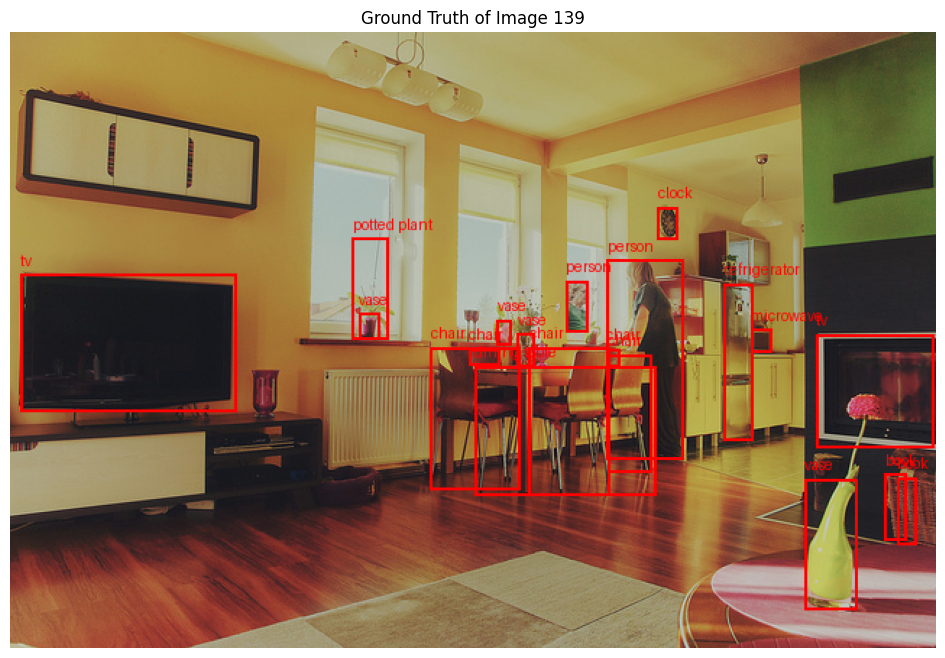

In [11]:
# Visualize first sample
val_image = val_example["image"]
val_image_annotations = val_example["objects"]
print(f"Validation Sample Image Size: {val_image.size}")
print(f"Validation Sample Annotations: {val_image_annotations}")
visualize_sample(val_image, val_image_annotations, title=f"Ground Truth of Image {val_example['image_id']}")


## **4. Split COCO Validation dataset**

### Train and Test Split of COCO Validation dataset

In [12]:
# shaffle dataset for splitting datasets
val_dataset = val_dataset.shuffle(seed=SEED_GLOBAL).shuffle(seed=SEED_GLOBAL).shuffle(seed=SEED_GLOBAL)

# Choose Train and Test smaples from COCO Validation dataset
train_full_dataset = val_dataset.skip(900).take(2100)
test_dataset = val_dataset.take(900)
train_full_count = sum(1 for _ in train_full_dataset)
test_count = sum(1 for _ in test_dataset)
print(f"Train (and validation) dataset size: {train_full_count}")
print(f"Test dataset size: {test_count}")


Train (and validation) dataset size: 2100
Test dataset size: 900


### Train and Test datasets structure

In [13]:
# Train
print("\nTrain dataset structure:")
train_example = next(iter(train_full_dataset.shuffle(seed=SEED_GLOBAL)))
train_image = train_example["image"]
print(f"Original Train Image Size: {train_image.size}")
print("Example keys:", train_example.keys())
print("Type of image:", type(train_example["image"]))
if "objects" in train_example:
    train_objects = train_example["objects"]
    print(f"Train objects structure: {type(train_objects)}")
    print(f"Keys in objects: {list(train_objects.keys())}")
    print(f"bbox_id:{train_objects['bbox_id']}")
    print(f"category:{train_objects['category']}")
    print(f"bbox:{train_objects['bbox']}")
    print(f"area:{train_objects['area']}")

# Test
print("\nTest dataset structure:")
test_dataset = test_dataset
test_example = next(iter(test_dataset))
test_image = test_example["image"]
print(f"Original Validation Image Size: {test_image.size}")
print("Example keys:", test_example.keys())
print("Type of image:", type(test_example["image"]))
if "objects" in test_example:
    test_objects = test_example["objects"]
    print(f"Test objects structure: {type(test_objects)}")
    print(f"Keys in objects: {list(test_objects.keys())}")
    print(f"bbox_id:{test_objects['bbox_id']}")
    print(f"category:{test_objects['category']}")
    print(f"bbox:{test_objects['bbox']}")
    print(f"area:{test_objects['area']}")



Train dataset structure:
Original Train Image Size: (640, 480)
Example keys: dict_keys(['image_id', 'image', 'width', 'height', 'objects'])
Type of image: <class 'PIL.JpegImagePlugin.JpegImageFile'>
Train objects structure: <class 'dict'>
Keys in objects: ['bbox_id', 'category', 'bbox', 'area']
bbox_id:[595780, 596984, 2069400, 2069468]
category:[23, 23, 19, 19]
bbox:[[375.39, 170.24, 457.9, 378.49], [235.19, 142.4, 387.14, 400.63], [453.0, 218.61, 527.4300000000001, 263.73], [90.66, 239.1, 204.57999999999998, 304.46]]
area:[7247.408399999999, 17046.003600000004, 722.3113499999995, 3426.395449999999]

Test dataset structure:
Original Validation Image Size: (640, 427)
Example keys: dict_keys(['image_id', 'image', 'width', 'height', 'objects'])
Type of image: <class 'PIL.JpegImagePlugin.JpegImageFile'>
Test objects structure: <class 'dict'>
Keys in objects: ['bbox_id', 'category', 'bbox', 'area']
bbox_id:[582946, 584399, 585219, 585735, 585822, 585937]
category:[20, 20, 20, 20, 20, 20]


### Visualize Train and Test samples

Train Sample Image Size: (640, 480)
Train Sample Annotations: {'bbox_id': [595780, 596984, 2069400, 2069468], 'category': [23, 23, 19, 19], 'bbox': [[375.39, 170.24, 457.9, 378.49], [235.19, 142.4, 387.14, 400.63], [453.0, 218.61, 527.4300000000001, 263.73], [90.66, 239.1, 204.57999999999998, 304.46]], 'area': [7247.408399999999, 17046.003600000004, 722.3113499999995, 3426.395449999999]}


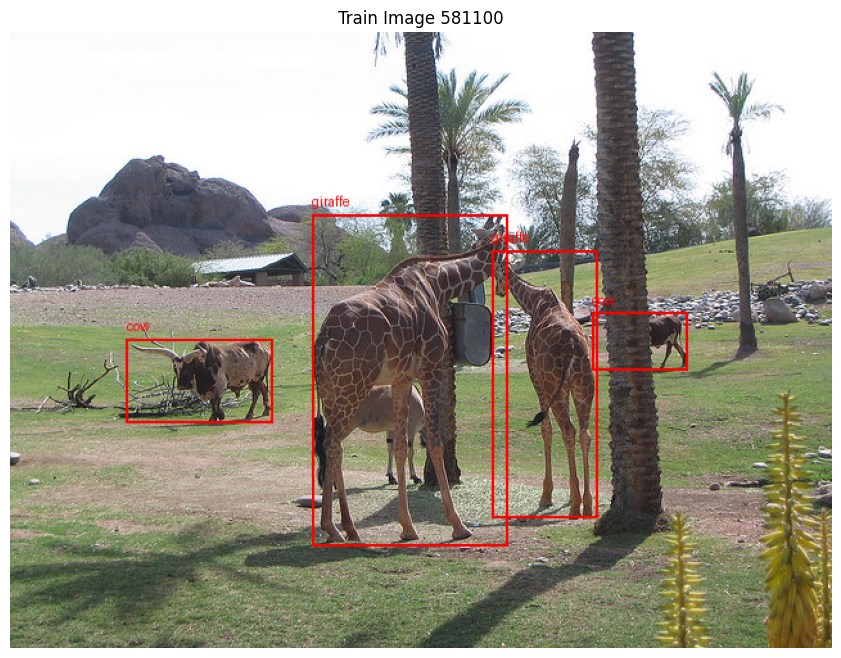

Test Sample Image Size: (640, 427)
Test Sample Annotations: {'bbox_id': [582946, 584399, 585219, 585735, 585822, 585937], 'category': [20, 20, 20, 20, 20, 20], 'bbox': [[161.8, 224.99, 312.11, 420.3], [307.48, 136.63, 568.69, 421.94], [3.8, 36.81, 299.7, 427.0], [260.25, 92.29, 423.14, 330.37], [419.32, 76.76, 640.0, 366.55], [419.59, 39.06, 640.0, 109.75]], 'area': [21142.318399999993, 56080.934049999996, 73129.31629999999, 8668.061650000001, 36205.77155, 4425.403350000001]}


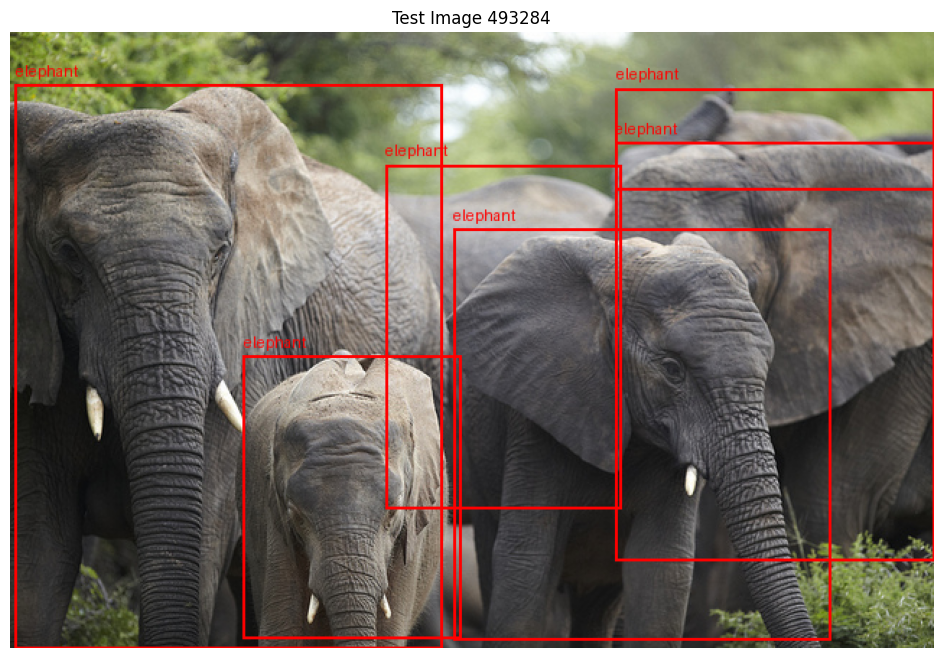

In [14]:
# Train
train_image = train_example["image"]
train_image_annotations = train_example["objects"]
print(f"Train Sample Image Size: {train_image.size}")
print(f"Train Sample Annotations: {train_image_annotations}")
visualize_sample(train_image.copy(), train_image_annotations, title=f"Train Image {train_example['image_id']}")

# Test
test_image = test_example["image"]
test_image_annotations = test_example["objects"]
print(f"Test Sample Image Size: {test_image.size}")
print(f"Test Sample Annotations: {test_image_annotations}")
visualize_sample(test_image.copy(), test_image_annotations, title=f"Test Image {test_example['image_id']}")

### Split Train full dataset into Train and Validation datasets

In [15]:
train_dataset = train_full_dataset.skip(630) # 70% train
train_val_dataset = train_full_dataset.take(630) # 30% validation
train_count = sum(1 for _ in train_dataset)
train_val_count = sum(1 for _ in train_val_dataset)
print(f"Train dataset size: {train_count}  ({int(train_count/train_full_count*100)}% train samples)")
print(f"Validation dataset size: {train_val_count}  ({int(train_val_count/train_full_count*100)}% train samples)")


Train dataset size: 1470  (70% train samples)
Validation dataset size: 630  (30% train samples)


### Ensuring Representation of All Categories

In [16]:
def count_categories(dataset):
    category_counts = defaultdict(int)
    total_images = 0
    for sample in dataset:
        total_images += 1
        categories = sample["objects"]["category"]
        # Ensure each image is counted only once per category
        unique_categories = set(categories)
        for cat in unique_categories:
            category_counts[cat] += 1
    return category_counts, total_images

# Count for train, validation and test sets
train_category_counts, train_total = count_categories(train_dataset)
train_val_category_counts, train_val_total = count_categories(train_val_dataset)
test_category_counts, test_total = count_categories(test_dataset)

# Expected categories from COCO (0-79)
all_categories = set(range(80))

# Find missing categories
missing_train_categories = all_categories - set(train_category_counts.keys())
missing_train_val_categories = all_categories - set(train_val_category_counts.keys())
missing_test_categories = all_categories - set(test_category_counts.keys())

# Category Counts
# Train
print(f"Total Train Images: {train_total}")
print("Train Set Category Distribution:")
for category in sorted(all_categories):
    count = train_category_counts.get(category, 0)
    category_name = coco_categories[category]  # Get category name
    print(f"{category_name} (Category {category}): {count} images")
# Validation
print(f"\nTotal Train-Validation Images: {train_val_total}")
print("Train-Validation Set Category Distribution:")
for category in sorted(all_categories):
    count = train_val_category_counts.get(category, 0)
    category_name = coco_categories[category]  # Get category name
    print(f"{category_name} (Category {category}): {count} images")
# Test
print(f"\nTotal Test Images: {test_total}")
print("Test Set Category Distribution:")
for category in sorted(all_categories):
    count = test_category_counts.get(category, 0)
    category_name = coco_categories[category]  # Get category name
    print(f"{category_name} (Category {category}): {count} images")

# Missing Categories
# Train
if missing_train_categories:
    missing_names = [f"{coco_categories[cat]} ({cat})" for cat in sorted(missing_train_categories)]
    print(f"\nMissing categories in train set: {missing_names}")
else:
    print("\nAll categories are represented in the TRAIN set!")
# Validation
if missing_train_val_categories:
    missing_names = [f"{coco_categories[cat]} ({cat})" for cat in sorted(missing_train_val_categories)]
    print(f"\nMissing categories in validation set: {missing_names}")
else:
    print("\nAll categories are represented in the VALIDATION set!")
# Test
if missing_test_categories:
    missing_names = [f"{coco_categories[cat]} ({cat})" for cat in sorted(missing_test_categories)]
    print(f"\nMissing categories in test set: {missing_names}")
else:
    print("\nAll categories are represented in the TEST set!")

# Shuffle all datasets
train_dataset = train_dataset.shuffle(seed=SEED_GLOBAL)
train_val_dataset = train_val_dataset.shuffle(seed=SEED_GLOBAL)
test_dataset = test_dataset.shuffle(seed=SEED_GLOBAL)


Total Train Images: 1470
Train Set Category Distribution:
person (Category 0): 791 images
bicycle (Category 1): 45 images
car (Category 2): 147 images
motorcycle (Category 3): 42 images
airplane (Category 4): 26 images
bus (Category 5): 47 images
train (Category 6): 50 images
truck (Category 7): 72 images
boat (Category 8): 29 images
traffic light (Category 9): 59 images
fire hydrant (Category 10): 26 images
stop sign (Category 11): 23 images
parking meter (Category 12): 13 images
bench (Category 13): 69 images
bird (Category 14): 39 images
cat (Category 15): 53 images
dog (Category 16): 44 images
horse (Category 17): 44 images
sheep (Category 18): 25 images
cow (Category 19): 33 images
elephant (Category 20): 24 images
bear (Category 21): 17 images
zebra (Category 22): 30 images
giraffe (Category 23): 36 images
backpack (Category 24): 67 images
umbrella (Category 25): 55 images
handbag (Category 26): 80 images
tie (Category 27): 46 images
suitcase (Category 28): 28 images
frisbee (Cat

## **5. mAP Evaluation**

### Visualization Function

In [17]:
def visualize_bounding_boxes(image, results, id2label, title):
    draw = ImageDraw.Draw(image)
    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        box = [round(i, 2) for i in box.tolist()]
        x, y, x2, y2 = tuple(box)
        draw.rectangle((x, y, x2, y2), outline="red", width=2)
        draw.text((x, y), id2label[label.item()], fill="white")
    plt.figure(figsize=(12, 8))
    plt.title(title)
    plt.imshow(image)
    plt.axis("off")
    plt.show()


### Evaluate Model using mAP Function

In [18]:
def evaluate_model(model, processor, data, id2label, confidence_threshold=0.5, iou_threshold=0.5, add_class_metrices=False):
    model.eval()

    # mAP for COCO benchmarks - define IoU thresholds ranging from 0.5 to 0.95
    iou_thresholds_for_mAP = torch.arange(0.5, 1.0, 0.05).tolist()

    if add_class_metrices:
        metric = MeanAveragePrecision(iou_thresholds=iou_thresholds_for_mAP, class_metrics=True)
    else:
        metric = MeanAveragePrecision(iou_thresholds=iou_thresholds_for_mAP)

    results = []
    references = []
    first_image_flag = True

    for sample in tqdm(data):
        idx = sample["image_id"]
        image = sample["image"]
        if image.mode != "RGB": # Convert to RGB (3 channels)
            image = image.convert("RGB")

        inputs = processor(images=image, return_tensors="pt").to(device)

        outputs = model(**inputs) # bboxes and logits
        target_sizes = torch.tensor([image.size[::-1]], device=device)
        processed_outputs = processor.post_process_object_detection(outputs=outputs, target_sizes=target_sizes, threshold=confidence_threshold)[0]

        if first_image_flag:
            for score, label, box in zip(processed_outputs["scores"], processed_outputs["labels"], processed_outputs["boxes"]):
                box = [round(i, 2) for i in box.tolist()]
                print(
                    f"Detected {model.config.id2label[label.item()]} with confidence "
                    f"{round(score.item(), 3)} at location {box}"
                )

        # Extract predictions
        pred_boxes = processed_outputs["boxes"].detach().cpu()
        pred_scores = processed_outputs["scores"].detach().cpu()

        if first_image_flag:
            visualize_bounding_boxes(image.copy(), processed_outputs, id2label, f"YOLOS Predictions for Image {idx}")
            first_image_flag = False

        # Exclude YOLOS null categories
        null_labels_yolos_indexes = {0, 12, 26, 29, 30, 45, 66, 68, 69, 71, 83}
        valid_indices = [
            i for i, label in enumerate(processed_outputs["labels"].detach().cpu())
            if label.item() not in null_labels_yolos_indexes
        ]
        pred_boxes = pred_boxes[valid_indices]
        pred_scores = pred_scores[valid_indices]
        filtered_labels = processed_outputs["labels"].detach().cpu()[valid_indices]

        # Map YOLOS valid labels to COCO
        pred_labels = torch.tensor([yolos_to_coco_mapping[label.item()] for label in filtered_labels])

        # Predictions
        results.append({
            "image_id": sample["image_id"],
            "boxes": pred_boxes,
            "scores": pred_scores,
            "labels": pred_labels
        })

        # Ground Truth
        gt_boxes = torch.tensor(sample["objects"]["bbox"], dtype=torch.float32)
        gt_labels = torch.tensor(sample["objects"]["category"], dtype=torch.int64)
        references.append({
            "image_id": sample["image_id"],
            "annotations": {
                "boxes": gt_boxes,
                "labels": gt_labels
            }
        })

    # Compute metrices
    for result, reference in zip(results, references):
        metric.update(
            preds=[{
                "boxes": result["boxes"],
                "scores": result["scores"],
                "labels": result["labels"]
            }],
            target=[{
                "boxes": reference["annotations"]["boxes"],
                "labels": reference["annotations"]["labels"]
            }]
        )
    metrics = metric.compute()

    # Results
    print("mAP@[0.5:0.95]:", metrics["map"])
    print("Detailed mAP results:", metrics)
    return metrics


### Calculate Baseline score

0it [00:00, ?it/s]

Detected sports ball with confidence 1.0 at location [49.86, 193.77, 188.59, 328.18]
Detected person with confidence 0.871 at location [138.98, 22.27, 462.28, 475.66]
Detected person with confidence 0.998 at location [425.4, 29.42, 618.87, 477.03]
Detected person with confidence 0.998 at location [16.68, 21.42, 461.07, 474.89]


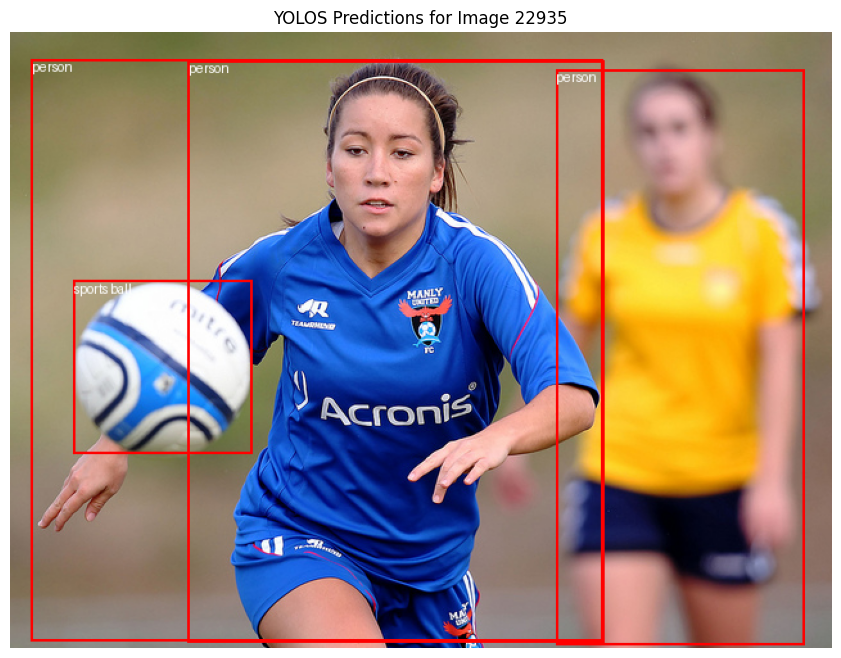

900it [03:34,  4.20it/s]


mAP@[0.5:0.95]: tensor(0.3324)
Detailed mAP results: {'map': tensor(0.3324), 'map_50': tensor(0.5127), 'map_75': tensor(0.3428), 'map_small': tensor(0.0977), 'map_medium': tensor(0.3187), 'map_large': tensor(0.5092), 'mar_1': tensor(0.2832), 'mar_10': tensor(0.4113), 'mar_100': tensor(0.4224), 'mar_small': tensor(0.1505), 'mar_medium': tensor(0.3991), 'mar_large': tensor(0.5929), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Baseline Performance (mAP): tensor(0.3324)
Baseline Performance (mAP):
        map    map_50    map_75  map_small  map_medium  map_large     mar_1  \
0  0.332379

,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.332379,0.512714,0.342762,0.097738,0.318657,0.509172,0.283184,0.411286,0.4224,0.150513,0.399143,0.592925,-1.0,-1.0


In [ ]:
baseline_results = evaluate_model(original_model,processor, test_dataset, yolos_categories)
print("Baseline Performance (mAP):", baseline_results["map"])

baseline_results_dict = {
    key: value.item() if isinstance(value, torch.Tensor) else value
    for key, value in baseline_results.items()
    if key != "classes"
}
baseline_results_df = pd.DataFrame([baseline_results_dict])
print("Baseline Performance (mAP):")
print(baseline_results_df)
display(baseline_results_df)


## **6. Implementing LoRA Variants**


### Inspecting Potential Layers

In [19]:
model = YolosForObjectDetection.from_pretrained(model_name).to(device)
for name, param in model.named_parameters():
    print(name)


vit.embeddings.cls_token
vit.embeddings.detection_tokens
vit.embeddings.position_embeddings
vit.embeddings.patch_embeddings.projection.weight
vit.embeddings.patch_embeddings.projection.bias
vit.encoder.mid_position_embeddings
vit.encoder.layer.0.attention.attention.query.weight
vit.encoder.layer.0.attention.attention.query.bias
vit.encoder.layer.0.attention.attention.key.weight
vit.encoder.layer.0.attention.attention.key.bias
vit.encoder.layer.0.attention.attention.value.weight
vit.encoder.layer.0.attention.attention.value.bias
vit.encoder.layer.0.attention.output.dense.weight
vit.encoder.layer.0.attention.output.dense.bias
vit.encoder.layer.0.intermediate.dense.weight
vit.encoder.layer.0.intermediate.dense.bias
vit.encoder.layer.0.output.dense.weight
vit.encoder.layer.0.output.dense.bias
vit.encoder.layer.0.layernorm_before.weight
vit.encoder.layer.0.layernorm_before.bias
vit.encoder.layer.0.layernorm_after.weight
vit.encoder.layer.0.layernorm_after.bias
vit.encoder.layer.1.attention.

### Define Target Modules

In [20]:
target_modules = [
    f"vit.encoder.layer.{i}.attention.attention.query" for i in range(12)
] + [
    f"vit.encoder.layer.{i}.attention.attention.value" for i in range(12)
]


### Functions for Model Training

In [21]:
class CustomDataset(Dataset):
    def __init__(self, data_list):
        self.data = data_list

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]

# Train
train_dataset_list = list(train_dataset)
train_dataset_fixed = CustomDataset(train_dataset_list)

# Val
train_val_dataset_list = list(train_val_dataset)
train_val_dataset_fixed = CustomDataset(train_val_dataset_list)


In [22]:
def collate_fn(batch):
    images = [sample["image"].convert("RGB") if sample["image"].mode != "RGB" else sample["image"] for sample in batch]

    annotations = []
    for sample in batch:
        image_id = sample["image_id"]

        if "objects" in sample and "category" in sample["objects"] and "bbox" in sample["objects"]:
            formatted_annotations = [
                {
                    "bbox": bbox,
                    "category_id": coco_to_yolos_mapping.get(cat_id, None),  # Map COCO to YOLOS categories
                    "area": area
                }
                for bbox, cat_id, area in zip(sample["objects"]["bbox"], sample["objects"]["category"], sample["objects"]["area"])
                if coco_to_yolos_mapping.get(cat_id, None) is not None  # Exclude invalid categories
            ]
            annotations.append({
                "image_id": image_id,
                "annotations": formatted_annotations
            })
        else:
            annotations.append({"image_id": image_id, "annotations": []})

    # Use processor to handle resizing, padding, and bounding box adaptation
    # from COCO [x_min, y_min, width, hight] to YOLOS [x_center, y_center, width, height]
    inputs = processor(images=images, annotations=annotations, return_tensors="pt")

    # Extract processed images and labels
    processed_images = inputs["pixel_values"]
    labels = inputs["labels"]

    return {"pixel_values": processed_images, "labels": labels}


train_dataloader = DataLoader(train_dataset_fixed, batch_size=4, shuffle=True, collate_fn=collate_fn)
val_dataloader = DataLoader(train_val_dataset_fixed, batch_size=4, shuffle=False, collate_fn=collate_fn)


In [23]:
# Early Stopping - stop training if mAP does not improve
class EarlyStopping:
    def __init__(self, patience=3, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.best_map = -float("inf")
        self.counter = 0

    def __call__(self, current_map):
        if current_map > self.best_map + self.min_delta:
            self.best_map = current_map
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                print("Early stopping triggered - Training Stopped!")
                return True  # sign to stop training
        return False


In [24]:
def focal_loss(logits, targets, alpha=0.25, gamma=2.0, null_labels={0, 12, 26, 29, 30, 45, 66, 68, 69, 71, 83}):
    batch_size, num_queries, num_classes = logits.shape
    device = logits.device
    null_labels_tensor = torch.tensor(list(null_labels), device=device)
    log_probs = F.log_softmax(logits, dim=-1)
    target_tensor = torch.full((batch_size, num_queries), fill_value=-1, dtype=torch.long, device=device) # -1 means ignored label

    for i in range(batch_size):
        if "class_labels" not in targets[i]:
            continue
        labels = targets[i]["class_labels"].to(device)
        valid_labels = labels[~torch.isin(labels, null_labels_tensor)] # Filter out null labels
        num_valid_labels = min(valid_labels.numel(), num_queries)
        target_tensor[i, :num_valid_labels] = valid_labels[:num_valid_labels]

    # Apply mask to ignore invalid labels
    valid_mask = target_tensor != -1
    gathered_log_probs = log_probs[torch.arange(batch_size).unsqueeze(1), torch.arange(num_queries).unsqueeze(0), target_tensor]
    gathered_log_probs = gathered_log_probs * valid_mask

    # Compute focal loss
    pt = gathered_log_probs.exp()
    focal_weight = alpha * (1 - pt) ** gamma
    loss = -focal_weight * gathered_log_probs
    loss = loss.sum() / valid_mask.sum()
    return loss


### Training Function

In [25]:
def train_model(model, processor, train_dataloader, val_dataloader, optimizer, scheduler, early_stopping, device, output_model_path, epochs=5, accumulation_steps=4, is_plateau_scheduler=False):
    model.to(device)
    model.train()

    epochs_list = []
    train_total_losses = []
    val_total_losses = []
    train_focal_losses = []
    train_bbox_losses = []
    train_giou_losses = []
    mAP_scores = []

    best_mAP_score = 0

    for epoch in range(epochs):
        total_loss = 0
        skipped_batches = 0
        epoch_focal_loss = 0
        epoch_bbox_loss = 0
        epoch_giou_loss = 0

        model.train()

        optimizer.zero_grad()

        for batch_idx, batch in enumerate(tqdm(train_dataloader)):
            batch_inputs = batch["pixel_values"].to(device)
            batch_labels = [{k: v.to(device) for k, v in label.items()} for label in batch["labels"]]

            outputs = model(**{"pixel_values": batch_inputs}, labels=batch_labels)

            if outputs.loss is None:
                print(f"No loss for batch {batch_idx}, skipping")
                skipped_batches += 1
                continue

            # Loss components (with focal loss instead of the default-CE)
            loss_focal = focal_loss(outputs.logits, batch_labels)
            loss_bbox = outputs.loss_dict["loss_bbox"]
            loss_giou = outputs.loss_dict["loss_giou"]
            total_loss_batch = 1.5 * loss_focal + 1.0 * loss_bbox + 2.0 * loss_giou

            # Gradient accumulation
            scaled_loss = total_loss_batch / accumulation_steps
            scaled_loss.backward()

            if (batch_idx + 1) % accumulation_steps == 0 or (batch_idx + 1 == len(train_dataloader)):
                optimizer.step()
                optimizer.zero_grad()

            total_loss += total_loss_batch.item()
            epoch_focal_loss += loss_focal.item()
            epoch_bbox_loss += loss_bbox.item()
            epoch_giou_loss += loss_giou.item()

            if batch_idx % 10 == 0:
                print(f"Epoch {epoch + 1}, Batch {batch_idx}: Loss = {scaled_loss.item():.4f}")

            # Clear memory after processing batch
            del batch, batch_inputs, batch_labels, outputs
            torch.cuda.empty_cache()

        # Compute average training losses
        num_batches = len(train_dataloader) - skipped_batches
        avg_train_loss = total_loss / num_batches if num_batches > 0 else 0
        avg_focal_loss = epoch_focal_loss / num_batches if num_batches > 0 else 0
        avg_bbox_loss = epoch_bbox_loss / num_batches if num_batches > 0 else 0
        avg_giou_loss = epoch_giou_loss / num_batches if num_batches > 0 else 0

        print(f"Epoch {epoch + 1} Complete. Average train Loss: {avg_train_loss:.4f}, Skipped Batches: {skipped_batches}")

        # Store losses
        epochs_list.append(epoch + 1)
        train_total_losses.append(avg_train_loss)
        train_focal_losses.append(avg_focal_loss)
        train_bbox_losses.append(avg_bbox_loss)
        train_giou_losses.append(avg_giou_loss)

        # Evaluation on Validation Set
        model.eval()
        total_val_loss = 0
        skipped_val_batches = 0
        with torch.no_grad():
            for val_batch in tqdm(val_dataloader, desc="Validating"):
                val_batch_inputs = val_batch["pixel_values"].to(device)
                val_batch_labels = [{k: v.to(device) for k, v in label.items()} for label in val_batch["labels"]]

                val_outputs = model(**{"pixel_values": val_batch_inputs}, labels=val_batch_labels)

                if val_outputs.loss is None:
                    print(f"No loss for a validation batch, skipping")
                    skipped_val_batches += 1
                    continue

                val_loss_focal = focal_loss(val_outputs.logits, val_batch_labels)
                val_loss_bbox = val_outputs.loss_dict["loss_bbox"]
                val_loss_giou = val_outputs.loss_dict["loss_giou"]
                val_loss_batch = 1.5 * val_loss_focal + 1.0 * val_loss_bbox + 2.0 * val_loss_giou
                total_val_loss += val_loss_batch


        num_val_batches = len(val_dataloader) - skipped_val_batches
        avg_val_loss = total_val_loss / num_val_batches if num_val_batches > 0 else 0
        val_total_losses.append(avg_val_loss)
        print(f"Epoch {epoch+1} - Validation Loss: {avg_val_loss:.4f}")

        # Evaluate mAP on Validation Set
        model_val_results = evaluate_model(model, processor, train_val_dataset_fixed, yolos_categories)
        epoch_val_mAP_score = model_val_results['map'].item()
        print(f"Epoch {epoch+1} - Validation mAP Score: {epoch_val_mAP_score:.4f}")
        mAP_scores.append(epoch_val_mAP_score)

        model_val_results_dict = {key: value.item() if isinstance(value, torch.Tensor) else value
                                  for key, value in model_val_results.items()
                                  if key != "classes"}
        model_val_results_df = pd.DataFrame([model_val_results_dict])
        display(model_val_results_df)

        # Save the best model based on mAP score
        if epoch_val_mAP_score > best_mAP_score:
            best_mAP_score = epoch_val_mAP_score
            torch.save(model, output_model_path)
            print(f"Best model saved with mAP {best_mAP_score:.4f} at epoch {epoch + 1}")

        # Update scheduler based on validation loss
        if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
            scheduler.step(avg_val_loss)
        else:
            scheduler.step()

        # Check if needed to stop training
        if early_stopping(epoch_val_mAP_score):
            break

    return best_mAP_score, epochs_list, train_total_losses, val_total_losses, train_focal_losses, train_bbox_losses, train_giou_losses, mAP_scores



### Evaluate Model Functions

In [26]:
def convert_to_numpy(data):
    if isinstance(data, torch.Tensor):
        return data.cpu().detach().numpy()
    elif isinstance(data, list):
        return [convert_to_numpy(item) for item in data]
    return data

def plot_loss_graphs(epochs_list, train_total_losses, train_focal_losses, train_bbox_losses, train_giou_losses, val_total_losses):
    epochs_list = convert_to_numpy(epochs_list)
    train_total_losses = convert_to_numpy(train_total_losses)
    train_focal_losses = convert_to_numpy(train_focal_losses)
    train_bbox_losses = convert_to_numpy(train_bbox_losses)
    train_giou_losses = convert_to_numpy(train_giou_losses)
    val_total_losses = convert_to_numpy(val_total_losses)

    # Plot 1: Total Training Loss over Epochs
    plt.figure(figsize=(10, 5))
    plt.plot(epochs_list, train_total_losses, label="Train Loss", linestyle="-", marker="o", color="blue")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Train Loss Over Epochs")
    plt.legend()
    plt.grid()
    plt.show()

    # Plot 2: Training Loss Components Over Epochs
    plt.figure(figsize=(8, 6))
    plt.plot(epochs_list, train_focal_losses, label="Train Focal Loss", linestyle="--", marker="x", color="orange")
    plt.plot(epochs_list, train_bbox_losses, label="Train BBox Loss", linestyle="--", marker="s", color="green")
    plt.plot(epochs_list, train_giou_losses, label="Train GIoU Loss", linestyle="--", marker="d", color="red")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Train Loss Components Over Epochs")
    plt.legend()
    plt.grid()
    plt.show()

    # Plot 3: Training and Validation Loss Over Epochs
    plt.figure(figsize=(10, 5))
    plt.plot(epochs_list, train_total_losses, label="Train Loss", linestyle="-", marker="o", color="blue")
    plt.plot(epochs_list, val_total_losses, label="Validation Loss", linestyle="--", marker="x", color="green")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss Over Epochs")
    plt.legend()
    plt.grid()
    plt.show()


###  **(a) LoRA**






#### **LoraConfig**

In [43]:
# Define model for LoRA
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_for_LoRA = YolosForObjectDetection.from_pretrained(model_name).to(device)

# Configure LoRA
lora_config = LoraConfig(
    r=16,
    lora_alpha=8,
    lora_dropout=0.5,
    target_modules=target_modules
)

# Apply LoRA to the model
model_with_LoRA = get_peft_model(model_for_LoRA, lora_config)
model_with_LoRA.print_trainable_parameters()


trainable params: 294,912 || all params: 30,979,680 || trainable%: 0.9520


In [44]:
# Inspect LoRA Layers
for name, param in model_with_LoRA.named_parameters():
    print(f"{name} - requires_grad: {param.requires_grad}")

for name, param in model_with_LoRA.named_parameters():
    if "lora" in name:
        print(name, param.shape)


base_model.model.vit.embeddings.cls_token - requires_grad: False
base_model.model.vit.embeddings.detection_tokens - requires_grad: False
base_model.model.vit.embeddings.position_embeddings - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.weight - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.bias - requires_grad: False
base_model.model.vit.encoder.mid_position_embeddings - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.weight - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.bias - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default.weight - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default.weight - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.key.weight - requires_grad: False
base_model.model.vit.en

In [ ]:
# Mean value of LoRA layers before training
for name, param in model_with_LoRA.named_parameters():
    if "lora" in name:
        print(f"{name} mean before training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default.weight mean before training: -0.000073
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default.weight mean before training: 0.000000
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_A.default.weight mean before training: 0.000168
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_B.default.weight mean before training: 0.000000
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_A.default.weight mean before training: 0.000338
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_B.default.weight mean before training: 0.000000
base_model.model.vit.encoder.layer.1.attention.attention.value.lora_A.default.weight mean before training: 0.000129
base_model.model.vit.encoder.layer.1.attention.attention.value.lora_B.default.weight mean before training: 0.000000
base_model.model.vit.encoder.layer.2.attention.attention.query.lora_A.d

In [45]:
lora_total_parameters = [p for p in model_with_LoRA.parameters()]
print(f"Number of LoRA parameter tensors: {len(lora_total_parameters)}")

lora_parameters = [p for p in model_with_LoRA.parameters() if p.requires_grad]
print(f"Number of LoRA trainable parameter tensors (requires_grad=True): {len(lora_parameters)}")


Number of LoRA parameter tensors: 260
Number of LoRA trainable parameter tensors (requires_grad=True): 48


#### **Train Model with LoRA**

  0%|          | 1/368 [00:03<22:12,  3.63s/it]

Epoch 1, Batch 0: Loss = 1.0439


  3%|▎         | 11/368 [00:38<21:49,  3.67s/it]

Epoch 1, Batch 10: Loss = 1.2853


  6%|▌         | 21/368 [01:11<23:45,  4.11s/it]

Epoch 1, Batch 20: Loss = 0.9438


  8%|▊         | 31/368 [01:56<26:04,  4.64s/it]

Epoch 1, Batch 30: Loss = 0.9441


 11%|█         | 41/368 [02:39<22:41,  4.17s/it]

Epoch 1, Batch 40: Loss = 1.2783


 14%|█▍        | 51/368 [03:22<21:52,  4.14s/it]

Epoch 1, Batch 50: Loss = 1.2128


 17%|█▋        | 61/368 [04:04<20:23,  3.99s/it]

Epoch 1, Batch 60: Loss = 1.1738


 19%|█▉        | 71/368 [04:47<25:47,  5.21s/it]

Epoch 1, Batch 70: Loss = 1.0456


 22%|██▏       | 81/368 [05:25<18:43,  3.91s/it]

Epoch 1, Batch 80: Loss = 1.2817


 25%|██▍       | 91/368 [05:59<15:48,  3.43s/it]

Epoch 1, Batch 90: Loss = 1.1582


 27%|██▋       | 101/368 [06:40<18:35,  4.18s/it]

Epoch 1, Batch 100: Loss = 1.1365


 30%|███       | 111/368 [07:17<14:56,  3.49s/it]

Epoch 1, Batch 110: Loss = 0.6536


 33%|███▎      | 121/368 [08:06<21:01,  5.11s/it]

Epoch 1, Batch 120: Loss = 1.1212


 36%|███▌      | 131/368 [08:47<16:02,  4.06s/it]

Epoch 1, Batch 130: Loss = 0.6558


 38%|███▊      | 141/368 [09:29<17:52,  4.72s/it]

Epoch 1, Batch 140: Loss = 1.2668


 41%|████      | 151/368 [10:07<12:57,  3.59s/it]

Epoch 1, Batch 150: Loss = 1.1283


 44%|████▍     | 161/368 [10:50<15:10,  4.40s/it]

Epoch 1, Batch 160: Loss = 1.0247


 46%|████▋     | 171/368 [11:20<09:41,  2.95s/it]

Epoch 1, Batch 170: Loss = 1.3316


 49%|████▉     | 181/368 [12:03<11:44,  3.77s/it]

Epoch 1, Batch 180: Loss = 0.9413


 52%|█████▏    | 191/368 [12:41<12:15,  4.16s/it]

Epoch 1, Batch 190: Loss = 1.0230


 55%|█████▍    | 201/368 [13:24<13:29,  4.85s/it]

Epoch 1, Batch 200: Loss = 0.9146


 57%|█████▋    | 211/368 [14:05<10:28,  4.00s/it]

Epoch 1, Batch 210: Loss = 1.0592


 60%|██████    | 221/368 [14:44<07:48,  3.19s/it]

Epoch 1, Batch 220: Loss = 1.2660


 63%|██████▎   | 231/368 [15:26<08:52,  3.89s/it]

Epoch 1, Batch 230: Loss = 0.9779


 65%|██████▌   | 241/368 [16:01<08:36,  4.07s/it]

Epoch 1, Batch 240: Loss = 1.1087


 68%|██████▊   | 251/368 [16:41<07:44,  3.97s/it]

Epoch 1, Batch 250: Loss = 0.8739


 71%|███████   | 261/368 [17:22<07:55,  4.44s/it]

Epoch 1, Batch 260: Loss = 1.0697


 74%|███████▎  | 271/368 [18:01<06:45,  4.18s/it]

Epoch 1, Batch 270: Loss = 1.1004


 76%|███████▋  | 281/368 [18:47<05:39,  3.90s/it]

Epoch 1, Batch 280: Loss = 1.4351


 79%|███████▉  | 291/368 [19:19<04:11,  3.27s/it]

Epoch 1, Batch 290: Loss = 0.8354


 82%|████████▏ | 301/368 [20:02<04:26,  3.97s/it]

Epoch 1, Batch 300: Loss = 0.9565


 85%|████████▍ | 311/368 [20:44<04:26,  4.68s/it]

Epoch 1, Batch 310: Loss = 1.0971


 87%|████████▋ | 321/368 [21:32<04:06,  5.24s/it]

Epoch 1, Batch 320: Loss = 1.0111


 90%|████████▉ | 331/368 [22:16<02:27,  3.98s/it]

Epoch 1, Batch 330: Loss = 0.9043


 93%|█████████▎| 341/368 [23:04<02:19,  5.17s/it]

Epoch 1, Batch 340: Loss = 0.9418


 95%|█████████▌| 351/368 [23:42<01:18,  4.63s/it]

Epoch 1, Batch 350: Loss = 1.2409


 98%|█████████▊| 361/368 [24:16<00:23,  3.40s/it]

Epoch 1, Batch 360: Loss = 1.0237


100%|██████████| 368/368 [24:39<00:00,  4.02s/it]


Epoch 1 Complete. Average train Loss: 4.2278, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 1 - Validation Loss: 4.0007


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.942 at location [0.95, 266.42, 323.35, 635.11]
Detected teddy bear with confidence 0.58 at location [303.82, 65.65, 427.69, 413.85]
Detected teddy bear with confidence 0.91 at location [198.31, 220.02, 352.97, 531.08]
Detected teddy bear with confidence 0.684 at location [298.24, 66.84, 427.97, 537.15]
Detected teddy bear with confidence 0.966 at location [109.45, 1.39, 427.56, 534.24]
Detected teddy bear with confidence 0.985 at location [0.04, 54.89, 197.39, 286.43]
Detected teddy bear with confidence 0.62 at location [103.04, 417.49, 321.27, 638.82]


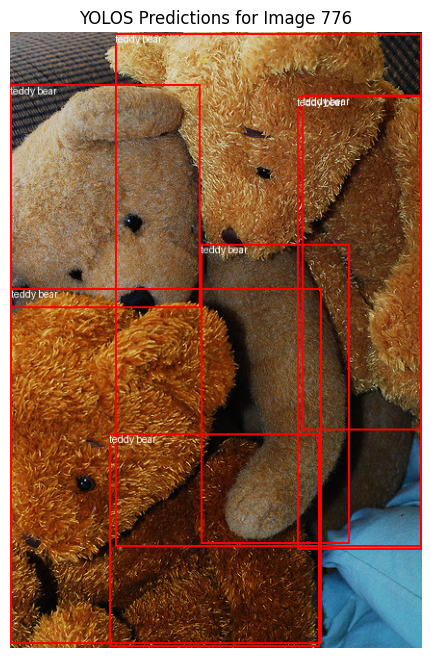

100%|██████████| 630/630 [02:25<00:00,  4.32it/s]


mAP@[0.5:0.95]: tensor(0.3887)
Detailed mAP results: {'map': tensor(0.3887), 'map_50': tensor(0.5648), 'map_75': tensor(0.4179), 'map_small': tensor(0.1302), 'map_medium': tensor(0.3431), 'map_large': tensor(0.5545), 'mar_1': tensor(0.3178), 'mar_10': tensor(0.4626), 'mar_100': tensor(0.4765), 'mar_small': tensor(0.1860), 'mar_medium': tensor(0.4407), 'mar_large': tensor(0.6362), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 1 - Validation mAP Score: 0.3887


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.388673,0.564787,0.417945,0.130238,0.343136,0.554492,0.317847,0.462648,0.476465,0.185994,0.440748,0.636167,-1.0,-1.0


Best model saved with mAP 0.3887 at epoch 1


  0%|          | 1/368 [00:06<38:30,  6.30s/it]

Epoch 2, Batch 0: Loss = 0.7341


  3%|▎         | 11/368 [00:45<23:01,  3.87s/it]

Epoch 2, Batch 10: Loss = 0.9911


  6%|▌         | 21/368 [01:26<20:00,  3.46s/it]

Epoch 2, Batch 20: Loss = 0.9785


  8%|▊         | 31/368 [02:03<19:29,  3.47s/it]

Epoch 2, Batch 30: Loss = 1.0197


 11%|█         | 41/368 [02:48<27:10,  4.99s/it]

Epoch 2, Batch 40: Loss = 1.0391


 14%|█▍        | 51/368 [03:31<20:58,  3.97s/it]

Epoch 2, Batch 50: Loss = 1.0212


 17%|█▋        | 61/368 [04:12<22:53,  4.48s/it]

Epoch 2, Batch 60: Loss = 0.9283


 19%|█▉        | 71/368 [04:57<22:23,  4.52s/it]

Epoch 2, Batch 70: Loss = 1.0187


 22%|██▏       | 81/368 [05:38<17:26,  3.65s/it]

Epoch 2, Batch 80: Loss = 0.9704


 25%|██▍       | 91/368 [06:17<16:33,  3.59s/it]

Epoch 2, Batch 90: Loss = 1.0010


 27%|██▋       | 101/368 [06:56<21:06,  4.74s/it]

Epoch 2, Batch 100: Loss = 0.8641


 30%|███       | 111/368 [07:40<18:14,  4.26s/it]

Epoch 2, Batch 110: Loss = 0.8622


 33%|███▎      | 121/368 [08:20<16:41,  4.05s/it]

Epoch 2, Batch 120: Loss = 1.0101


 36%|███▌      | 131/368 [09:04<15:50,  4.01s/it]

Epoch 2, Batch 130: Loss = 0.9473


 38%|███▊      | 141/368 [09:45<15:22,  4.06s/it]

Epoch 2, Batch 140: Loss = 0.8714


 41%|████      | 151/368 [10:21<14:38,  4.05s/it]

Epoch 2, Batch 150: Loss = 0.8843


 44%|████▍     | 161/368 [11:01<13:23,  3.88s/it]

Epoch 2, Batch 160: Loss = 1.0843


 46%|████▋     | 171/368 [11:38<11:08,  3.39s/it]

Epoch 2, Batch 170: Loss = 1.0746


 49%|████▉     | 181/368 [12:21<14:11,  4.56s/it]

Epoch 2, Batch 180: Loss = 0.9555


 52%|█████▏    | 191/368 [13:07<13:13,  4.48s/it]

Epoch 2, Batch 190: Loss = 0.9588


 55%|█████▍    | 201/368 [13:49<11:37,  4.18s/it]

Epoch 2, Batch 200: Loss = 0.7345


 57%|█████▋    | 211/368 [14:27<10:21,  3.96s/it]

Epoch 2, Batch 210: Loss = 1.0146


 60%|██████    | 221/368 [15:17<12:18,  5.03s/it]

Epoch 2, Batch 220: Loss = 0.9099


 63%|██████▎   | 231/368 [15:56<07:25,  3.25s/it]

Epoch 2, Batch 230: Loss = 0.8645


 65%|██████▌   | 241/368 [16:36<07:27,  3.52s/it]

Epoch 2, Batch 240: Loss = 0.8307


 68%|██████▊   | 251/368 [17:11<07:19,  3.75s/it]

Epoch 2, Batch 250: Loss = 0.9683


 71%|███████   | 261/368 [17:56<08:41,  4.88s/it]

Epoch 2, Batch 260: Loss = 0.7088


 74%|███████▎  | 271/368 [18:36<06:24,  3.96s/it]

Epoch 2, Batch 270: Loss = 0.8607


 76%|███████▋  | 281/368 [19:20<06:44,  4.65s/it]

Epoch 2, Batch 280: Loss = 0.9180


 79%|███████▉  | 291/368 [20:00<04:49,  3.76s/it]

Epoch 2, Batch 290: Loss = 1.0788


 82%|████████▏ | 301/368 [20:40<04:58,  4.46s/it]

Epoch 2, Batch 300: Loss = 0.8330


 85%|████████▍ | 311/368 [21:17<03:06,  3.28s/it]

Epoch 2, Batch 310: Loss = 0.8217


 87%|████████▋ | 321/368 [21:57<02:53,  3.69s/it]

Epoch 2, Batch 320: Loss = 0.8338


 90%|████████▉ | 331/368 [22:35<02:09,  3.49s/it]

Epoch 2, Batch 330: Loss = 0.9615


 93%|█████████▎| 341/368 [23:14<01:54,  4.23s/it]

Epoch 2, Batch 340: Loss = 0.7591


 95%|█████████▌| 351/368 [23:59<01:11,  4.21s/it]

Epoch 2, Batch 350: Loss = 0.8952


 98%|█████████▊| 361/368 [24:38<00:27,  3.90s/it]

Epoch 2, Batch 360: Loss = 0.7096


100%|██████████| 368/368 [25:03<00:00,  4.09s/it]


Epoch 2 Complete. Average train Loss: 3.7213, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 2 - Validation Loss: 3.3858


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.503 at location [348.84, 69.13, 427.75, 425.17]
Detected teddy bear with confidence 0.945 at location [0.89, 265.04, 322.75, 635.43]
Detected teddy bear with confidence 0.785 at location [304.07, 66.49, 427.63, 416.03]
Detected teddy bear with confidence 0.956 at location [200.12, 218.49, 352.2, 532.62]
Detected teddy bear with confidence 0.8 at location [298.85, 67.79, 428.07, 539.71]
Detected teddy bear with confidence 0.959 at location [110.7, 1.32, 427.55, 535.24]
Detected teddy bear with confidence 0.986 at location [-0.14, 55.68, 196.74, 289.43]
Detected teddy bear with confidence 0.767 at location [103.52, 416.14, 321.17, 638.87]


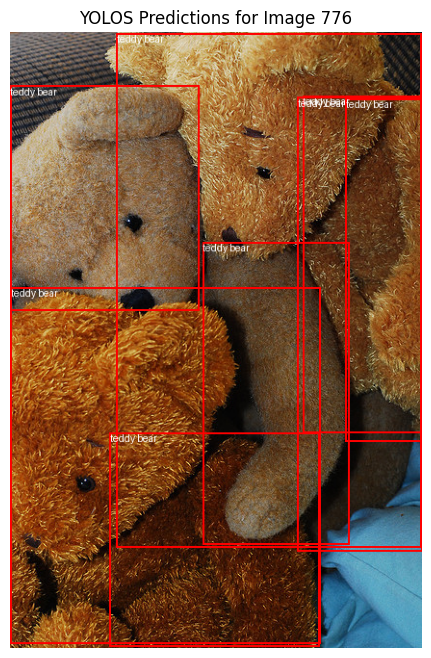

100%|██████████| 630/630 [02:26<00:00,  4.31it/s]


mAP@[0.5:0.95]: tensor(0.3684)
Detailed mAP results: {'map': tensor(0.3684), 'map_50': tensor(0.5487), 'map_75': tensor(0.3946), 'map_small': tensor(0.1081), 'map_medium': tensor(0.3334), 'map_large': tensor(0.5492), 'mar_1': tensor(0.2976), 'mar_10': tensor(0.4532), 'mar_100': tensor(0.4723), 'mar_small': tensor(0.1584), 'mar_medium': tensor(0.4493), 'mar_large': tensor(0.6477), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 2 - Validation mAP Score: 0.3684


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.368444,0.54871,0.3946,0.108052,0.333446,0.549201,0.297627,0.453233,0.472272,0.158374,0.449333,0.647662,-1.0,-1.0


  0%|          | 1/368 [00:02<16:38,  2.72s/it]

Epoch 3, Batch 0: Loss = 0.8450


  3%|▎         | 11/368 [00:47<25:23,  4.27s/it]

Epoch 3, Batch 10: Loss = 0.9828


  6%|▌         | 21/368 [01:31<21:50,  3.78s/it]

Epoch 3, Batch 20: Loss = 0.7294


  8%|▊         | 31/368 [02:18<23:07,  4.12s/it]

Epoch 3, Batch 30: Loss = 0.9022


 11%|█         | 41/368 [02:57<19:09,  3.52s/it]

Epoch 3, Batch 40: Loss = 0.9680


 14%|█▍        | 51/368 [03:30<20:03,  3.80s/it]

Epoch 3, Batch 50: Loss = 0.5573


 17%|█▋        | 61/368 [04:13<21:59,  4.30s/it]

Epoch 3, Batch 60: Loss = 0.6478


 19%|█▉        | 71/368 [04:58<24:22,  4.92s/it]

Epoch 3, Batch 70: Loss = 0.7249


 22%|██▏       | 81/368 [05:40<20:42,  4.33s/it]

Epoch 3, Batch 80: Loss = 0.7921


 25%|██▍       | 91/368 [06:25<21:11,  4.59s/it]

Epoch 3, Batch 90: Loss = 0.9336


 27%|██▋       | 101/368 [07:03<16:31,  3.71s/it]

Epoch 3, Batch 100: Loss = 0.5983


 30%|███       | 111/368 [07:47<18:05,  4.22s/it]

Epoch 3, Batch 110: Loss = 0.5783


 33%|███▎      | 121/368 [08:27<17:05,  4.15s/it]

Epoch 3, Batch 120: Loss = 0.8040


 36%|███▌      | 131/368 [09:04<14:29,  3.67s/it]

Epoch 3, Batch 130: Loss = 0.8711


 38%|███▊      | 141/368 [09:40<12:54,  3.41s/it]

Epoch 3, Batch 140: Loss = 0.7220


 41%|████      | 151/368 [10:18<13:19,  3.69s/it]

Epoch 3, Batch 150: Loss = 0.6397


 44%|████▍     | 161/368 [10:55<11:11,  3.25s/it]

Epoch 3, Batch 160: Loss = 0.8756


 46%|████▋     | 171/368 [11:38<14:29,  4.41s/it]

Epoch 3, Batch 170: Loss = 0.8071


 49%|████▉     | 181/368 [12:18<11:09,  3.58s/it]

Epoch 3, Batch 180: Loss = 0.8326


 52%|█████▏    | 191/368 [13:01<12:32,  4.25s/it]

Epoch 3, Batch 190: Loss = 0.9906


 55%|█████▍    | 201/368 [13:36<09:09,  3.29s/it]

Epoch 3, Batch 200: Loss = 0.9121


 57%|█████▋    | 211/368 [14:16<09:07,  3.49s/it]

Epoch 3, Batch 210: Loss = 0.7708


 60%|██████    | 221/368 [14:49<08:42,  3.55s/it]

Epoch 3, Batch 220: Loss = 0.9073


 63%|██████▎   | 231/368 [15:36<12:02,  5.27s/it]

Epoch 3, Batch 230: Loss = 1.0027


 65%|██████▌   | 241/368 [16:16<08:58,  4.24s/it]

Epoch 3, Batch 240: Loss = 0.6911


 68%|██████▊   | 251/368 [16:58<09:39,  4.95s/it]

Epoch 3, Batch 250: Loss = 0.8136


 71%|███████   | 261/368 [17:37<07:31,  4.22s/it]

Epoch 3, Batch 260: Loss = 0.7739


 74%|███████▎  | 271/368 [18:07<04:48,  2.98s/it]

Epoch 3, Batch 270: Loss = 0.7722


 76%|███████▋  | 281/368 [18:47<06:40,  4.61s/it]

Epoch 3, Batch 280: Loss = 0.6832


 79%|███████▉  | 291/368 [19:29<05:56,  4.63s/it]

Epoch 3, Batch 290: Loss = 0.6984


 82%|████████▏ | 301/368 [20:11<04:11,  3.76s/it]

Epoch 3, Batch 300: Loss = 0.8258


 85%|████████▍ | 311/368 [20:46<03:06,  3.27s/it]

Epoch 3, Batch 310: Loss = 0.7864


 87%|████████▋ | 321/368 [21:27<03:14,  4.14s/it]

Epoch 3, Batch 320: Loss = 0.8081


 90%|████████▉ | 331/368 [22:12<02:40,  4.33s/it]

Epoch 3, Batch 330: Loss = 0.8558


 93%|█████████▎| 341/368 [22:57<01:58,  4.41s/it]

Epoch 3, Batch 340: Loss = 0.7311


 95%|█████████▌| 351/368 [23:41<01:22,  4.86s/it]

Epoch 3, Batch 350: Loss = 0.8388


 98%|█████████▊| 361/368 [24:24<00:32,  4.66s/it]

Epoch 3, Batch 360: Loss = 0.6705


100%|██████████| 368/368 [24:47<00:00,  4.04s/it]


Epoch 3 Complete. Average train Loss: 3.1722, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 3 - Validation Loss: 2.9543


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.521 at location [321.13, 413.47, 427.88, 636.66]
Detected teddy bear with confidence 0.714 at location [349.68, 70.3, 427.74, 426.75]
Detected teddy bear with confidence 0.945 at location [0.86, 263.92, 322.07, 635.72]
Detected teddy bear with confidence 0.511 at location [298.32, 64.8, 427.76, 520.77]
Detected teddy bear with confidence 0.551 at location [21.57, 53.21, 196.65, 296.3]
Detected teddy bear with confidence 0.6 at location [106.02, 405.32, 321.9, 641.1]
Detected teddy bear with confidence 0.863 at location [303.83, 67.15, 427.62, 418.22]
Detected teddy bear with confidence 0.968 at location [201.52, 216.89, 351.87, 534.67]
Detected teddy bear with confidence 0.851 at location [298.87, 68.9, 428.17, 542.35]
Detected teddy bear with confidence 0.948 at location [112.08, 1.23, 427.42, 536.33]
Detected teddy bear with confidence 0.568 at location [91.1, 328.98, 325.59, 637.06]
Detected teddy bear with confidence 0.527 at location [0.28, 26

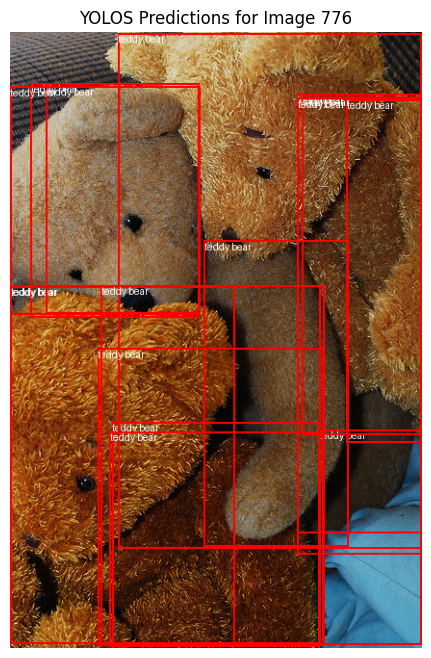

100%|██████████| 630/630 [02:26<00:00,  4.31it/s]


mAP@[0.5:0.95]: tensor(0.3441)
Detailed mAP results: {'map': tensor(0.3441), 'map_50': tensor(0.5307), 'map_75': tensor(0.3608), 'map_small': tensor(0.0789), 'map_medium': tensor(0.3023), 'map_large': tensor(0.5334), 'mar_1': tensor(0.2820), 'mar_10': tensor(0.4365), 'mar_100': tensor(0.4586), 'mar_small': tensor(0.1223), 'mar_medium': tensor(0.4266), 'mar_large': tensor(0.6528), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 3 - Validation mAP Score: 0.3441


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.344133,0.530729,0.360765,0.078909,0.30229,0.533422,0.281995,0.436514,0.458644,0.122265,0.426576,0.652831,-1.0,-1.0


  0%|          | 1/368 [00:03<20:27,  3.34s/it]

Epoch 4, Batch 0: Loss = 0.8416


  3%|▎         | 11/368 [00:40<22:10,  3.73s/it]

Epoch 4, Batch 10: Loss = 0.8237


  6%|▌         | 21/368 [01:19<23:57,  4.14s/it]

Epoch 4, Batch 20: Loss = 0.7683


  8%|▊         | 31/368 [01:56<19:04,  3.40s/it]

Epoch 4, Batch 30: Loss = 0.6905


 11%|█         | 41/368 [02:38<20:14,  3.71s/it]

Epoch 4, Batch 40: Loss = 0.6871


 14%|█▍        | 51/368 [03:20<22:20,  4.23s/it]

Epoch 4, Batch 50: Loss = 0.6143


 17%|█▋        | 61/368 [04:02<20:51,  4.08s/it]

Epoch 4, Batch 60: Loss = 0.6882


 19%|█▉        | 71/368 [04:40<17:20,  3.50s/it]

Epoch 4, Batch 70: Loss = 0.5989


 22%|██▏       | 81/368 [05:23<18:41,  3.91s/it]

Epoch 4, Batch 80: Loss = 0.8718


 25%|██▍       | 91/368 [06:07<19:47,  4.29s/it]

Epoch 4, Batch 90: Loss = 0.7618


 27%|██▋       | 101/368 [06:47<16:28,  3.70s/it]

Epoch 4, Batch 100: Loss = 0.7992


 30%|███       | 111/368 [07:29<20:02,  4.68s/it]

Epoch 4, Batch 110: Loss = 0.6106


 33%|███▎      | 121/368 [08:14<18:38,  4.53s/it]

Epoch 4, Batch 120: Loss = 0.7407


 36%|███▌      | 131/368 [08:50<14:54,  3.77s/it]

Epoch 4, Batch 130: Loss = 0.6550


 38%|███▊      | 141/368 [09:27<15:28,  4.09s/it]

Epoch 4, Batch 140: Loss = 0.6799


 41%|████      | 151/368 [10:01<14:28,  4.00s/it]

Epoch 4, Batch 150: Loss = 0.7478


 44%|████▍     | 161/368 [10:43<15:02,  4.36s/it]

Epoch 4, Batch 160: Loss = 0.7956


 46%|████▋     | 171/368 [11:19<14:14,  4.34s/it]

Epoch 4, Batch 170: Loss = 0.7811


 49%|████▉     | 181/368 [12:05<13:50,  4.44s/it]

Epoch 4, Batch 180: Loss = 0.8432


 52%|█████▏    | 191/368 [12:53<13:55,  4.72s/it]

Epoch 4, Batch 190: Loss = 0.6688


 55%|█████▍    | 201/368 [13:34<11:21,  4.08s/it]

Epoch 4, Batch 200: Loss = 0.8427


 57%|█████▋    | 211/368 [14:16<13:12,  5.05s/it]

Epoch 4, Batch 210: Loss = 0.7859


 60%|██████    | 221/368 [14:56<09:45,  3.98s/it]

Epoch 4, Batch 220: Loss = 0.7450


 63%|██████▎   | 231/368 [15:37<09:05,  3.98s/it]

Epoch 4, Batch 230: Loss = 0.6852


 65%|██████▌   | 241/368 [16:18<08:29,  4.01s/it]

Epoch 4, Batch 240: Loss = 0.6510


 68%|██████▊   | 251/368 [16:59<07:52,  4.04s/it]

Epoch 4, Batch 250: Loss = 0.5912


 71%|███████   | 261/368 [17:34<05:49,  3.27s/it]

Epoch 4, Batch 260: Loss = 0.8474


 74%|███████▎  | 271/368 [18:11<06:58,  4.31s/it]

Epoch 4, Batch 270: Loss = 0.7808


 76%|███████▋  | 281/368 [18:48<04:16,  2.95s/it]

Epoch 4, Batch 280: Loss = 0.7725


 79%|███████▉  | 291/368 [19:34<06:26,  5.02s/it]

Epoch 4, Batch 290: Loss = 0.6366


 82%|████████▏ | 301/368 [20:19<05:19,  4.77s/it]

Epoch 4, Batch 300: Loss = 0.7041


 85%|████████▍ | 311/368 [21:00<03:03,  3.22s/it]

Epoch 4, Batch 310: Loss = 0.7445


 87%|████████▋ | 321/368 [21:44<03:42,  4.73s/it]

Epoch 4, Batch 320: Loss = 0.6204


 90%|████████▉ | 331/368 [22:24<02:38,  4.29s/it]

Epoch 4, Batch 330: Loss = 0.7504


 93%|█████████▎| 341/368 [23:06<02:04,  4.61s/it]

Epoch 4, Batch 340: Loss = 0.8792


 95%|█████████▌| 351/368 [23:44<01:10,  4.14s/it]

Epoch 4, Batch 350: Loss = 0.5819


 98%|█████████▊| 361/368 [24:31<00:34,  4.90s/it]

Epoch 4, Batch 360: Loss = 0.9066


100%|██████████| 368/368 [24:55<00:00,  4.07s/it]


Epoch 4 Complete. Average train Loss: 2.8818, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 4 - Validation Loss: 2.7772


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.576 at location [320.88, 412.33, 427.91, 636.75]
Detected teddy bear with confidence 0.53 at location [301.69, 68.53, 428.41, 551.04]
Detected teddy bear with confidence 0.767 at location [348.85, 70.88, 427.73, 427.87]
Detected teddy bear with confidence 0.511 at location [-0.45, 58.8, 197.47, 366.11]
Detected teddy bear with confidence 0.944 at location [0.87, 263.17, 321.59, 635.84]
Detected teddy bear with confidence 0.569 at location [298.03, 65.83, 427.87, 524.53]
Detected teddy bear with confidence 0.645 at location [21.96, 54.15, 196.26, 298.7]
Detected teddy bear with confidence 0.653 at location [106.01, 404.97, 321.63, 641.03]
Detected teddy bear with confidence 0.875 at location [303.53, 67.34, 427.63, 419.69]
Detected teddy bear with confidence 0.967 at location [202.04, 215.9, 351.92, 536.25]
Detected teddy bear with confidence 0.861 at location [298.64, 69.5, 428.22, 544.26]
Detected teddy bear with confidence 0.917 at location [112.

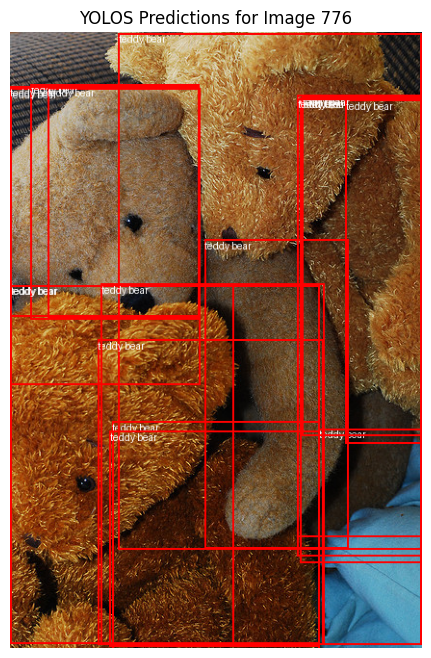

100%|██████████| 630/630 [02:26<00:00,  4.31it/s]


mAP@[0.5:0.95]: tensor(0.3228)
Detailed mAP results: {'map': tensor(0.3228), 'map_50': tensor(0.5019), 'map_75': tensor(0.3355), 'map_small': tensor(0.0608), 'map_medium': tensor(0.2762), 'map_large': tensor(0.5201), 'mar_1': tensor(0.2692), 'mar_10': tensor(0.4184), 'mar_100': tensor(0.4406), 'mar_small': tensor(0.0963), 'mar_medium': tensor(0.4021), 'mar_large': tensor(0.6469), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 4 - Validation mAP Score: 0.3228


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.322758,0.501878,0.335491,0.060791,0.276204,0.520052,0.269198,0.418352,0.440575,0.096349,0.40212,0.646932,-1.0,-1.0


Early stopping triggered - Training Stopped!


In [ ]:
# Train Setting
epochs = 10
optimizer = torch.optim.AdamW(lora_parameters, lr=5e-5, weight_decay=0.01)
scheduler = CosineAnnealingLR(optimizer, T_max=5, eta_min=1e-6)
early_stopping = EarlyStopping(patience=3)

# Train the LoRA model
best_mAP_score_LoRA, epochs_list_LoRA, train_total_losses_LoRA, val_total_losses_LoRA, train_focal_losses_LoRA, train_bbox_losses_LoRA, train_giou_losses_LoRA, mAP_scores_LoRA = train_model(
    model_with_LoRA, processor, train_dataloader, val_dataloader, optimizer, scheduler, early_stopping, device, "lora_model.pth", epochs
)


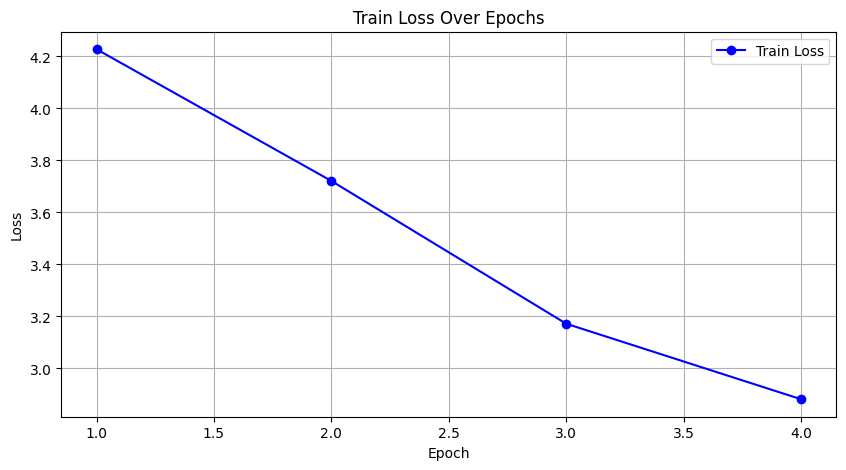

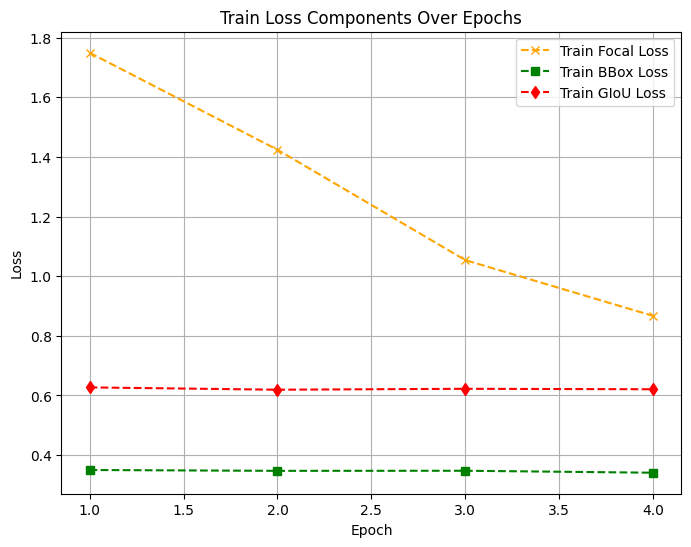

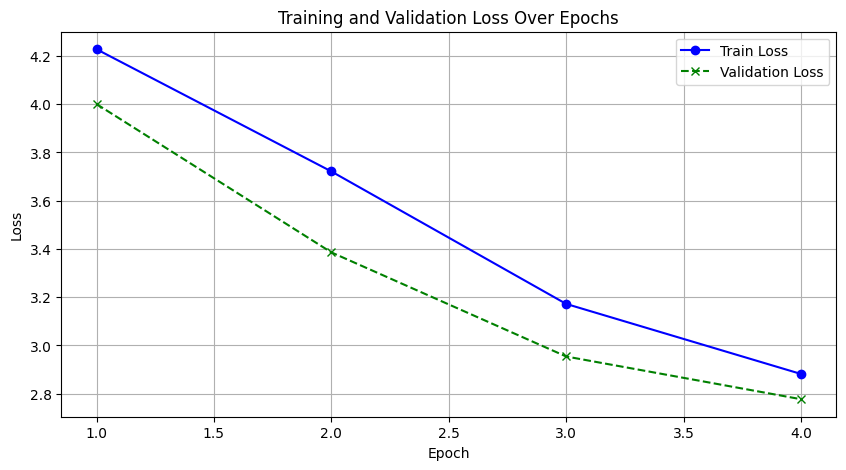

In [ ]:
plot_loss_graphs(epochs_list_LoRA, train_total_losses_LoRA, train_focal_losses_LoRA, train_bbox_losses_LoRA, train_giou_losses_LoRA, val_total_losses_LoRA)


In [ ]:
# Load the saved model with best mAP score
model_with_LoRA = torch.load("lora_model.pth", map_location=torch.device("cuda" if torch.cuda.is_available() else "cpu"))
print(model_with_LoRA.peft_config)

# Check which weights have been updated
for name, param in model_with_LoRA.named_parameters():
    if param.requires_grad:
        print(f"{name} Trainable (Updated)")
    else:
        print(f"{name} Frozen (Original)")

print(model_with_LoRA)


{'default': LoraConfig(task_type=None, peft_type=<PeftType.LORA: 'LORA'>, auto_mapping=None, base_model_name_or_path='hustvl/yolos-small', revision=None, inference_mode=False, r=16, target_modules={'query', 'value'}, exclude_modules=None, lora_alpha=8, lora_dropout=0.5, fan_in_fan_out=False, bias='none', use_rslora=False, modules_to_save=None, init_lora_weights=True, layers_to_transform=None, layers_pattern=None, rank_pattern={}, alpha_pattern={}, megatron_config=None, megatron_core='megatron.core', trainable_token_indices=None, loftq_config={}, eva_config=None, corda_config=None, use_dora=False, layer_replication=None, runtime_config=LoraRuntimeConfig(ephemeral_gpu_offload=False), lora_bias=False)}
base_model.model.vit.embeddings.cls_token Frozen (Original)
base_model.model.vit.embeddings.detection_tokens Frozen (Original)
base_model.model.vit.embeddings.position_embeddings Frozen (Original)
base_model.model.vit.embeddings.patch_embeddings.projection.weight Frozen (Original)
base_mode

<ipython-input-36-7dc6f7b54082>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_with_LoRA = torch.load("lora_model.pth", map_location=torch.device("cuda" if torch.cud

In [ ]:
# Mean value of LoRA layers after training
for name, param in model_with_LoRA.named_parameters():
    if "lora" in name:
        print(f"{name} mean after training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default.weight mean after training: -0.000077
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default.weight mean after training: 0.000008
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_A.default.weight mean after training: 0.000145
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_B.default.weight mean after training: -0.000008
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_A.default.weight mean after training: 0.000336
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_B.default.weight mean after training: -0.000009
base_model.model.vit.encoder.layer.1.attention.attention.value.lora_A.default.weight mean after training: 0.000140
base_model.model.vit.encoder.layer.1.attention.attention.value.lora_B.default.weight mean after training: 0.000035
base_model.model.vit.encoder.layer.2.attention.attention.query.lora_A.default

#### **Evaluate Model with LoRA**

0it [00:00, ?it/s]

Detected sports ball with confidence 1.0 at location [49.81, 193.56, 188.7, 328.92]
Detected person with confidence 0.909 at location [141.77, 22.27, 461.96, 475.78]
Detected person with confidence 0.998 at location [425.66, 29.5, 618.62, 477.16]
Detected person with confidence 0.517 at location [104.24, 21.67, 459.42, 475.69]
Detected person with confidence 0.997 at location [16.72, 21.51, 461.12, 475.09]


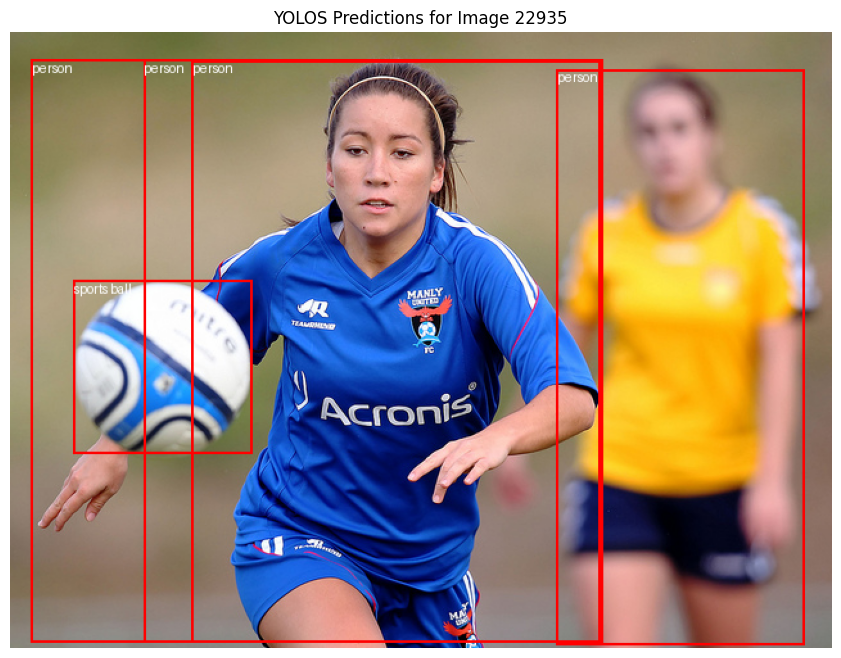

900it [03:43,  4.03it/s]


mAP@[0.5:0.95]: tensor(0.3334)
Detailed mAP results: {'map': tensor(0.3334), 'map_50': tensor(0.5162), 'map_75': tensor(0.3439), 'map_small': tensor(0.0924), 'map_medium': tensor(0.3192), 'map_large': tensor(0.5103), 'mar_1': tensor(0.2853), 'mar_10': tensor(0.4166), 'mar_100': tensor(0.4294), 'mar_small': tensor(0.1507), 'mar_medium': tensor(0.4091), 'mar_large': tensor(0.5996), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Model with LoRA Performance (mAP): tensor(0.3334)
Model with LoRA Performance (mAP):
        map    map_50    map_75  map_small  map_medium  map_large     mar_1 

,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.333389,0.516249,0.343871,0.092381,0.319208,0.51027,0.285329,0.416556,0.429368,0.150678,0.409134,0.599635,-1.0,-1.0


In [ ]:
model_with_LoRA_results = evaluate_model(model_with_LoRA, processor, test_dataset, yolos_categories)
print("Model with LoRA Performance (mAP):", model_with_LoRA_results["map"])

model_with_LoRA_results_dict = {
    key: value.item() if isinstance(value, torch.Tensor) else value
    for key, value in model_with_LoRA_results.items()
    if key != "classes"
}
model_with_LoRA_results_df = pd.DataFrame([model_with_LoRA_results_dict])
print("Model with LoRA Performance (mAP):")
print(model_with_LoRA_results_df)
display(model_with_LoRA_results_df)


### **(b) AdaLoRA- Adaptive LoRA**

#### **AdaLoraConfig**

In [46]:
# Define model for AdaLoRA
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_for_AdaLoRA = YolosForObjectDetection.from_pretrained(model_name).to(device)

# Configure AdaLoRA
adalora_config = AdaLoraConfig(
    target_r=16,
    init_r=24,
    tinit=20,
    tfinal=40,
    total_step=100,
    deltaT=8,
    beta1=0.9,
    beta2=0.88,
    orth_reg_weight=0.01,
    target_modules=target_modules
)

# Apply AdaLoRA to the model
model_with_AdaLoRA = get_peft_model(model_for_AdaLoRA, adalora_config)
model_with_AdaLoRA.print_trainable_parameters()

trainable params: 442,944 || all params: 31,127,736 || trainable%: 1.4230


In [47]:
# Inspect AdaLoRA Layers
for name, param in model_with_AdaLoRA.named_parameters():
    print(f"{name} - requires_grad: {param.requires_grad}")

for name, param in model_with_AdaLoRA.named_parameters():
    if "lora" in name:
        print(name, param.shape)


base_model.model.vit.embeddings.cls_token - requires_grad: False
base_model.model.vit.embeddings.detection_tokens - requires_grad: False
base_model.model.vit.embeddings.position_embeddings - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.weight - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.bias - requires_grad: False
base_model.model.vit.encoder.mid_position_embeddings - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.weight - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.bias - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_E.default - requires_grad: True
base_model.model.vit.encoder

In [48]:
# Mean value of AdaLoRA layers before training
for name, param in model_with_AdaLoRA.named_parameters():
    if "lora" in name:
        print(f"{name} mean before training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default mean before training: 0.000040
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default mean before training: 0.000413
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_E.default mean before training: 0.000000
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_A.default mean before training: 0.000106
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_B.default mean before training: 0.000041
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_E.default mean before training: 0.000000
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_A.default mean before training: 0.000299
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_B.default mean before training: 0.000265
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_E.default mean before training: 0.000000
base_model.model.vi

In [49]:
adalora_total_parameters = [p for p in model_with_AdaLoRA.parameters()]
print(f"Number of AdaLoRA parameter tensors: {len(adalora_total_parameters)}")

adalora_parameters = [p for p in model_with_AdaLoRA.parameters() if p.requires_grad]
print(f"Number of AdaLoRA trainable parameter tensors (requires_grad=True): {len(adalora_parameters)}")


Number of AdaLoRA parameter tensors: 308
Number of AdaLoRA trainable parameter tensors (requires_grad=True): 72


#### **Train Model with AdaLoRA**

  0%|          | 1/368 [00:04<26:35,  4.35s/it]

Epoch 1, Batch 0: Loss = 1.1051


  3%|▎         | 11/368 [00:51<21:15,  3.57s/it]

Epoch 1, Batch 10: Loss = 0.9333


  6%|▌         | 21/368 [01:36<24:28,  4.23s/it]

Epoch 1, Batch 20: Loss = 1.1211


  8%|▊         | 31/368 [02:18<23:45,  4.23s/it]

Epoch 1, Batch 30: Loss = 0.7977


 11%|█         | 41/368 [02:58<20:15,  3.72s/it]

Epoch 1, Batch 40: Loss = 1.0563


 14%|█▍        | 51/368 [03:46<26:09,  4.95s/it]

Epoch 1, Batch 50: Loss = 1.2459


 17%|█▋        | 61/368 [04:23<19:57,  3.90s/it]

Epoch 1, Batch 60: Loss = 1.1973


 19%|█▉        | 71/368 [04:57<14:57,  3.02s/it]

Epoch 1, Batch 70: Loss = 0.8527


 22%|██▏       | 81/368 [05:41<20:18,  4.25s/it]

Epoch 1, Batch 80: Loss = 0.9604


 25%|██▍       | 91/368 [06:22<18:29,  4.01s/it]

Epoch 1, Batch 90: Loss = 1.1436


 27%|██▋       | 101/368 [07:02<15:49,  3.56s/it]

Epoch 1, Batch 100: Loss = 0.9613


 30%|███       | 111/368 [07:33<12:53,  3.01s/it]

Epoch 1, Batch 110: Loss = 1.0824


 33%|███▎      | 121/368 [08:13<14:48,  3.60s/it]

Epoch 1, Batch 120: Loss = 1.0394


 36%|███▌      | 131/368 [08:50<13:46,  3.49s/it]

Epoch 1, Batch 130: Loss = 0.9621


 38%|███▊      | 141/368 [09:31<13:08,  3.47s/it]

Epoch 1, Batch 140: Loss = 1.1028


 41%|████      | 151/368 [10:12<17:14,  4.77s/it]

Epoch 1, Batch 150: Loss = 1.1063


 44%|████▍     | 161/368 [10:52<14:37,  4.24s/it]

Epoch 1, Batch 160: Loss = 1.0543


 46%|████▋     | 171/368 [11:33<14:31,  4.42s/it]

Epoch 1, Batch 170: Loss = 1.2512


 49%|████▉     | 181/368 [12:16<15:27,  4.96s/it]

Epoch 1, Batch 180: Loss = 1.1451


 52%|█████▏    | 191/368 [12:57<11:58,  4.06s/it]

Epoch 1, Batch 190: Loss = 0.9523


 55%|█████▍    | 201/368 [13:37<12:02,  4.33s/it]

Epoch 1, Batch 200: Loss = 1.0353


 57%|█████▋    | 211/368 [14:15<11:13,  4.29s/it]

Epoch 1, Batch 210: Loss = 1.2636


 60%|██████    | 221/368 [14:50<09:05,  3.71s/it]

Epoch 1, Batch 220: Loss = 1.1208


 63%|██████▎   | 231/368 [15:24<06:53,  3.02s/it]

Epoch 1, Batch 230: Loss = 0.7972


 65%|██████▌   | 241/368 [16:05<08:52,  4.19s/it]

Epoch 1, Batch 240: Loss = 1.0415


 68%|██████▊   | 251/368 [16:36<06:41,  3.43s/it]

Epoch 1, Batch 250: Loss = 1.4278


 71%|███████   | 261/368 [17:15<05:40,  3.18s/it]

Epoch 1, Batch 260: Loss = 1.2548


 74%|███████▎  | 271/368 [17:55<06:53,  4.26s/it]

Epoch 1, Batch 270: Loss = 0.9802


 76%|███████▋  | 281/368 [18:34<05:34,  3.85s/it]

Epoch 1, Batch 280: Loss = 1.1039


 79%|███████▉  | 291/368 [19:15<04:47,  3.73s/it]

Epoch 1, Batch 290: Loss = 1.0527


 82%|████████▏ | 301/368 [19:49<03:24,  3.06s/it]

Epoch 1, Batch 300: Loss = 1.1613


 85%|████████▍ | 311/368 [20:26<03:02,  3.20s/it]

Epoch 1, Batch 310: Loss = 1.0076


 87%|████████▋ | 321/368 [21:07<02:39,  3.40s/it]

Epoch 1, Batch 320: Loss = 1.0989


 90%|████████▉ | 331/368 [21:53<02:49,  4.58s/it]

Epoch 1, Batch 330: Loss = 1.0193


 93%|█████████▎| 341/368 [22:37<02:16,  5.06s/it]

Epoch 1, Batch 340: Loss = 1.0273


 95%|█████████▌| 351/368 [23:23<01:28,  5.21s/it]

Epoch 1, Batch 350: Loss = 0.9564


 98%|█████████▊| 361/368 [24:17<00:37,  5.37s/it]

Epoch 1, Batch 360: Loss = 1.1125


100%|██████████| 368/368 [24:44<00:00,  4.04s/it]


Epoch 1 Complete. Average train Loss: 4.2885, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:57<00:00,  1.12s/it]


Epoch 1 - Validation Loss: 4.2822


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.937 at location [0.99, 266.95, 323.42, 634.96]
Detected teddy bear with confidence 0.855 at location [197.56, 220.45, 353.2, 530.64]
Detected teddy bear with confidence 0.616 at location [297.8, 66.58, 427.94, 536.47]
Detected teddy bear with confidence 0.967 at location [108.95, 1.44, 427.56, 533.97]
Detected teddy bear with confidence 0.984 at location [0.11, 54.64, 197.81, 285.66]
Detected teddy bear with confidence 0.519 at location [102.89, 417.84, 321.23, 638.76]


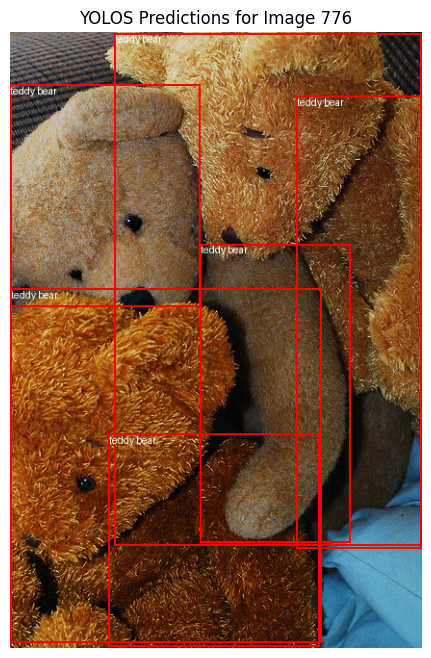

100%|██████████| 630/630 [02:27<00:00,  4.28it/s]


mAP@[0.5:0.95]: tensor(0.3830)
Detailed mAP results: {'map': tensor(0.3830), 'map_50': tensor(0.5580), 'map_75': tensor(0.4093), 'map_small': tensor(0.1198), 'map_medium': tensor(0.3409), 'map_large': tensor(0.5479), 'mar_1': tensor(0.3156), 'mar_10': tensor(0.4539), 'mar_100': tensor(0.4648), 'mar_small': tensor(0.1611), 'mar_medium': tensor(0.4263), 'mar_large': tensor(0.6236), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 1 - Validation mAP Score: 0.3830


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.383014,0.55796,0.409292,0.119819,0.340873,0.547895,0.315577,0.453865,0.464784,0.16106,0.42633,0.623616,-1.0,-1.0


Best model saved with mAP 0.3830 at epoch 1


  0%|          | 1/368 [00:04<27:28,  4.49s/it]

Epoch 2, Batch 0: Loss = 1.0414


  3%|▎         | 11/368 [00:45<25:21,  4.26s/it]

Epoch 2, Batch 10: Loss = 0.7933


  6%|▌         | 21/368 [01:29<26:40,  4.61s/it]

Epoch 2, Batch 20: Loss = 1.0699


  8%|▊         | 31/368 [02:09<20:41,  3.68s/it]

Epoch 2, Batch 30: Loss = 1.0001


 11%|█         | 41/368 [02:51<26:02,  4.78s/it]

Epoch 2, Batch 40: Loss = 0.9508


 14%|█▍        | 51/368 [03:34<22:59,  4.35s/it]

Epoch 2, Batch 50: Loss = 1.0143


 17%|█▋        | 61/368 [04:14<18:59,  3.71s/it]

Epoch 2, Batch 60: Loss = 0.9782


 19%|█▉        | 71/368 [05:02<22:27,  4.54s/it]

Epoch 2, Batch 70: Loss = 1.0547


 22%|██▏       | 81/368 [05:41<18:22,  3.84s/it]

Epoch 2, Batch 80: Loss = 1.2429


 25%|██▍       | 91/368 [06:25<19:28,  4.22s/it]

Epoch 2, Batch 90: Loss = 1.0662


 27%|██▋       | 101/368 [07:04<16:49,  3.78s/it]

Epoch 2, Batch 100: Loss = 1.0678


 30%|███       | 111/368 [07:41<16:12,  3.78s/it]

Epoch 2, Batch 110: Loss = 1.3777


 33%|███▎      | 121/368 [08:17<14:06,  3.43s/it]

Epoch 2, Batch 120: Loss = 0.9422


 36%|███▌      | 131/368 [08:57<17:26,  4.41s/it]

Epoch 2, Batch 130: Loss = 0.7668


 38%|███▊      | 141/368 [09:40<16:16,  4.30s/it]

Epoch 2, Batch 140: Loss = 1.1154


 41%|████      | 151/368 [10:24<14:12,  3.93s/it]

Epoch 2, Batch 150: Loss = 1.0780


 44%|████▍     | 161/368 [11:07<14:42,  4.26s/it]

Epoch 2, Batch 160: Loss = 0.9543


 46%|████▋     | 171/368 [11:51<13:27,  4.10s/it]

Epoch 2, Batch 170: Loss = 1.2978


 49%|████▉     | 181/368 [12:25<10:50,  3.48s/it]

Epoch 2, Batch 180: Loss = 1.2779


 52%|█████▏    | 191/368 [13:03<10:27,  3.55s/it]

Epoch 2, Batch 190: Loss = 1.3945


 55%|█████▍    | 201/368 [13:45<10:57,  3.94s/it]

Epoch 2, Batch 200: Loss = 1.0558


 57%|█████▋    | 211/368 [14:24<11:35,  4.43s/it]

Epoch 2, Batch 210: Loss = 1.2313


 60%|██████    | 221/368 [15:05<10:26,  4.26s/it]

Epoch 2, Batch 220: Loss = 1.3258


 63%|██████▎   | 231/368 [15:39<08:21,  3.66s/it]

Epoch 2, Batch 230: Loss = 1.1217


 65%|██████▌   | 241/368 [16:20<07:53,  3.73s/it]

Epoch 2, Batch 240: Loss = 0.9965


 68%|██████▊   | 251/368 [17:02<08:48,  4.52s/it]

Epoch 2, Batch 250: Loss = 1.0260


 71%|███████   | 261/368 [17:41<06:33,  3.68s/it]

Epoch 2, Batch 260: Loss = 1.3764


 74%|███████▎  | 271/368 [18:19<05:26,  3.37s/it]

Epoch 2, Batch 270: Loss = 1.1334


 76%|███████▋  | 281/368 [19:05<06:18,  4.35s/it]

Epoch 2, Batch 280: Loss = 1.0737


 79%|███████▉  | 291/368 [19:42<04:16,  3.33s/it]

Epoch 2, Batch 290: Loss = 1.1803


 82%|████████▏ | 301/368 [20:25<05:16,  4.73s/it]

Epoch 2, Batch 300: Loss = 1.0637


 85%|████████▍ | 311/368 [20:58<03:37,  3.81s/it]

Epoch 2, Batch 310: Loss = 0.8918


 87%|████████▋ | 321/368 [21:41<03:30,  4.48s/it]

Epoch 2, Batch 320: Loss = 1.3186


 90%|████████▉ | 331/368 [22:14<01:53,  3.07s/it]

Epoch 2, Batch 330: Loss = 1.0247


 93%|█████████▎| 341/368 [22:55<01:57,  4.37s/it]

Epoch 2, Batch 340: Loss = 1.1579


 95%|█████████▌| 351/368 [23:40<01:22,  4.86s/it]

Epoch 2, Batch 350: Loss = 1.2330


 98%|█████████▊| 361/368 [24:17<00:22,  3.25s/it]

Epoch 2, Batch 360: Loss = 1.4797


100%|██████████| 368/368 [24:44<00:00,  4.03s/it]


Epoch 2 Complete. Average train Loss: 4.3183, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:58<00:00,  1.13s/it]


Epoch 2 - Validation Loss: 4.2783


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.937 at location [0.99, 266.94, 323.42, 634.96]
Detected teddy bear with confidence 0.856 at location [197.57, 220.45, 353.2, 530.64]
Detected teddy bear with confidence 0.617 at location [297.8, 66.59, 427.94, 536.48]
Detected teddy bear with confidence 0.967 at location [108.95, 1.44, 427.56, 533.97]
Detected teddy bear with confidence 0.984 at location [0.11, 54.65, 197.81, 285.67]
Detected teddy bear with confidence 0.521 at location [102.89, 417.83, 321.24, 638.76]


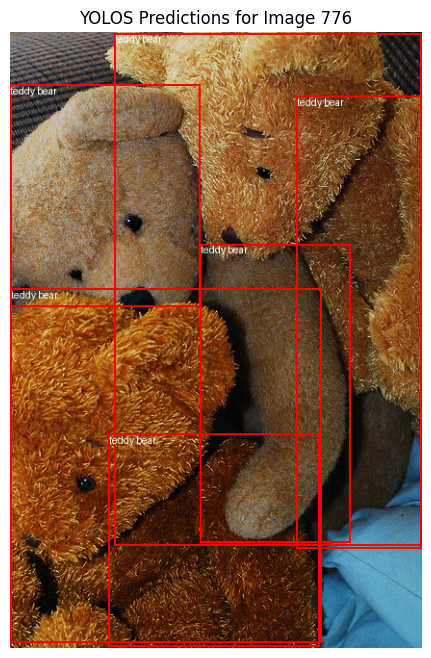

100%|██████████| 630/630 [02:27<00:00,  4.28it/s]


mAP@[0.5:0.95]: tensor(0.3832)
Detailed mAP results: {'map': tensor(0.3832), 'map_50': tensor(0.5583), 'map_75': tensor(0.4094), 'map_small': tensor(0.1199), 'map_medium': tensor(0.3412), 'map_large': tensor(0.5479), 'mar_1': tensor(0.3156), 'mar_10': tensor(0.4542), 'mar_100': tensor(0.4650), 'mar_small': tensor(0.1612), 'mar_medium': tensor(0.4273), 'mar_large': tensor(0.6236), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 2 - Validation mAP Score: 0.3832


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.383181,0.558277,0.409402,0.119878,0.341191,0.54792,0.315569,0.454166,0.465006,0.161155,0.427349,0.623618,-1.0,-1.0


Best model saved with mAP 0.3832 at epoch 2


  0%|          | 1/368 [00:05<32:30,  5.32s/it]

Epoch 3, Batch 0: Loss = 0.9825


  3%|▎         | 11/368 [00:51<27:34,  4.63s/it]

Epoch 3, Batch 10: Loss = 1.2436


  6%|▌         | 21/368 [01:34<23:29,  4.06s/it]

Epoch 3, Batch 20: Loss = 1.0859


  8%|▊         | 31/368 [02:19<26:25,  4.70s/it]

Epoch 3, Batch 30: Loss = 0.9769


 11%|█         | 41/368 [02:59<21:53,  4.02s/it]

Epoch 3, Batch 40: Loss = 1.0301


 14%|█▍        | 51/368 [03:40<24:25,  4.62s/it]

Epoch 3, Batch 50: Loss = 1.2932


 17%|█▋        | 61/368 [04:18<19:23,  3.79s/it]

Epoch 3, Batch 60: Loss = 1.0411


 19%|█▉        | 71/368 [05:02<22:28,  4.54s/it]

Epoch 3, Batch 70: Loss = 1.1851


 22%|██▏       | 81/368 [05:47<20:03,  4.19s/it]

Epoch 3, Batch 80: Loss = 0.9538


 25%|██▍       | 91/368 [06:22<17:50,  3.86s/it]

Epoch 3, Batch 90: Loss = 1.2008


 27%|██▋       | 101/368 [07:01<17:55,  4.03s/it]

Epoch 3, Batch 100: Loss = 1.0946


 30%|███       | 111/368 [07:36<14:13,  3.32s/it]

Epoch 3, Batch 110: Loss = 0.9133


 33%|███▎      | 121/368 [08:12<16:36,  4.03s/it]

Epoch 3, Batch 120: Loss = 1.2722


 36%|███▌      | 131/368 [08:48<14:00,  3.55s/it]

Epoch 3, Batch 130: Loss = 1.0794


 38%|███▊      | 141/368 [09:36<16:08,  4.27s/it]

Epoch 3, Batch 140: Loss = 1.0575


 41%|████      | 151/368 [10:17<14:42,  4.07s/it]

Epoch 3, Batch 150: Loss = 0.8325


 44%|████▍     | 161/368 [10:54<12:58,  3.76s/it]

Epoch 3, Batch 160: Loss = 0.9416


 46%|████▋     | 171/368 [11:30<13:16,  4.05s/it]

Epoch 3, Batch 170: Loss = 0.9415


 49%|████▉     | 181/368 [12:05<08:49,  2.83s/it]

Epoch 3, Batch 180: Loss = 1.1910


 52%|█████▏    | 191/368 [12:53<13:57,  4.73s/it]

Epoch 3, Batch 190: Loss = 1.2354


 55%|█████▍    | 201/368 [13:33<11:51,  4.26s/it]

Epoch 3, Batch 200: Loss = 1.1118


 57%|█████▋    | 211/368 [14:09<10:22,  3.97s/it]

Epoch 3, Batch 210: Loss = 1.1379


 60%|██████    | 221/368 [14:47<08:45,  3.57s/it]

Epoch 3, Batch 220: Loss = 1.2037


 63%|██████▎   | 231/368 [15:27<09:01,  3.95s/it]

Epoch 3, Batch 230: Loss = 1.0307


 65%|██████▌   | 241/368 [16:08<07:59,  3.78s/it]

Epoch 3, Batch 240: Loss = 1.1189


 68%|██████▊   | 251/368 [16:48<07:57,  4.08s/it]

Epoch 3, Batch 250: Loss = 1.2014


 71%|███████   | 261/368 [17:27<06:38,  3.73s/it]

Epoch 3, Batch 260: Loss = 1.1105


 74%|███████▎  | 271/368 [18:09<05:57,  3.69s/it]

Epoch 3, Batch 270: Loss = 1.0969


 76%|███████▋  | 281/368 [18:51<05:10,  3.57s/it]

Epoch 3, Batch 280: Loss = 1.0042


 79%|███████▉  | 291/368 [19:30<05:51,  4.57s/it]

Epoch 3, Batch 290: Loss = 1.1781


 82%|████████▏ | 301/368 [20:11<04:36,  4.13s/it]

Epoch 3, Batch 300: Loss = 0.7758


 85%|████████▍ | 311/368 [20:55<04:02,  4.25s/it]

Epoch 3, Batch 310: Loss = 1.1714


 87%|████████▋ | 321/368 [21:39<03:40,  4.69s/it]

Epoch 3, Batch 320: Loss = 1.4351


 90%|████████▉ | 331/368 [22:27<02:39,  4.32s/it]

Epoch 3, Batch 330: Loss = 1.0148


 93%|█████████▎| 341/368 [23:15<02:11,  4.88s/it]

Epoch 3, Batch 340: Loss = 1.3762


 95%|█████████▌| 351/368 [24:00<01:13,  4.34s/it]

Epoch 3, Batch 350: Loss = 0.9334


 98%|█████████▊| 361/368 [24:37<00:27,  3.88s/it]

Epoch 3, Batch 360: Loss = 1.2305


100%|██████████| 368/368 [25:00<00:00,  4.08s/it]


Epoch 3 Complete. Average train Loss: 4.3190, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:57<00:00,  1.13s/it]


Epoch 3 - Validation Loss: 4.2649


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.937 at location [0.99, 266.92, 323.41, 634.96]
Detected teddy bear with confidence 0.859 at location [197.58, 220.43, 353.19, 530.65]
Detected teddy bear with confidence 0.62 at location [297.8, 66.62, 427.94, 536.49]
Detected teddy bear with confidence 0.967 at location [108.96, 1.44, 427.56, 533.97]
Detected teddy bear with confidence 0.984 at location [0.1, 54.67, 197.81, 285.7]
Detected teddy bear with confidence 0.525 at location [102.88, 417.81, 321.24, 638.76]


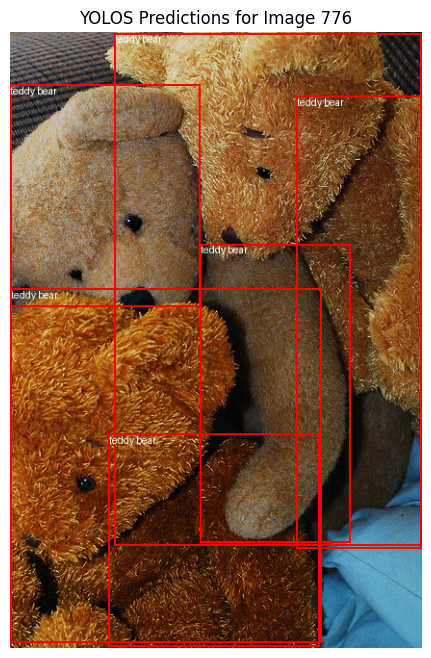

100%|██████████| 630/630 [02:26<00:00,  4.29it/s]


mAP@[0.5:0.95]: tensor(0.3836)
Detailed mAP results: {'map': tensor(0.3836), 'map_50': tensor(0.5588), 'map_75': tensor(0.4095), 'map_small': tensor(0.1200), 'map_medium': tensor(0.3416), 'map_large': tensor(0.5481), 'mar_1': tensor(0.3157), 'mar_10': tensor(0.4548), 'mar_100': tensor(0.4658), 'mar_small': tensor(0.1619), 'mar_medium': tensor(0.4280), 'mar_large': tensor(0.6242), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 3 - Validation mAP Score: 0.3836


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.38359,0.55876,0.409504,0.11995,0.34156,0.548102,0.315676,0.454825,0.465763,0.161933,0.427982,0.624207,-1.0,-1.0


Best model saved with mAP 0.3836 at epoch 3


  0%|          | 1/368 [00:02<13:07,  2.15s/it]

Epoch 4, Batch 0: Loss = 1.0152


  3%|▎         | 11/368 [00:41<24:21,  4.09s/it]

Epoch 4, Batch 10: Loss = 0.9279


  6%|▌         | 21/368 [01:18<20:00,  3.46s/it]

Epoch 4, Batch 20: Loss = 1.1896


  8%|▊         | 31/368 [02:04<24:45,  4.41s/it]

Epoch 4, Batch 30: Loss = 1.3441


 11%|█         | 41/368 [02:49<23:55,  4.39s/it]

Epoch 4, Batch 40: Loss = 1.0380


 14%|█▍        | 51/368 [03:29<18:25,  3.49s/it]

Epoch 4, Batch 50: Loss = 1.2737


 17%|█▋        | 61/368 [04:07<21:41,  4.24s/it]

Epoch 4, Batch 60: Loss = 1.0260


 19%|█▉        | 71/368 [04:44<19:52,  4.02s/it]

Epoch 4, Batch 70: Loss = 0.9946


 22%|██▏       | 81/368 [05:28<22:22,  4.68s/it]

Epoch 4, Batch 80: Loss = 0.8463


 25%|██▍       | 91/368 [06:07<17:20,  3.76s/it]

Epoch 4, Batch 90: Loss = 1.1635


 27%|██▋       | 101/368 [06:53<19:27,  4.37s/it]

Epoch 4, Batch 100: Loss = 0.9511


 30%|███       | 111/368 [07:37<21:45,  5.08s/it]

Epoch 4, Batch 110: Loss = 0.9507


 33%|███▎      | 121/368 [08:20<17:11,  4.18s/it]

Epoch 4, Batch 120: Loss = 1.1613


 36%|███▌      | 131/368 [09:00<16:03,  4.07s/it]

Epoch 4, Batch 130: Loss = 0.8382


 38%|███▊      | 141/368 [09:41<16:25,  4.34s/it]

Epoch 4, Batch 140: Loss = 1.1274


 41%|████      | 151/368 [10:28<18:44,  5.18s/it]

Epoch 4, Batch 150: Loss = 0.7218


 44%|████▍     | 161/368 [11:04<13:36,  3.94s/it]

Epoch 4, Batch 160: Loss = 1.1203


 46%|████▋     | 171/368 [11:48<12:28,  3.80s/it]

Epoch 4, Batch 170: Loss = 1.0276


 49%|████▉     | 181/368 [12:22<10:18,  3.31s/it]

Epoch 4, Batch 180: Loss = 1.0374


 52%|█████▏    | 191/368 [13:05<10:48,  3.67s/it]

Epoch 4, Batch 190: Loss = 0.7739


 55%|█████▍    | 201/368 [13:40<09:14,  3.32s/it]

Epoch 4, Batch 200: Loss = 1.2292


 57%|█████▋    | 211/368 [14:20<10:25,  3.99s/it]

Epoch 4, Batch 210: Loss = 1.0878


 60%|██████    | 221/368 [14:58<10:06,  4.13s/it]

Epoch 4, Batch 220: Loss = 1.1771


 63%|██████▎   | 231/368 [15:44<11:01,  4.83s/it]

Epoch 4, Batch 230: Loss = 1.2139


 65%|██████▌   | 241/368 [16:21<07:53,  3.73s/it]

Epoch 4, Batch 240: Loss = 1.2571


 68%|██████▊   | 251/368 [17:02<08:29,  4.35s/it]

Epoch 4, Batch 250: Loss = 1.0801


 71%|███████   | 261/368 [17:46<07:09,  4.02s/it]

Epoch 4, Batch 260: Loss = 0.7732


 74%|███████▎  | 271/368 [18:23<05:35,  3.46s/it]

Epoch 4, Batch 270: Loss = 1.2316


 76%|███████▋  | 281/368 [19:06<06:24,  4.42s/it]

Epoch 4, Batch 280: Loss = 1.4122


 79%|███████▉  | 291/368 [19:42<04:09,  3.24s/it]

Epoch 4, Batch 290: Loss = 1.0037


 82%|████████▏ | 301/368 [20:28<04:48,  4.31s/it]

Epoch 4, Batch 300: Loss = 0.7811


 85%|████████▍ | 311/368 [21:06<04:01,  4.24s/it]

Epoch 4, Batch 310: Loss = 0.9740


 87%|████████▋ | 321/368 [21:50<03:12,  4.09s/it]

Epoch 4, Batch 320: Loss = 1.0944


 90%|████████▉ | 331/368 [22:30<02:21,  3.83s/it]

Epoch 4, Batch 330: Loss = 0.8419


 93%|█████████▎| 341/368 [23:13<01:57,  4.34s/it]

Epoch 4, Batch 340: Loss = 1.1922


 95%|█████████▌| 351/368 [23:52<00:59,  3.49s/it]

Epoch 4, Batch 350: Loss = 0.8887


 98%|█████████▊| 361/368 [24:34<00:31,  4.57s/it]

Epoch 4, Batch 360: Loss = 0.9797


100%|██████████| 368/368 [24:57<00:00,  4.07s/it]


Epoch 4 Complete. Average train Loss: 4.2822, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:58<00:00,  1.13s/it]


Epoch 4 - Validation Loss: 4.2404


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.938 at location [0.98, 266.87, 323.4, 634.97]
Detected teddy bear with confidence 0.865 at location [197.61, 220.4, 353.18, 530.66]
Detected teddy bear with confidence 0.626 at location [297.8, 66.67, 427.94, 536.52]
Detected teddy bear with confidence 0.967 at location [108.97, 1.43, 427.56, 533.98]
Detected teddy bear with confidence 0.984 at location [0.1, 54.7, 197.79, 285.77]
Detected teddy bear with confidence 0.533 at location [102.87, 417.78, 321.24, 638.76]


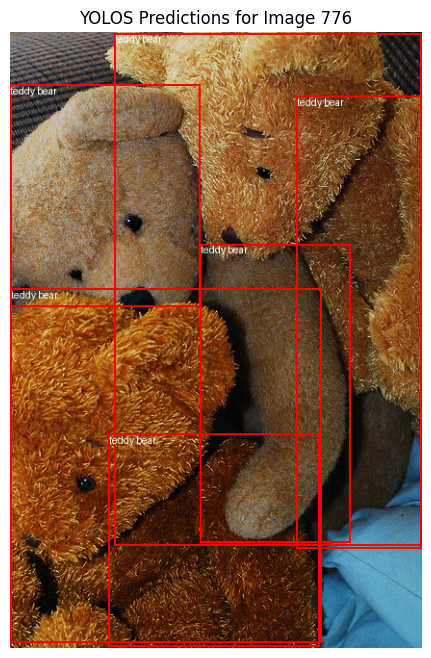

100%|██████████| 630/630 [02:27<00:00,  4.28it/s]


mAP@[0.5:0.95]: tensor(0.3848)
Detailed mAP results: {'map': tensor(0.3848), 'map_50': tensor(0.5605), 'map_75': tensor(0.4114), 'map_small': tensor(0.1218), 'map_medium': tensor(0.3412), 'map_large': tensor(0.5484), 'mar_1': tensor(0.3156), 'mar_10': tensor(0.4570), 'mar_100': tensor(0.4681), 'mar_small': tensor(0.1681), 'mar_medium': tensor(0.4300), 'mar_large': tensor(0.6248), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 4 - Validation mAP Score: 0.3848


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.384827,0.560478,0.41144,0.121807,0.341225,0.548403,0.315648,0.456967,0.468066,0.168062,0.430008,0.624801,-1.0,-1.0


Best model saved with mAP 0.3848 at epoch 4


  0%|          | 1/368 [00:03<20:18,  3.32s/it]

Epoch 5, Batch 0: Loss = 0.9513


  3%|▎         | 11/368 [00:52<29:06,  4.89s/it]

Epoch 5, Batch 10: Loss = 1.1884


  6%|▌         | 21/368 [01:34<24:14,  4.19s/it]

Epoch 5, Batch 20: Loss = 1.0756


  8%|▊         | 31/368 [02:12<18:10,  3.24s/it]

Epoch 5, Batch 30: Loss = 0.8978


 11%|█         | 41/368 [02:54<24:25,  4.48s/it]

Epoch 5, Batch 40: Loss = 0.9733


 14%|█▍        | 51/368 [03:39<26:21,  4.99s/it]

Epoch 5, Batch 50: Loss = 1.1038


 17%|█▋        | 61/368 [04:18<22:40,  4.43s/it]

Epoch 5, Batch 60: Loss = 1.0938


 19%|█▉        | 71/368 [05:00<21:47,  4.40s/it]

Epoch 5, Batch 70: Loss = 1.1331


 22%|██▏       | 81/368 [05:44<19:15,  4.02s/it]

Epoch 5, Batch 80: Loss = 1.1164


 25%|██▍       | 91/368 [06:26<18:05,  3.92s/it]

Epoch 5, Batch 90: Loss = 0.8635


 27%|██▋       | 101/368 [07:14<22:37,  5.09s/it]

Epoch 5, Batch 100: Loss = 1.2342


 30%|███       | 111/368 [07:58<18:57,  4.43s/it]

Epoch 5, Batch 110: Loss = 0.8977


 33%|███▎      | 121/368 [08:38<17:39,  4.29s/it]

Epoch 5, Batch 120: Loss = 0.8597


 36%|███▌      | 131/368 [09:13<13:47,  3.49s/it]

Epoch 5, Batch 130: Loss = 1.1090


 38%|███▊      | 141/368 [09:53<14:15,  3.77s/it]

Epoch 5, Batch 140: Loss = 1.3618


 41%|████      | 151/368 [10:29<12:34,  3.47s/it]

Epoch 5, Batch 150: Loss = 0.8860


 44%|████▍     | 161/368 [11:18<16:34,  4.80s/it]

Epoch 5, Batch 160: Loss = 0.9536


 46%|████▋     | 171/368 [12:00<14:13,  4.33s/it]

Epoch 5, Batch 170: Loss = 1.0484


 49%|████▉     | 181/368 [12:35<11:24,  3.66s/it]

Epoch 5, Batch 180: Loss = 1.1309


 52%|█████▏    | 191/368 [13:08<10:10,  3.45s/it]

Epoch 5, Batch 190: Loss = 1.0849


 55%|█████▍    | 201/368 [13:47<10:40,  3.84s/it]

Epoch 5, Batch 200: Loss = 1.0246


 57%|█████▋    | 211/368 [14:30<09:54,  3.79s/it]

Epoch 5, Batch 210: Loss = 1.3189


 60%|██████    | 221/368 [15:15<12:08,  4.96s/it]

Epoch 5, Batch 220: Loss = 1.0662


 63%|██████▎   | 231/368 [15:56<11:35,  5.07s/it]

Epoch 5, Batch 230: Loss = 1.0941


 65%|██████▌   | 241/368 [16:37<08:20,  3.94s/it]

Epoch 5, Batch 240: Loss = 0.8768


 68%|██████▊   | 251/368 [17:21<08:10,  4.19s/it]

Epoch 5, Batch 250: Loss = 1.2632


 71%|███████   | 261/368 [18:03<07:08,  4.00s/it]

Epoch 5, Batch 260: Loss = 0.9500


 74%|███████▎  | 271/368 [18:41<06:20,  3.93s/it]

Epoch 5, Batch 270: Loss = 1.1031


 76%|███████▋  | 281/368 [19:21<05:21,  3.69s/it]

Epoch 5, Batch 280: Loss = 0.9922


 79%|███████▉  | 291/368 [20:07<06:06,  4.76s/it]

Epoch 5, Batch 290: Loss = 1.0725


 82%|████████▏ | 301/368 [20:51<04:44,  4.24s/it]

Epoch 5, Batch 300: Loss = 1.4601


 85%|████████▍ | 311/368 [21:29<03:42,  3.90s/it]

Epoch 5, Batch 310: Loss = 0.9293


 87%|████████▋ | 321/368 [22:09<02:54,  3.71s/it]

Epoch 5, Batch 320: Loss = 1.2543


 90%|████████▉ | 331/368 [22:48<02:17,  3.72s/it]

Epoch 5, Batch 330: Loss = 1.0054


 93%|█████████▎| 341/368 [23:33<02:04,  4.61s/it]

Epoch 5, Batch 340: Loss = 1.0215


 95%|█████████▌| 351/368 [24:09<00:59,  3.48s/it]

Epoch 5, Batch 350: Loss = 0.8350


 98%|█████████▊| 361/368 [24:49<00:24,  3.43s/it]

Epoch 5, Batch 360: Loss = 0.9238


100%|██████████| 368/368 [25:21<00:00,  4.13s/it]


Epoch 5 Complete. Average train Loss: 4.2474, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:58<00:00,  1.13s/it]


Epoch 5 - Validation Loss: 4.2093


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.938 at location [0.98, 266.81, 323.39, 634.98]
Detected teddy bear with confidence 0.873 at location [197.65, 220.36, 353.15, 530.69]
Detected teddy bear with confidence 0.633 at location [297.8, 66.73, 427.95, 536.56]
Detected teddy bear with confidence 0.967 at location [108.99, 1.43, 427.57, 534.0]
Detected teddy bear with confidence 0.984 at location [0.09, 54.75, 197.76, 285.86]
Detected teddy bear with confidence 0.543 at location [102.87, 417.73, 321.24, 638.76]


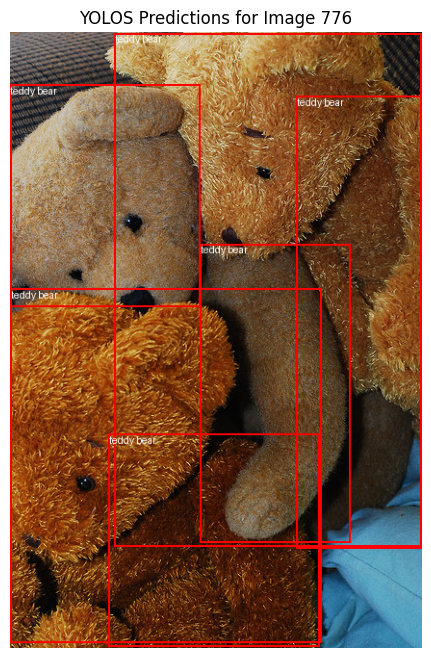

100%|██████████| 630/630 [02:27<00:00,  4.28it/s]


mAP@[0.5:0.95]: tensor(0.3856)
Detailed mAP results: {'map': tensor(0.3856), 'map_50': tensor(0.5617), 'map_75': tensor(0.4119), 'map_small': tensor(0.1274), 'map_medium': tensor(0.3404), 'map_large': tensor(0.5489), 'mar_1': tensor(0.3165), 'mar_10': tensor(0.4579), 'mar_100': tensor(0.4693), 'mar_small': tensor(0.1787), 'mar_medium': tensor(0.4300), 'mar_large': tensor(0.6261), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 5 - Validation mAP Score: 0.3856


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.385563,0.561692,0.411927,0.127403,0.340413,0.548942,0.316532,0.457878,0.469338,0.178748,0.42996,0.626105,-1.0,-1.0


Best model saved with mAP 0.3856 at epoch 5


  0%|          | 1/368 [00:02<16:39,  2.72s/it]

Epoch 6, Batch 0: Loss = 1.1951


  3%|▎         | 11/368 [00:47<28:35,  4.80s/it]

Epoch 6, Batch 10: Loss = 0.7879


  6%|▌         | 21/368 [01:35<27:25,  4.74s/it]

Epoch 6, Batch 20: Loss = 0.9148


  8%|▊         | 31/368 [02:10<20:37,  3.67s/it]

Epoch 6, Batch 30: Loss = 1.0295


 11%|█         | 41/368 [02:53<23:10,  4.25s/it]

Epoch 6, Batch 40: Loss = 1.2412


 14%|█▍        | 51/368 [03:38<26:17,  4.98s/it]

Epoch 6, Batch 50: Loss = 1.0938


 17%|█▋        | 61/368 [04:23<21:43,  4.25s/it]

Epoch 6, Batch 60: Loss = 0.9156


 19%|█▉        | 71/368 [04:59<17:45,  3.59s/it]

Epoch 6, Batch 70: Loss = 0.9685


 22%|██▏       | 81/368 [05:43<21:30,  4.49s/it]

Epoch 6, Batch 80: Loss = 0.8603


 25%|██▍       | 91/368 [06:29<20:06,  4.36s/it]

Epoch 6, Batch 90: Loss = 1.0941


 27%|██▋       | 101/368 [07:10<16:54,  3.80s/it]

Epoch 6, Batch 100: Loss = 1.0641


 30%|███       | 111/368 [07:45<17:11,  4.01s/it]

Epoch 6, Batch 110: Loss = 0.7879


 33%|███▎      | 121/368 [08:25<17:47,  4.32s/it]

Epoch 6, Batch 120: Loss = 1.0606


 36%|███▌      | 131/368 [09:02<15:26,  3.91s/it]

Epoch 6, Batch 130: Loss = 1.0186


 38%|███▊      | 141/368 [09:41<13:19,  3.52s/it]

Epoch 6, Batch 140: Loss = 0.9350


 41%|████      | 151/368 [10:24<13:44,  3.80s/it]

Epoch 6, Batch 150: Loss = 1.1961


 44%|████▍     | 161/368 [11:04<13:06,  3.80s/it]

Epoch 6, Batch 160: Loss = 1.1249


 46%|████▋     | 171/368 [11:45<12:01,  3.66s/it]

Epoch 6, Batch 170: Loss = 0.9384


 49%|████▉     | 181/368 [12:30<15:33,  4.99s/it]

Epoch 6, Batch 180: Loss = 1.0244


 52%|█████▏    | 191/368 [13:14<13:53,  4.71s/it]

Epoch 6, Batch 190: Loss = 1.0587


 55%|█████▍    | 201/368 [14:01<13:42,  4.92s/it]

Epoch 6, Batch 200: Loss = 0.9344


 57%|█████▋    | 211/368 [14:45<10:43,  4.10s/it]

Epoch 6, Batch 210: Loss = 1.2345


 60%|██████    | 221/368 [15:25<08:23,  3.43s/it]

Epoch 6, Batch 220: Loss = 1.0063


 63%|██████▎   | 231/368 [16:05<10:12,  4.47s/it]

Epoch 6, Batch 230: Loss = 0.9004


 65%|██████▌   | 241/368 [16:51<09:10,  4.34s/it]

Epoch 6, Batch 240: Loss = 0.8697


 68%|██████▊   | 251/368 [17:25<06:18,  3.24s/it]

Epoch 6, Batch 250: Loss = 1.2026


 71%|███████   | 261/368 [18:07<06:19,  3.55s/it]

Epoch 6, Batch 260: Loss = 0.9558


 74%|███████▎  | 271/368 [18:46<07:10,  4.44s/it]

Epoch 6, Batch 270: Loss = 1.2068


 76%|███████▋  | 281/368 [19:31<06:58,  4.82s/it]

Epoch 6, Batch 280: Loss = 0.8899


 79%|███████▉  | 291/368 [20:06<04:31,  3.52s/it]

Epoch 6, Batch 290: Loss = 1.1278


 82%|████████▏ | 301/368 [20:49<05:11,  4.64s/it]

Epoch 6, Batch 300: Loss = 0.9054


 85%|████████▍ | 311/368 [21:30<03:55,  4.14s/it]

Epoch 6, Batch 310: Loss = 1.0674


 87%|████████▋ | 321/368 [22:09<02:56,  3.76s/it]

Epoch 6, Batch 320: Loss = 1.1648


 90%|████████▉ | 331/368 [22:51<02:41,  4.37s/it]

Epoch 6, Batch 330: Loss = 0.9392


 93%|█████████▎| 341/368 [23:35<02:11,  4.87s/it]

Epoch 6, Batch 340: Loss = 0.8987


 95%|█████████▌| 351/368 [24:17<01:14,  4.35s/it]

Epoch 6, Batch 350: Loss = 1.3314


 98%|█████████▊| 361/368 [24:59<00:28,  4.07s/it]

Epoch 6, Batch 360: Loss = 1.1101


100%|██████████| 368/368 [25:24<00:00,  4.14s/it]


Epoch 6 Complete. Average train Loss: 4.2040, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:58<00:00,  1.13s/it]


Epoch 6 - Validation Loss: 4.1788


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.98, 266.76, 323.37, 634.99]
Detected teddy bear with confidence 0.504 at location [303.52, 65.63, 427.7, 413.4]
Detected teddy bear with confidence 0.879 at location [197.69, 220.31, 353.13, 530.71]
Detected teddy bear with confidence 0.64 at location [297.8, 66.79, 427.95, 536.6]
Detected teddy bear with confidence 0.966 at location [109.01, 1.43, 427.57, 534.02]
Detected teddy bear with confidence 0.985 at location [0.08, 54.79, 197.74, 285.95]
Detected teddy bear with confidence 0.553 at location [102.86, 417.69, 321.24, 638.76]


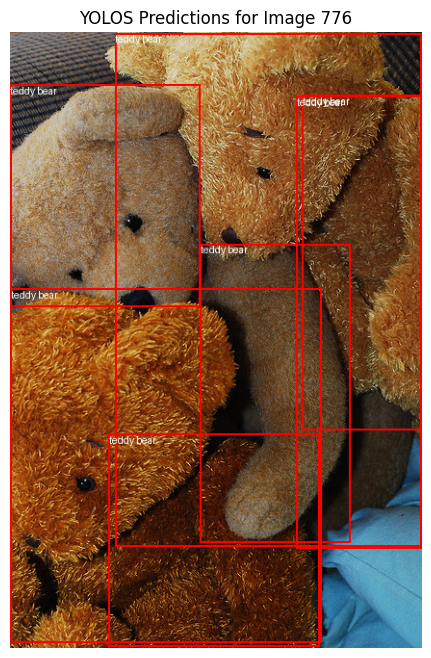

100%|██████████| 630/630 [02:27<00:00,  4.27it/s]


mAP@[0.5:0.95]: tensor(0.3860)
Detailed mAP results: {'map': tensor(0.3860), 'map_50': tensor(0.5618), 'map_75': tensor(0.4130), 'map_small': tensor(0.1277), 'map_medium': tensor(0.3408), 'map_large': tensor(0.5496), 'mar_1': tensor(0.3167), 'mar_10': tensor(0.4589), 'mar_100': tensor(0.4704), 'mar_small': tensor(0.1791), 'mar_medium': tensor(0.4317), 'mar_large': tensor(0.6271), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 6 - Validation mAP Score: 0.3860


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.386021,0.561789,0.412963,0.12774,0.340822,0.549606,0.316658,0.45891,0.470429,0.17906,0.431716,0.627123,-1.0,-1.0


Best model saved with mAP 0.3860 at epoch 6


  0%|          | 1/368 [00:03<20:15,  3.31s/it]

Epoch 7, Batch 0: Loss = 0.9854


  3%|▎         | 11/368 [00:44<26:19,  4.42s/it]

Epoch 7, Batch 10: Loss = 0.8031


  6%|▌         | 21/368 [01:22<19:57,  3.45s/it]

Epoch 7, Batch 20: Loss = 1.0692


  8%|▊         | 31/368 [02:04<22:49,  4.07s/it]

Epoch 7, Batch 30: Loss = 1.0874


 11%|█         | 41/368 [02:52<25:00,  4.59s/it]

Epoch 7, Batch 40: Loss = 0.9522


 14%|█▍        | 51/368 [03:34<27:19,  5.17s/it]

Epoch 7, Batch 50: Loss = 0.9292


 17%|█▋        | 61/368 [04:16<19:43,  3.86s/it]

Epoch 7, Batch 60: Loss = 1.0165


 19%|█▉        | 71/368 [05:00<22:15,  4.50s/it]

Epoch 7, Batch 70: Loss = 1.3182


 22%|██▏       | 81/368 [05:38<17:46,  3.72s/it]

Epoch 7, Batch 80: Loss = 0.8725


 25%|██▍       | 91/368 [06:17<16:35,  3.59s/it]

Epoch 7, Batch 90: Loss = 1.3076


 27%|██▋       | 101/368 [07:01<21:44,  4.88s/it]

Epoch 7, Batch 100: Loss = 0.9633


 30%|███       | 111/368 [07:41<18:40,  4.36s/it]

Epoch 7, Batch 110: Loss = 1.1514


 33%|███▎      | 121/368 [08:33<21:24,  5.20s/it]

Epoch 7, Batch 120: Loss = 0.9415


 36%|███▌      | 131/368 [09:12<16:30,  4.18s/it]

Epoch 7, Batch 130: Loss = 0.8564


 38%|███▊      | 141/368 [09:57<18:33,  4.90s/it]

Epoch 7, Batch 140: Loss = 0.9005


 41%|████      | 151/368 [10:35<15:03,  4.16s/it]

Epoch 7, Batch 150: Loss = 1.0881


 44%|████▍     | 161/368 [11:17<13:53,  4.03s/it]

Epoch 7, Batch 160: Loss = 0.9755


 46%|████▋     | 171/368 [11:58<11:19,  3.45s/it]

Epoch 7, Batch 170: Loss = 0.8679


 49%|████▉     | 181/368 [12:38<11:48,  3.79s/it]

Epoch 7, Batch 180: Loss = 1.2165


 52%|█████▏    | 191/368 [13:18<13:38,  4.62s/it]

Epoch 7, Batch 190: Loss = 0.9642


 55%|█████▍    | 201/368 [13:58<11:15,  4.05s/it]

Epoch 7, Batch 200: Loss = 0.8787


 57%|█████▋    | 211/368 [14:41<09:29,  3.63s/it]

Epoch 7, Batch 210: Loss = 1.2316


 60%|██████    | 221/368 [15:20<08:52,  3.62s/it]

Epoch 7, Batch 220: Loss = 0.8973


 63%|██████▎   | 231/368 [15:58<08:21,  3.66s/it]

Epoch 7, Batch 230: Loss = 0.9911


 65%|██████▌   | 241/368 [16:36<08:26,  3.99s/it]

Epoch 7, Batch 240: Loss = 0.8635


 68%|██████▊   | 251/368 [17:14<07:06,  3.64s/it]

Epoch 7, Batch 250: Loss = 1.0803


 71%|███████   | 261/368 [17:56<07:38,  4.29s/it]

Epoch 7, Batch 260: Loss = 1.2466


 74%|███████▎  | 271/368 [18:32<05:56,  3.68s/it]

Epoch 7, Batch 270: Loss = 1.0568


 76%|███████▋  | 281/368 [19:10<05:35,  3.85s/it]

Epoch 7, Batch 280: Loss = 1.0057


 79%|███████▉  | 291/368 [19:51<05:47,  4.51s/it]

Epoch 7, Batch 290: Loss = 1.0674


 82%|████████▏ | 301/368 [20:33<04:04,  3.65s/it]

Epoch 7, Batch 300: Loss = 1.3288


 85%|████████▍ | 311/368 [21:14<03:45,  3.96s/it]

Epoch 7, Batch 310: Loss = 1.0307


 87%|████████▋ | 321/368 [22:00<02:51,  3.65s/it]

Epoch 7, Batch 320: Loss = 1.1715


 90%|████████▉ | 331/368 [22:39<02:26,  3.95s/it]

Epoch 7, Batch 330: Loss = 1.0953


 93%|█████████▎| 341/368 [23:16<01:35,  3.55s/it]

Epoch 7, Batch 340: Loss = 1.0603


 95%|█████████▌| 351/368 [23:57<00:58,  3.42s/it]

Epoch 7, Batch 350: Loss = 1.0241


 98%|█████████▊| 361/368 [24:45<00:34,  4.88s/it]

Epoch 7, Batch 360: Loss = 0.9076


100%|██████████| 368/368 [25:09<00:00,  4.10s/it]


Epoch 7 Complete. Average train Loss: 4.1835, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:01<00:00,  1.15s/it]


Epoch 7 - Validation Loss: 4.1549


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.97, 266.71, 323.36, 635.0]
Detected teddy bear with confidence 0.515 at location [303.51, 65.69, 427.7, 413.45]
Detected teddy bear with confidence 0.884 at location [197.73, 220.28, 353.11, 530.73]
Detected teddy bear with confidence 0.645 at location [297.8, 66.84, 427.95, 536.63]
Detected teddy bear with confidence 0.966 at location [109.03, 1.43, 427.57, 534.03]
Detected teddy bear with confidence 0.985 at location [0.07, 54.83, 197.72, 286.01]
Detected teddy bear with confidence 0.56 at location [102.86, 417.66, 321.24, 638.75]


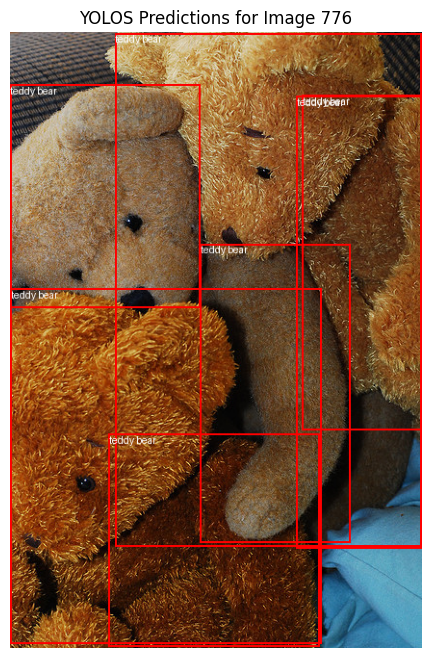

100%|██████████| 630/630 [02:27<00:00,  4.28it/s]


mAP@[0.5:0.95]: tensor(0.3866)
Detailed mAP results: {'map': tensor(0.3866), 'map_50': tensor(0.5620), 'map_75': tensor(0.4137), 'map_small': tensor(0.1290), 'map_medium': tensor(0.3410), 'map_large': tensor(0.5519), 'mar_1': tensor(0.3172), 'mar_10': tensor(0.4595), 'mar_100': tensor(0.4714), 'mar_small': tensor(0.1798), 'mar_medium': tensor(0.4323), 'mar_large': tensor(0.6314), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 7 - Validation mAP Score: 0.3866


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.38662,0.562001,0.413676,0.128989,0.341016,0.551896,0.317203,0.459545,0.471383,0.179803,0.432348,0.631364,-1.0,-1.0


Best model saved with mAP 0.3866 at epoch 7


  0%|          | 1/368 [00:04<27:20,  4.47s/it]

Epoch 8, Batch 0: Loss = 0.9739


  3%|▎         | 11/368 [00:46<28:31,  4.79s/it]

Epoch 8, Batch 10: Loss = 1.0875


  6%|▌         | 21/368 [01:24<27:03,  4.68s/it]

Epoch 8, Batch 20: Loss = 1.0341


  8%|▊         | 31/368 [02:07<29:07,  5.19s/it]

Epoch 8, Batch 30: Loss = 1.0612


 11%|█         | 41/368 [02:47<23:48,  4.37s/it]

Epoch 8, Batch 40: Loss = 1.0601


 14%|█▍        | 51/368 [03:34<20:45,  3.93s/it]

Epoch 8, Batch 50: Loss = 1.0933


 17%|█▋        | 61/368 [04:14<23:12,  4.54s/it]

Epoch 8, Batch 60: Loss = 1.1676


 19%|█▉        | 71/368 [04:55<21:12,  4.28s/it]

Epoch 8, Batch 70: Loss = 1.0935


 22%|██▏       | 81/368 [05:33<19:48,  4.14s/it]

Epoch 8, Batch 80: Loss = 1.1603


 25%|██▍       | 91/368 [06:17<21:53,  4.74s/it]

Epoch 8, Batch 90: Loss = 0.8114


 27%|██▋       | 101/368 [06:54<16:58,  3.81s/it]

Epoch 8, Batch 100: Loss = 1.1973


 30%|███       | 111/368 [07:40<18:06,  4.23s/it]

Epoch 8, Batch 110: Loss = 1.0947


 33%|███▎      | 121/368 [08:24<16:29,  4.01s/it]

Epoch 8, Batch 120: Loss = 0.9162


 36%|███▌      | 131/368 [09:08<15:52,  4.02s/it]

Epoch 8, Batch 130: Loss = 1.1164


 38%|███▊      | 141/368 [09:57<19:24,  5.13s/it]

Epoch 8, Batch 140: Loss = 0.9450


 41%|████      | 151/368 [10:44<17:11,  4.75s/it]

Epoch 8, Batch 150: Loss = 1.2221


 44%|████▍     | 161/368 [11:22<12:16,  3.56s/it]

Epoch 8, Batch 160: Loss = 0.8098


 46%|████▋     | 171/368 [11:59<10:50,  3.30s/it]

Epoch 8, Batch 170: Loss = 0.9695


 49%|████▉     | 181/368 [12:35<09:57,  3.19s/it]

Epoch 8, Batch 180: Loss = 1.0000


 52%|█████▏    | 191/368 [13:10<10:41,  3.63s/it]

Epoch 8, Batch 190: Loss = 1.2780


 55%|█████▍    | 201/368 [13:51<09:55,  3.56s/it]

Epoch 8, Batch 200: Loss = 0.9546


 57%|█████▋    | 211/368 [14:31<10:01,  3.83s/it]

Epoch 8, Batch 210: Loss = 0.9302


 60%|██████    | 221/368 [15:16<10:38,  4.34s/it]

Epoch 8, Batch 220: Loss = 1.4229


 63%|██████▎   | 231/368 [16:01<09:32,  4.18s/it]

Epoch 8, Batch 230: Loss = 1.1062


 65%|██████▌   | 241/368 [16:40<09:01,  4.26s/it]

Epoch 8, Batch 240: Loss = 1.0477


 68%|██████▊   | 251/368 [17:18<07:30,  3.85s/it]

Epoch 8, Batch 250: Loss = 1.0063


 71%|███████   | 261/368 [18:01<06:47,  3.80s/it]

Epoch 8, Batch 260: Loss = 0.8847


 74%|███████▎  | 271/368 [18:44<07:03,  4.36s/it]

Epoch 8, Batch 270: Loss = 1.0676


 76%|███████▋  | 281/368 [19:25<06:00,  4.14s/it]

Epoch 8, Batch 280: Loss = 1.1137


 79%|███████▉  | 291/368 [20:04<04:25,  3.45s/it]

Epoch 8, Batch 290: Loss = 1.0974


 82%|████████▏ | 301/368 [20:39<04:06,  3.68s/it]

Epoch 8, Batch 300: Loss = 0.9396


 85%|████████▍ | 311/368 [21:20<04:20,  4.58s/it]

Epoch 8, Batch 310: Loss = 0.7622


 87%|████████▋ | 321/368 [22:01<03:25,  4.38s/it]

Epoch 8, Batch 320: Loss = 0.9315


 90%|████████▉ | 331/368 [22:36<02:08,  3.46s/it]

Epoch 8, Batch 330: Loss = 1.1640


 93%|█████████▎| 341/368 [23:11<01:51,  4.13s/it]

Epoch 8, Batch 340: Loss = 1.1315


 95%|█████████▌| 351/368 [23:55<01:11,  4.19s/it]

Epoch 8, Batch 350: Loss = 1.1365


 98%|█████████▊| 361/368 [24:29<00:24,  3.54s/it]

Epoch 8, Batch 360: Loss = 1.0820


100%|██████████| 368/368 [24:53<00:00,  4.06s/it]


Epoch 8 Complete. Average train Loss: 4.1782, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 8 - Validation Loss: 4.1395


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.97, 266.68, 323.35, 635.0]
Detected teddy bear with confidence 0.521 at location [303.5, 65.72, 427.7, 413.48]
Detected teddy bear with confidence 0.887 at location [197.75, 220.26, 353.09, 530.75]
Detected teddy bear with confidence 0.648 at location [297.8, 66.87, 427.95, 536.65]
Detected teddy bear with confidence 0.966 at location [109.04, 1.43, 427.57, 534.04]
Detected teddy bear with confidence 0.985 at location [0.07, 54.85, 197.71, 286.06]
Detected teddy bear with confidence 0.565 at location [102.85, 417.64, 321.25, 638.75]


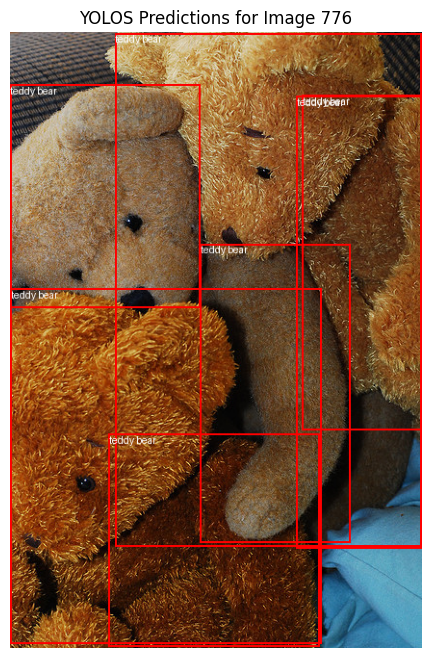

100%|██████████| 630/630 [02:27<00:00,  4.29it/s]


mAP@[0.5:0.95]: tensor(0.3866)
Detailed mAP results: {'map': tensor(0.3866), 'map_50': tensor(0.5623), 'map_75': tensor(0.4138), 'map_small': tensor(0.1290), 'map_medium': tensor(0.3397), 'map_large': tensor(0.5514), 'mar_1': tensor(0.3171), 'mar_10': tensor(0.4594), 'mar_100': tensor(0.4713), 'mar_small': tensor(0.1803), 'mar_medium': tensor(0.4311), 'mar_large': tensor(0.6312), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 8 - Validation mAP Score: 0.3866


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.386582,0.562343,0.413843,0.128989,0.339692,0.551394,0.317059,0.459419,0.471296,0.180284,0.431127,0.631167,-1.0,-1.0


  0%|          | 1/368 [00:07<43:53,  7.18s/it]

Epoch 9, Batch 0: Loss = 1.1980


  3%|▎         | 11/368 [00:49<21:52,  3.68s/it]

Epoch 9, Batch 10: Loss = 0.6904


  6%|▌         | 21/368 [01:29<23:25,  4.05s/it]

Epoch 9, Batch 20: Loss = 0.9625


  8%|▊         | 31/368 [02:08<21:40,  3.86s/it]

Epoch 9, Batch 30: Loss = 1.0918


 11%|█         | 41/368 [02:45<21:31,  3.95s/it]

Epoch 9, Batch 40: Loss = 1.0338


 14%|█▍        | 51/368 [03:28<21:36,  4.09s/it]

Epoch 9, Batch 50: Loss = 1.1716


 17%|█▋        | 61/368 [04:09<20:41,  4.05s/it]

Epoch 9, Batch 60: Loss = 1.1017


 19%|█▉        | 71/368 [04:55<21:17,  4.30s/it]

Epoch 9, Batch 70: Loss = 1.0794


 22%|██▏       | 81/368 [05:40<22:22,  4.68s/it]

Epoch 9, Batch 80: Loss = 0.9981


 25%|██▍       | 91/368 [06:23<21:13,  4.60s/it]

Epoch 9, Batch 90: Loss = 1.0481


 27%|██▋       | 101/368 [07:08<20:30,  4.61s/it]

Epoch 9, Batch 100: Loss = 1.0220


 30%|███       | 111/368 [07:54<21:01,  4.91s/it]

Epoch 9, Batch 110: Loss = 0.7779


 33%|███▎      | 121/368 [08:34<17:47,  4.32s/it]

Epoch 9, Batch 120: Loss = 0.9979


 36%|███▌      | 131/368 [09:16<16:36,  4.20s/it]

Epoch 9, Batch 130: Loss = 1.1175


 38%|███▊      | 141/368 [10:00<16:02,  4.24s/it]

Epoch 9, Batch 140: Loss = 1.2507


 41%|████      | 151/368 [10:40<13:38,  3.77s/it]

Epoch 9, Batch 150: Loss = 1.2118


 44%|████▍     | 161/368 [11:20<13:50,  4.01s/it]

Epoch 9, Batch 160: Loss = 1.2018


 46%|████▋     | 171/368 [12:05<15:37,  4.76s/it]

Epoch 9, Batch 170: Loss = 1.3554


 49%|████▉     | 181/368 [12:47<15:01,  4.82s/it]

Epoch 9, Batch 180: Loss = 1.1841


 52%|█████▏    | 191/368 [13:24<12:18,  4.17s/it]

Epoch 9, Batch 190: Loss = 1.2687


 55%|█████▍    | 201/368 [14:03<08:56,  3.21s/it]

Epoch 9, Batch 200: Loss = 0.9960


 57%|█████▋    | 211/368 [14:45<10:25,  3.98s/it]

Epoch 9, Batch 210: Loss = 1.4307


 60%|██████    | 221/368 [15:27<10:18,  4.21s/it]

Epoch 9, Batch 220: Loss = 1.0419


 63%|██████▎   | 231/368 [16:03<09:00,  3.95s/it]

Epoch 9, Batch 230: Loss = 1.0989


 65%|██████▌   | 241/368 [16:46<09:37,  4.55s/it]

Epoch 9, Batch 240: Loss = 1.0458


 68%|██████▊   | 251/368 [17:21<05:52,  3.02s/it]

Epoch 9, Batch 250: Loss = 0.9263


 71%|███████   | 261/368 [18:01<07:53,  4.42s/it]

Epoch 9, Batch 260: Loss = 0.9690


 74%|███████▎  | 271/368 [18:42<06:30,  4.03s/it]

Epoch 9, Batch 270: Loss = 1.0571


 76%|███████▋  | 281/368 [19:21<05:22,  3.70s/it]

Epoch 9, Batch 280: Loss = 1.0031


 79%|███████▉  | 291/368 [19:58<04:45,  3.71s/it]

Epoch 9, Batch 290: Loss = 1.3195


 82%|████████▏ | 301/368 [20:40<04:52,  4.37s/it]

Epoch 9, Batch 300: Loss = 0.9115


 85%|████████▍ | 311/368 [21:23<03:42,  3.90s/it]

Epoch 9, Batch 310: Loss = 1.0116


 87%|████████▋ | 321/368 [21:58<02:56,  3.76s/it]

Epoch 9, Batch 320: Loss = 0.9808


 90%|████████▉ | 331/368 [22:40<02:40,  4.35s/it]

Epoch 9, Batch 330: Loss = 0.9565


 93%|█████████▎| 341/368 [23:17<01:45,  3.89s/it]

Epoch 9, Batch 340: Loss = 1.0570


 95%|█████████▌| 351/368 [23:59<01:20,  4.76s/it]

Epoch 9, Batch 350: Loss = 1.2583


 98%|█████████▊| 361/368 [24:33<00:24,  3.48s/it]

Epoch 9, Batch 360: Loss = 0.9884


100%|██████████| 368/368 [25:03<00:00,  4.08s/it]


Epoch 9 Complete. Average train Loss: 4.1519, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:01<00:00,  1.15s/it]


Epoch 9 - Validation Loss: 4.1314


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.97, 266.66, 323.35, 635.0]
Detected teddy bear with confidence 0.525 at location [303.5, 65.74, 427.7, 413.5]
Detected teddy bear with confidence 0.889 at location [197.76, 220.24, 353.09, 530.76]
Detected teddy bear with confidence 0.65 at location [297.8, 66.88, 427.95, 536.66]
Detected teddy bear with confidence 0.966 at location [109.05, 1.43, 427.57, 534.05]
Detected teddy bear with confidence 0.985 at location [0.07, 54.87, 197.7, 286.09]
Detected teddy bear with confidence 0.568 at location [102.85, 417.62, 321.25, 638.75]


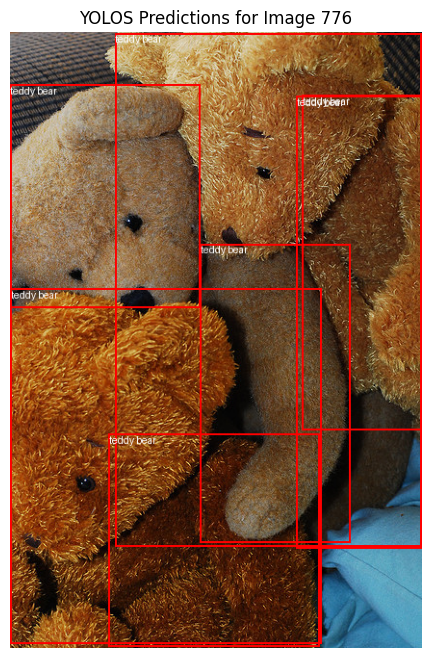

100%|██████████| 630/630 [02:27<00:00,  4.27it/s]


mAP@[0.5:0.95]: tensor(0.3869)
Detailed mAP results: {'map': tensor(0.3869), 'map_50': tensor(0.5625), 'map_75': tensor(0.4150), 'map_small': tensor(0.1290), 'map_medium': tensor(0.3397), 'map_large': tensor(0.5517), 'mar_1': tensor(0.3170), 'mar_10': tensor(0.4598), 'mar_100': tensor(0.4716), 'mar_small': tensor(0.1802), 'mar_medium': tensor(0.4309), 'mar_large': tensor(0.6319), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 9 - Validation mAP Score: 0.3869


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.386879,0.562545,0.415015,0.128983,0.339661,0.551742,0.317012,0.459763,0.471591,0.180161,0.430882,0.631933,-1.0,-1.0


Best model saved with mAP 0.3869 at epoch 9
Early stopping triggered - Training Stopped!


In [ ]:
# Train Setting
epochs = 10
optimizer = torch.optim.AdamW(adalora_parameters, lr=3e-5, weight_decay=0.01)
scheduler = CosineAnnealingLR(optimizer, T_max=10, eta_min=1e-6)
early_stopping = EarlyStopping(patience=3)

# Train the AdaLoRA model
best_mAP_scores_AdaLoRA, epochs_list_AdaLoRA, train_total_losses_AdaLoRA, val_total_losses_AdaLoRA, train_focal_losses_AdaLoRA, train_bbox_losses_AdaLoRA, train_giou_losses_AdaLoRA, mAP_scores_AdaLoRA = train_model(
    model_with_AdaLoRA, processor, train_dataloader, val_dataloader, optimizer, scheduler, early_stopping, device, "adalora_model.pth", epochs
)


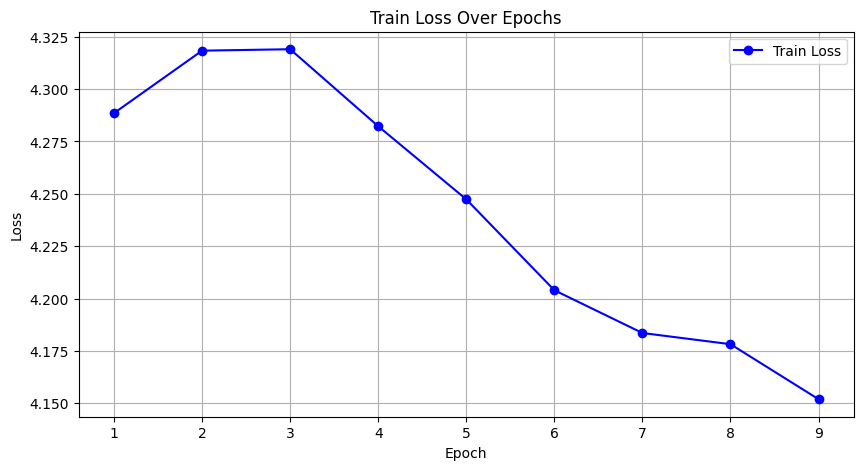

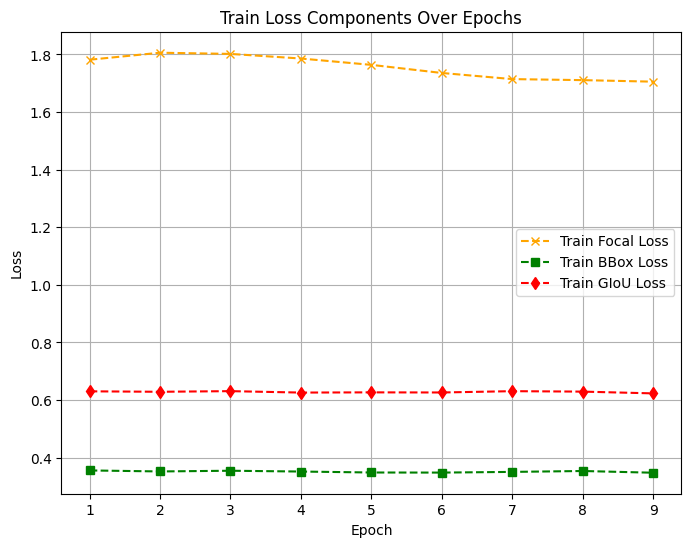

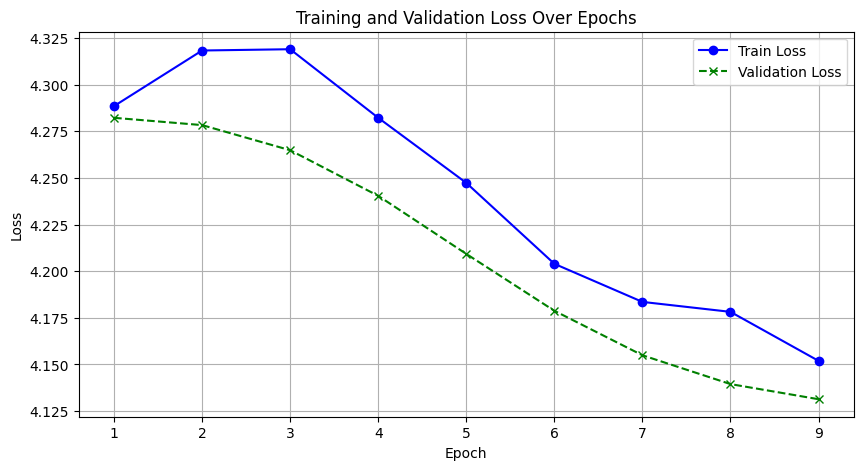

In [ ]:
plot_loss_graphs(epochs_list_AdaLoRA, train_total_losses_AdaLoRA, train_focal_losses_AdaLoRA, train_bbox_losses_AdaLoRA, train_giou_losses_AdaLoRA, val_total_losses_AdaLoRA)


In [ ]:
# Load the saved model from last epoch
model_with_AdaLoRA = torch.load("adalora_model.pth", map_location=torch.device("cuda" if torch.cuda.is_available() else "cpu"))
print(model_with_AdaLoRA.peft_config)

# Check which weights have been updated
for name, param in model_with_AdaLoRA.named_parameters():
    if param.requires_grad:
        print(f"{name} Trainable (Updated)")
    else:
        print(f"{name} Frozen (Original)")

print(model_with_AdaLoRA)


{'default': AdaLoraConfig(task_type=None, peft_type=<PeftType.ADALORA: 'ADALORA'>, auto_mapping=None, base_model_name_or_path='hustvl/yolos-small', revision=None, inference_mode=False, r=8, target_modules={'query', 'value'}, exclude_modules=None, lora_alpha=8, lora_dropout=0.0, fan_in_fan_out=False, bias='none', use_rslora=False, modules_to_save=None, init_lora_weights=True, layers_to_transform=None, layers_pattern=None, rank_pattern=None, alpha_pattern={}, megatron_config=None, megatron_core='megatron.core', trainable_token_indices=None, loftq_config={}, eva_config=None, corda_config=None, use_dora=False, layer_replication=None, runtime_config=LoraRuntimeConfig(ephemeral_gpu_offload=False), lora_bias=False, target_r=16, init_r=24, tinit=20, tfinal=40, deltaT=8, beta1=0.9, beta2=0.88, orth_reg_weight=0.01, total_step=100)}
base_model.model.vit.embeddings.cls_token Frozen (Original)
base_model.model.vit.embeddings.detection_tokens Frozen (Original)
base_model.model.vit.embeddings.positi

<ipython-input-45-902f26a97f21>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_with_AdaLoRA = torch.load("adalora_model.pth", map_location=torch.device("cuda" if tor

In [ ]:
# Mean value of AdaLoRA layers after training
for name, param in model_with_AdaLoRA.named_parameters():
    if "lora" in name:
        print(f"{name} mean after training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lora_A.default mean after training: -0.000346
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_B.default mean after training: -0.000124
base_model.model.vit.encoder.layer.0.attention.attention.query.lora_E.default mean after training: 0.000066
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_A.default mean after training: -0.000264
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_B.default mean after training: -0.000467
base_model.model.vit.encoder.layer.0.attention.attention.value.lora_E.default mean after training: -0.000443
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_A.default mean after training: 0.000295
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_B.default mean after training: 0.000113
base_model.model.vit.encoder.layer.1.attention.attention.query.lora_E.default mean after training: -0.001498
base_model.model.vit.e

#### **Evaluate Model with AdaLoRA**

0it [00:00, ?it/s]

Detected sports ball with confidence 1.0 at location [49.86, 193.68, 188.72, 328.5]
Detected person with confidence 0.896 at location [140.0, 22.34, 462.06, 475.72]
Detected person with confidence 0.998 at location [425.44, 29.51, 618.74, 477.08]
Detected person with confidence 0.997 at location [16.7, 21.51, 461.03, 474.98]


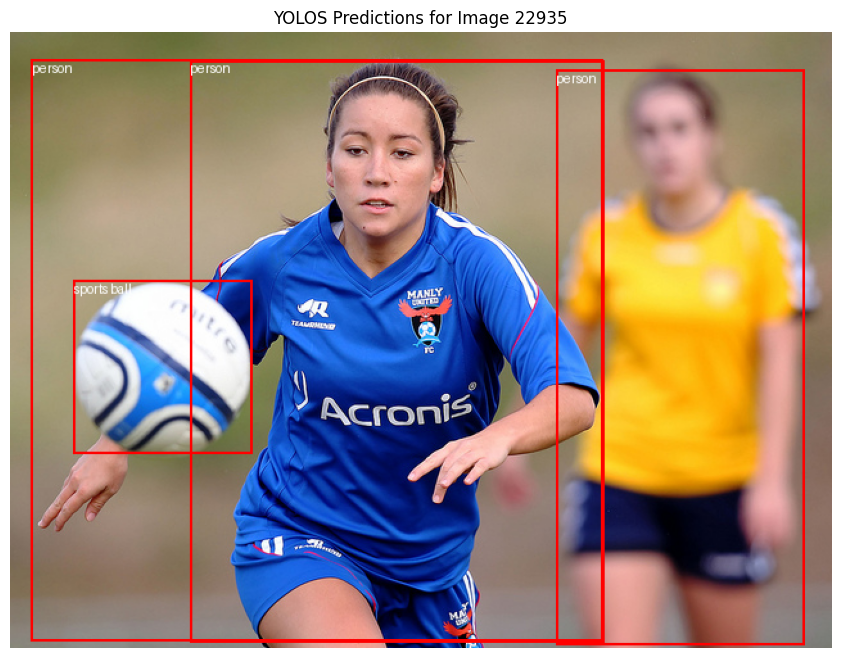

900it [03:44,  4.01it/s]


mAP@[0.5:0.95]: tensor(0.3334)
Detailed mAP results: {'map': tensor(0.3334), 'map_50': tensor(0.5154), 'map_75': tensor(0.3440), 'map_small': tensor(0.0966), 'map_medium': tensor(0.3195), 'map_large': tensor(0.5118), 'mar_1': tensor(0.2846), 'mar_10': tensor(0.4152), 'mar_100': tensor(0.4272), 'mar_small': tensor(0.1503), 'mar_medium': tensor(0.4054), 'mar_large': tensor(0.5997), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Model with AdaLoRA Performance (mAP): {'map': tensor(0.3334), 'map_50': tensor(0.5154), 'map_75': tensor(0.3440), 'map_small': tensor(0.0966), 'map_medium': tens

,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.333447,0.515363,0.344044,0.096612,0.319472,0.511807,0.284558,0.415218,0.427248,0.150288,0.405356,0.599669,-1.0,-1.0


In [ ]:
model_with_AdaLoRA_results = evaluate_model(model_with_AdaLoRA, processor, test_dataset, yolos_categories)
print("Model with AdaLoRA Performance (mAP):", model_with_AdaLoRA_results)

model_with_AdaLoRA_results_dict = {
    key: value.item() if isinstance(value, torch.Tensor) else value
    for key, value in model_with_AdaLoRA_results.items()
    if key != "classes"
}
model_with_AdaLoRA_results_df = pd.DataFrame([model_with_AdaLoRA_results_dict])
print("Model with AdaLoRA Performance (mAP):")
print(model_with_AdaLoRA_results_df)
display(model_with_AdaLoRA_results_df)


### **(c) LoHa- Low Rank Hadamard Product**

#### **LoHaConfig**


In [50]:
# Define model for LoHa
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_for_LoHa = YolosForObjectDetection.from_pretrained(model_name).to(device)

# Configure LoHa
loha_config = LoHaConfig(
    r=8,
    alpha=12,
    rank_dropout=0.1,
    module_dropout=0.1,
    target_modules=target_modules
)

# Apply LoHa to the model
model_with_LoHa = get_peft_model(model_for_LoHa, loha_config)
model_with_LoHa.print_trainable_parameters()

trainable params: 294,912 || all params: 30,979,680 || trainable%: 0.9520


In [51]:
# Inspect LoHa Layers
for name, param in model_with_LoHa.named_parameters():
    print(f"{name} - requires_grad: {param.requires_grad}")

for name, param in model_with_LoHa.named_parameters():
    if "hada" in name:
        print(name, param.shape)


base_model.model.vit.embeddings.cls_token - requires_grad: False
base_model.model.vit.embeddings.detection_tokens - requires_grad: False
base_model.model.vit.embeddings.position_embeddings - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.weight - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.bias - requires_grad: False
base_model.model.vit.encoder.mid_position_embeddings - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.weight - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.bias - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_a.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_b.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w2_a.default - requires_grad: True
base_model.model.vi

In [52]:
# Mean value of LoHa layers before training
for name, param in model_with_LoHa.named_parameters():
    if "hada" in name:
        print(f"{name} mean before training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_a.default mean before training: -0.001273
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_b.default mean before training: -0.000213
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w2_a.default mean before training: -0.002847
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w2_b.default mean before training: 0.000000
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w1_a.default mean before training: 0.000370
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w1_b.default mean before training: 0.000304
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w2_a.default mean before training: -0.008294
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w2_b.default mean before training: 0.000000
base_model.model.vit.encoder.layer.1.attention.attention.query.hada_w1_a.default mean before trainin

In [53]:
loha_total_parameters = [p for p in model_with_LoHa.parameters()]
print(f"Number of LoHA parameter tensors: {len(loha_total_parameters)}")

loha_parameters = [p for p in model_with_LoHa.parameters() if p.requires_grad]
print(f"Number of LoHA trainable parameter tensors (requires_grad=True): {len(loha_parameters)}")


Number of LoHA parameter tensors: 308
Number of LoHA trainable parameter tensors (requires_grad=True): 96


#### **Train Model with LoHa**


  0%|          | 1/368 [00:04<27:16,  4.46s/it]

Epoch 1, Batch 0: Loss = 1.1005


  3%|▎         | 11/368 [00:48<28:19,  4.76s/it]

Epoch 1, Batch 10: Loss = 1.2646


  6%|▌         | 21/368 [01:31<22:43,  3.93s/it]

Epoch 1, Batch 20: Loss = 1.1268


  8%|▊         | 31/368 [02:16<25:20,  4.51s/it]

Epoch 1, Batch 30: Loss = 1.3350


 11%|█         | 41/368 [02:54<19:19,  3.54s/it]

Epoch 1, Batch 40: Loss = 0.9168


 14%|█▍        | 51/368 [03:29<18:39,  3.53s/it]

Epoch 1, Batch 50: Loss = 1.0532


 17%|█▋        | 61/368 [04:13<23:22,  4.57s/it]

Epoch 1, Batch 60: Loss = 1.2212


 19%|█▉        | 71/368 [04:56<21:15,  4.29s/it]

Epoch 1, Batch 70: Loss = 0.8263


 22%|██▏       | 81/368 [05:37<15:54,  3.32s/it]

Epoch 1, Batch 80: Loss = 1.0994


 25%|██▍       | 91/368 [06:14<16:43,  3.62s/it]

Epoch 1, Batch 90: Loss = 0.9350


 27%|██▋       | 101/368 [06:52<15:59,  3.59s/it]

Epoch 1, Batch 100: Loss = 1.4305


 30%|███       | 111/368 [07:29<17:27,  4.08s/it]

Epoch 1, Batch 110: Loss = 1.0318


 33%|███▎      | 121/368 [08:08<19:16,  4.68s/it]

Epoch 1, Batch 120: Loss = 1.0723


 36%|███▌      | 131/368 [08:49<18:51,  4.77s/it]

Epoch 1, Batch 130: Loss = 1.1628


 38%|███▊      | 141/368 [09:31<15:44,  4.16s/it]

Epoch 1, Batch 140: Loss = 0.8741


 41%|████      | 151/368 [10:13<14:38,  4.05s/it]

Epoch 1, Batch 150: Loss = 0.9302


 44%|████▍     | 161/368 [10:49<11:32,  3.35s/it]

Epoch 1, Batch 160: Loss = 1.0555


 46%|████▋     | 171/368 [11:24<13:22,  4.07s/it]

Epoch 1, Batch 170: Loss = 1.1330


 49%|████▉     | 181/368 [12:16<16:24,  5.26s/it]

Epoch 1, Batch 180: Loss = 1.1881


 52%|█████▏    | 191/368 [12:59<12:38,  4.29s/it]

Epoch 1, Batch 190: Loss = 0.6916


 55%|█████▍    | 201/368 [13:41<11:41,  4.20s/it]

Epoch 1, Batch 200: Loss = 0.9106


 57%|█████▋    | 211/368 [14:21<12:21,  4.72s/it]

Epoch 1, Batch 210: Loss = 0.9120


 60%|██████    | 221/368 [15:06<09:14,  3.77s/it]

Epoch 1, Batch 220: Loss = 1.0814


 63%|██████▎   | 231/368 [15:45<08:54,  3.90s/it]

Epoch 1, Batch 230: Loss = 1.0412


 65%|██████▌   | 241/368 [16:25<08:15,  3.90s/it]

Epoch 1, Batch 240: Loss = 0.8038


 68%|██████▊   | 251/368 [16:59<06:00,  3.08s/it]

Epoch 1, Batch 250: Loss = 1.1880


 71%|███████   | 261/368 [17:34<05:55,  3.32s/it]

Epoch 1, Batch 260: Loss = 1.4097


 74%|███████▎  | 271/368 [18:08<05:35,  3.45s/it]

Epoch 1, Batch 270: Loss = 1.2907


 76%|███████▋  | 281/368 [18:51<06:15,  4.31s/it]

Epoch 1, Batch 280: Loss = 0.9381


 79%|███████▉  | 291/368 [19:37<06:04,  4.73s/it]

Epoch 1, Batch 290: Loss = 1.0848


 82%|████████▏ | 301/368 [20:22<05:12,  4.67s/it]

Epoch 1, Batch 300: Loss = 1.0873


 85%|████████▍ | 311/368 [21:05<04:19,  4.55s/it]

Epoch 1, Batch 310: Loss = 1.1581


 87%|████████▋ | 321/368 [21:59<04:20,  5.54s/it]

Epoch 1, Batch 320: Loss = 0.9012


 90%|████████▉ | 331/368 [22:42<03:06,  5.04s/it]

Epoch 1, Batch 330: Loss = 1.1378


 93%|█████████▎| 341/368 [23:22<01:43,  3.84s/it]

Epoch 1, Batch 340: Loss = 0.9548


 95%|█████████▌| 351/368 [24:05<01:17,  4.57s/it]

Epoch 1, Batch 350: Loss = 0.8615


 98%|█████████▊| 361/368 [24:38<00:21,  3.06s/it]

Epoch 1, Batch 360: Loss = 1.0599


100%|██████████| 368/368 [25:07<00:00,  4.10s/it]


Epoch 1 Complete. Average train Loss: 4.3047, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 1 - Validation Loss: 4.2717


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.937 at location [0.99, 266.92, 323.41, 634.96]
Detected teddy bear with confidence 0.857 at location [197.57, 220.44, 353.18, 530.66]
Detected teddy bear with confidence 0.618 at location [297.81, 66.59, 427.94, 536.53]
Detected teddy bear with confidence 0.967 at location [108.96, 1.43, 427.56, 533.99]
Detected teddy bear with confidence 0.984 at location [0.11, 54.66, 197.8, 285.69]
Detected teddy bear with confidence 0.522 at location [102.89, 417.8, 321.24, 638.76]


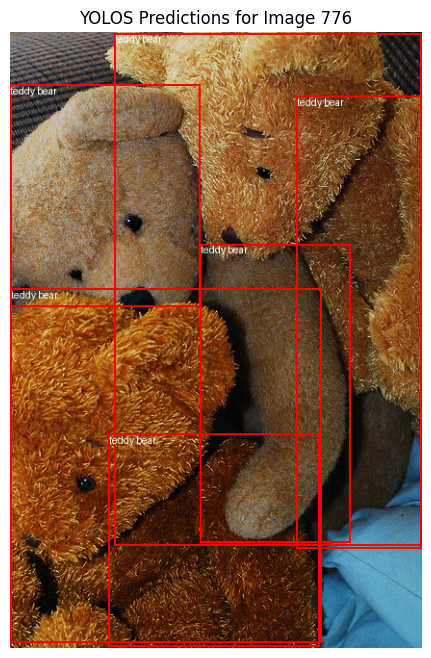

100%|██████████| 630/630 [02:28<00:00,  4.25it/s]


mAP@[0.5:0.95]: tensor(0.3835)
Detailed mAP results: {'map': tensor(0.3835), 'map_50': tensor(0.5587), 'map_75': tensor(0.4093), 'map_small': tensor(0.1199), 'map_medium': tensor(0.3413), 'map_large': tensor(0.5482), 'mar_1': tensor(0.3156), 'mar_10': tensor(0.4548), 'mar_100': tensor(0.4657), 'mar_small': tensor(0.1616), 'mar_medium': tensor(0.4280), 'mar_large': tensor(0.6242), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 1 - Validation mAP Score: 0.3835


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.383485,0.558697,0.409275,0.1199,0.341289,0.548166,0.315623,0.454762,0.465706,0.161608,0.427982,0.624213,-1.0,-1.0


Best model saved with mAP 0.3835 at epoch 1


  0%|          | 1/368 [00:02<16:47,  2.75s/it]

Epoch 2, Batch 0: Loss = 1.0165


  3%|▎         | 11/368 [00:45<23:55,  4.02s/it]

Epoch 2, Batch 10: Loss = 1.1056


  6%|▌         | 21/368 [01:31<25:11,  4.36s/it]

Epoch 2, Batch 20: Loss = 1.2192


  8%|▊         | 31/368 [02:13<21:32,  3.84s/it]

Epoch 2, Batch 30: Loss = 1.1406


 11%|█         | 41/368 [02:55<24:16,  4.45s/it]

Epoch 2, Batch 40: Loss = 0.9201


 14%|█▍        | 51/368 [03:32<18:18,  3.46s/it]

Epoch 2, Batch 50: Loss = 0.9269


 17%|█▋        | 61/368 [04:11<18:15,  3.57s/it]

Epoch 2, Batch 60: Loss = 0.9665


 19%|█▉        | 71/368 [04:45<17:04,  3.45s/it]

Epoch 2, Batch 70: Loss = 1.2261


 22%|██▏       | 81/368 [05:29<18:05,  3.78s/it]

Epoch 2, Batch 80: Loss = 0.9422


 25%|██▍       | 91/368 [06:12<18:52,  4.09s/it]

Epoch 2, Batch 90: Loss = 1.0202


 27%|██▋       | 101/368 [06:57<19:24,  4.36s/it]

Epoch 2, Batch 100: Loss = 0.8957


 30%|███       | 111/368 [07:32<12:48,  2.99s/it]

Epoch 2, Batch 110: Loss = 1.0305


 33%|███▎      | 121/368 [08:10<14:14,  3.46s/it]

Epoch 2, Batch 120: Loss = 0.9766


 36%|███▌      | 131/368 [08:48<14:03,  3.56s/it]

Epoch 2, Batch 130: Loss = 1.1589


 38%|███▊      | 141/368 [09:33<16:49,  4.45s/it]

Epoch 2, Batch 140: Loss = 0.8763


 41%|████      | 151/368 [10:11<14:43,  4.07s/it]

Epoch 2, Batch 150: Loss = 1.1855


 44%|████▍     | 161/368 [10:48<13:08,  3.81s/it]

Epoch 2, Batch 160: Loss = 0.8348


 46%|████▋     | 171/368 [11:30<14:15,  4.34s/it]

Epoch 2, Batch 170: Loss = 1.2897


 49%|████▉     | 181/368 [12:03<10:08,  3.25s/it]

Epoch 2, Batch 180: Loss = 1.2123


 52%|█████▏    | 191/368 [12:45<11:18,  3.83s/it]

Epoch 2, Batch 190: Loss = 0.9288


 55%|█████▍    | 201/368 [13:25<09:17,  3.34s/it]

Epoch 2, Batch 200: Loss = 1.0025


 57%|█████▋    | 211/368 [14:00<09:52,  3.78s/it]

Epoch 2, Batch 210: Loss = 1.0555


 60%|██████    | 221/368 [14:44<10:27,  4.27s/it]

Epoch 2, Batch 220: Loss = 0.9819


 63%|██████▎   | 231/368 [15:29<08:55,  3.91s/it]

Epoch 2, Batch 230: Loss = 1.1314


 65%|██████▌   | 241/368 [16:12<10:23,  4.91s/it]

Epoch 2, Batch 240: Loss = 1.0159


 68%|██████▊   | 251/368 [16:55<08:30,  4.36s/it]

Epoch 2, Batch 250: Loss = 1.0270


 71%|███████   | 261/368 [17:38<06:54,  3.88s/it]

Epoch 2, Batch 260: Loss = 1.0771


 74%|███████▎  | 271/368 [18:15<05:59,  3.71s/it]

Epoch 2, Batch 270: Loss = 0.9605


 76%|███████▋  | 281/368 [18:58<06:21,  4.39s/it]

Epoch 2, Batch 280: Loss = 1.0927


 79%|███████▉  | 291/368 [19:39<05:00,  3.90s/it]

Epoch 2, Batch 290: Loss = 0.9365


 82%|████████▏ | 301/368 [20:22<05:41,  5.09s/it]

Epoch 2, Batch 300: Loss = 0.8818


 85%|████████▍ | 311/368 [21:04<03:49,  4.03s/it]

Epoch 2, Batch 310: Loss = 1.0659


 87%|████████▋ | 321/368 [21:49<03:29,  4.47s/it]

Epoch 2, Batch 320: Loss = 0.9953


 90%|████████▉ | 331/368 [22:32<02:47,  4.52s/it]

Epoch 2, Batch 330: Loss = 0.8370


 93%|█████████▎| 341/368 [23:19<01:55,  4.27s/it]

Epoch 2, Batch 340: Loss = 1.1505


 95%|█████████▌| 351/368 [23:51<00:52,  3.11s/it]

Epoch 2, Batch 350: Loss = 0.8786


 98%|█████████▊| 361/368 [24:31<00:25,  3.71s/it]

Epoch 2, Batch 360: Loss = 0.9058


100%|██████████| 368/368 [24:58<00:00,  4.07s/it]


Epoch 2 Complete. Average train Loss: 4.2847, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.13s/it]


Epoch 2 - Validation Loss: 4.2642


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.938 at location [0.99, 266.89, 323.41, 634.97]
Detected teddy bear with confidence 0.859 at location [197.58, 220.42, 353.16, 530.68]
Detected teddy bear with confidence 0.62 at location [297.82, 66.6, 427.94, 536.56]
Detected teddy bear with confidence 0.967 at location [108.96, 1.43, 427.56, 534.01]
Detected teddy bear with confidence 0.984 at location [0.11, 54.67, 197.8, 285.72]
Detected teddy bear with confidence 0.525 at location [102.89, 417.78, 321.24, 638.76]


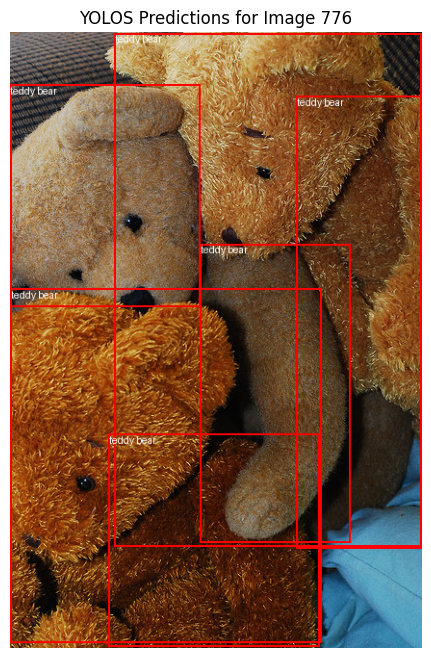

100%|██████████| 630/630 [02:28<00:00,  4.25it/s]


mAP@[0.5:0.95]: tensor(0.3837)
Detailed mAP results: {'map': tensor(0.3837), 'map_50': tensor(0.5588), 'map_75': tensor(0.4095), 'map_small': tensor(0.1199), 'map_medium': tensor(0.3415), 'map_large': tensor(0.5481), 'mar_1': tensor(0.3157), 'mar_10': tensor(0.4547), 'mar_100': tensor(0.4657), 'mar_small': tensor(0.1616), 'mar_medium': tensor(0.4280), 'mar_large': tensor(0.6242), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 2 - Validation mAP Score: 0.3837


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.38365,0.558763,0.409527,0.119881,0.341463,0.548102,0.315681,0.454743,0.465718,0.161637,0.427982,0.624216,-1.0,-1.0


Best model saved with mAP 0.3837 at epoch 2


  0%|          | 1/368 [00:03<20:01,  3.27s/it]

Epoch 3, Batch 0: Loss = 0.7541


  3%|▎         | 11/368 [00:41<24:34,  4.13s/it]

Epoch 3, Batch 10: Loss = 0.9594


  6%|▌         | 21/368 [01:23<25:51,  4.47s/it]

Epoch 3, Batch 20: Loss = 1.0739


  8%|▊         | 31/368 [02:08<24:38,  4.39s/it]

Epoch 3, Batch 30: Loss = 1.1117


 11%|█         | 41/368 [02:46<23:55,  4.39s/it]

Epoch 3, Batch 40: Loss = 0.8412


 14%|█▍        | 51/368 [03:26<21:07,  4.00s/it]

Epoch 3, Batch 50: Loss = 0.9779


 17%|█▋        | 61/368 [04:11<24:51,  4.86s/it]

Epoch 3, Batch 60: Loss = 1.1135


 19%|█▉        | 71/368 [04:51<20:40,  4.18s/it]

Epoch 3, Batch 70: Loss = 0.9736


 22%|██▏       | 81/368 [05:29<20:02,  4.19s/it]

Epoch 3, Batch 80: Loss = 1.1667


 25%|██▍       | 91/368 [06:06<16:19,  3.54s/it]

Epoch 3, Batch 90: Loss = 0.8943


 27%|██▋       | 101/368 [06:49<20:18,  4.57s/it]

Epoch 3, Batch 100: Loss = 1.1287


 30%|███       | 111/368 [07:28<18:39,  4.36s/it]

Epoch 3, Batch 110: Loss = 1.0807


 33%|███▎      | 121/368 [08:03<12:49,  3.12s/it]

Epoch 3, Batch 120: Loss = 1.0481


 36%|███▌      | 131/368 [08:42<16:06,  4.08s/it]

Epoch 3, Batch 130: Loss = 1.1221


 38%|███▊      | 141/368 [09:22<17:03,  4.51s/it]

Epoch 3, Batch 140: Loss = 1.0663


 41%|████      | 151/368 [10:08<17:53,  4.95s/it]

Epoch 3, Batch 150: Loss = 0.8970


 44%|████▍     | 161/368 [10:48<12:55,  3.75s/it]

Epoch 3, Batch 160: Loss = 1.0952


 46%|████▋     | 171/368 [11:28<12:04,  3.68s/it]

Epoch 3, Batch 170: Loss = 0.8877


 49%|████▉     | 181/368 [12:14<13:48,  4.43s/it]

Epoch 3, Batch 180: Loss = 1.1969


 52%|█████▏    | 191/368 [12:52<12:01,  4.08s/it]

Epoch 3, Batch 190: Loss = 1.1051


 55%|█████▍    | 201/368 [13:33<09:03,  3.26s/it]

Epoch 3, Batch 200: Loss = 0.9263


 57%|█████▋    | 211/368 [14:15<10:46,  4.12s/it]

Epoch 3, Batch 210: Loss = 1.1871


 60%|██████    | 221/368 [15:02<12:05,  4.93s/it]

Epoch 3, Batch 220: Loss = 1.2243


 63%|██████▎   | 231/368 [15:42<09:34,  4.19s/it]

Epoch 3, Batch 230: Loss = 0.9808


 65%|██████▌   | 241/368 [16:14<07:04,  3.35s/it]

Epoch 3, Batch 240: Loss = 0.9100


 68%|██████▊   | 251/368 [16:56<07:01,  3.61s/it]

Epoch 3, Batch 250: Loss = 0.9470


 71%|███████   | 261/368 [17:38<08:02,  4.50s/it]

Epoch 3, Batch 260: Loss = 0.7846


 74%|███████▎  | 271/368 [18:23<07:54,  4.89s/it]

Epoch 3, Batch 270: Loss = 0.8627


 76%|███████▋  | 281/368 [18:57<04:31,  3.12s/it]

Epoch 3, Batch 280: Loss = 0.9198


 79%|███████▉  | 291/368 [19:35<04:20,  3.39s/it]

Epoch 3, Batch 290: Loss = 1.0386


 82%|████████▏ | 301/368 [20:15<04:12,  3.76s/it]

Epoch 3, Batch 300: Loss = 0.8728


 85%|████████▍ | 311/368 [20:55<03:39,  3.84s/it]

Epoch 3, Batch 310: Loss = 1.1211


 87%|████████▋ | 321/368 [21:42<03:23,  4.34s/it]

Epoch 3, Batch 320: Loss = 1.0894


 90%|████████▉ | 331/368 [22:22<02:04,  3.36s/it]

Epoch 3, Batch 330: Loss = 1.2919


 93%|█████████▎| 341/368 [22:59<01:42,  3.81s/it]

Epoch 3, Batch 340: Loss = 1.1244


 95%|█████████▌| 351/368 [23:48<01:30,  5.31s/it]

Epoch 3, Batch 350: Loss = 1.1760


 98%|█████████▊| 361/368 [24:30<00:24,  3.57s/it]

Epoch 3, Batch 360: Loss = 1.0340


100%|██████████| 368/368 [24:56<00:00,  4.07s/it]


Epoch 3 Complete. Average train Loss: 4.2935, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 3 - Validation Loss: 4.2448


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.938 at location [0.99, 266.84, 323.4, 634.97]
Detected teddy bear with confidence 0.863 at location [197.59, 220.39, 353.13, 530.72]
Detected teddy bear with confidence 0.624 at location [297.82, 66.63, 427.95, 536.65]
Detected teddy bear with confidence 0.967 at location [108.95, 1.43, 427.56, 534.06]
Detected teddy bear with confidence 0.984 at location [0.1, 54.7, 197.78, 285.78]
Detected teddy bear with confidence 0.531 at location [102.88, 417.72, 321.24, 638.76]


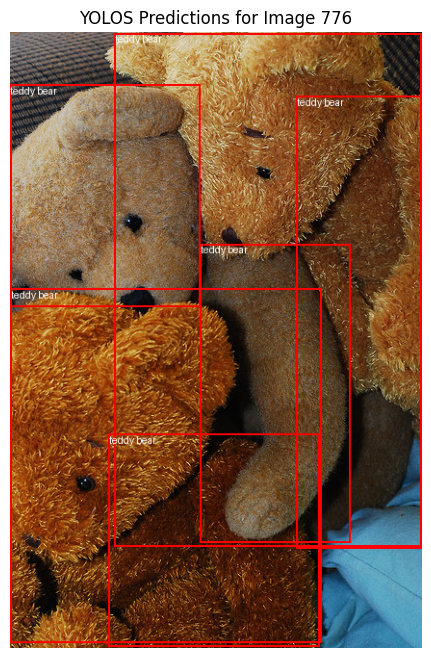

100%|██████████| 630/630 [02:29<00:00,  4.23it/s]


mAP@[0.5:0.95]: tensor(0.3850)
Detailed mAP results: {'map': tensor(0.3850), 'map_50': tensor(0.5605), 'map_75': tensor(0.4112), 'map_small': tensor(0.1222), 'map_medium': tensor(0.3411), 'map_large': tensor(0.5497), 'mar_1': tensor(0.3159), 'mar_10': tensor(0.4569), 'mar_100': tensor(0.4680), 'mar_small': tensor(0.1678), 'mar_medium': tensor(0.4294), 'mar_large': tensor(0.6260), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 3 - Validation mAP Score: 0.3850


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.384982,0.560509,0.411226,0.122208,0.34107,0.549698,0.315919,0.456904,0.468008,0.16781,0.429415,0.626037,-1.0,-1.0


Best model saved with mAP 0.3850 at epoch 3


  0%|          | 1/368 [00:05<32:21,  5.29s/it]

Epoch 4, Batch 0: Loss = 1.2875


  3%|▎         | 11/368 [00:53<28:24,  4.77s/it]

Epoch 4, Batch 10: Loss = 1.1153


  6%|▌         | 21/368 [01:33<24:05,  4.17s/it]

Epoch 4, Batch 20: Loss = 1.0526


  8%|▊         | 31/368 [02:11<20:33,  3.66s/it]

Epoch 4, Batch 30: Loss = 1.0591


 11%|█         | 41/368 [02:52<22:08,  4.06s/it]

Epoch 4, Batch 40: Loss = 1.3256


 14%|█▍        | 51/368 [03:34<21:39,  4.10s/it]

Epoch 4, Batch 50: Loss = 1.1992


 17%|█▋        | 61/368 [04:18<25:50,  5.05s/it]

Epoch 4, Batch 60: Loss = 0.8797


 19%|█▉        | 71/368 [04:52<16:09,  3.26s/it]

Epoch 4, Batch 70: Loss = 0.9341


 22%|██▏       | 81/368 [05:29<17:20,  3.63s/it]

Epoch 4, Batch 80: Loss = 0.9427


 25%|██▍       | 91/368 [06:13<20:30,  4.44s/it]

Epoch 4, Batch 90: Loss = 0.9661


 27%|██▋       | 101/368 [06:58<22:21,  5.02s/it]

Epoch 4, Batch 100: Loss = 1.1640


 30%|███       | 111/368 [07:36<16:39,  3.89s/it]

Epoch 4, Batch 110: Loss = 1.0039


 33%|███▎      | 121/368 [08:21<15:29,  3.76s/it]

Epoch 4, Batch 120: Loss = 1.1240


 36%|███▌      | 131/368 [09:07<18:29,  4.68s/it]

Epoch 4, Batch 130: Loss = 0.9743


 38%|███▊      | 141/368 [09:50<15:15,  4.03s/it]

Epoch 4, Batch 140: Loss = 1.1438


 41%|████      | 151/368 [10:43<17:39,  4.88s/it]

Epoch 4, Batch 150: Loss = 1.0015


 44%|████▍     | 161/368 [11:29<15:04,  4.37s/it]

Epoch 4, Batch 160: Loss = 1.0558


 46%|████▋     | 171/368 [12:12<14:39,  4.47s/it]

Epoch 4, Batch 170: Loss = 1.0121


 49%|████▉     | 181/368 [12:51<14:07,  4.53s/it]

Epoch 4, Batch 180: Loss = 1.0985


 52%|█████▏    | 191/368 [13:31<10:26,  3.54s/it]

Epoch 4, Batch 190: Loss = 0.9886


 55%|█████▍    | 201/368 [14:13<11:53,  4.27s/it]

Epoch 4, Batch 200: Loss = 1.0486


 57%|█████▋    | 211/368 [14:55<11:31,  4.41s/it]

Epoch 4, Batch 210: Loss = 0.9293


 60%|██████    | 221/368 [15:45<10:50,  4.43s/it]

Epoch 4, Batch 220: Loss = 1.1838


 63%|██████▎   | 231/368 [16:20<08:02,  3.52s/it]

Epoch 4, Batch 230: Loss = 0.8870


 65%|██████▌   | 241/368 [17:01<08:33,  4.05s/it]

Epoch 4, Batch 240: Loss = 1.0965


 68%|██████▊   | 251/368 [17:35<06:06,  3.13s/it]

Epoch 4, Batch 250: Loss = 1.2778


 71%|███████   | 261/368 [18:21<07:32,  4.23s/it]

Epoch 4, Batch 260: Loss = 0.9736


 74%|███████▎  | 271/368 [19:03<07:14,  4.48s/it]

Epoch 4, Batch 270: Loss = 1.0981


 76%|███████▋  | 281/368 [19:48<05:52,  4.05s/it]

Epoch 4, Batch 280: Loss = 1.0927


 79%|███████▉  | 291/368 [20:25<04:19,  3.37s/it]

Epoch 4, Batch 290: Loss = 1.1542


 82%|████████▏ | 301/368 [21:02<03:31,  3.16s/it]

Epoch 4, Batch 300: Loss = 0.9293


 85%|████████▍ | 311/368 [21:44<03:54,  4.12s/it]

Epoch 4, Batch 310: Loss = 1.1706


 87%|████████▋ | 321/368 [22:24<03:27,  4.42s/it]

Epoch 4, Batch 320: Loss = 0.9873


 90%|████████▉ | 331/368 [23:11<03:15,  5.29s/it]

Epoch 4, Batch 330: Loss = 0.9087


 93%|█████████▎| 341/368 [23:48<01:42,  3.81s/it]

Epoch 4, Batch 340: Loss = 0.9430


 95%|█████████▌| 351/368 [24:30<01:07,  3.99s/it]

Epoch 4, Batch 350: Loss = 1.2744


 98%|█████████▊| 361/368 [25:13<00:32,  4.63s/it]

Epoch 4, Batch 360: Loss = 1.2542


100%|██████████| 368/368 [25:32<00:00,  4.17s/it]


Epoch 4 Complete. Average train Loss: 4.2510, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 4 - Validation Loss: 4.2192


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.99, 266.77, 323.38, 634.98]
Detected teddy bear with confidence 0.869 at location [197.62, 220.35, 353.09, 530.77]
Detected teddy bear with confidence 0.629 at location [297.84, 66.67, 427.95, 536.75]
Detected teddy bear with confidence 0.967 at location [108.96, 1.43, 427.56, 534.11]
Detected teddy bear with confidence 0.984 at location [0.1, 54.73, 197.76, 285.87]
Detected teddy bear with confidence 0.538 at location [102.87, 417.64, 321.24, 638.76]


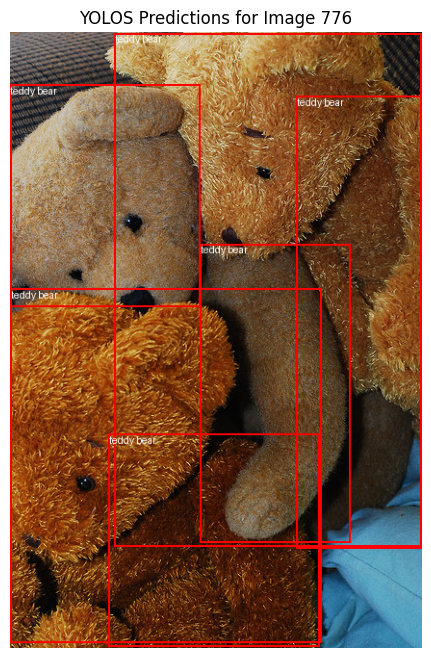

100%|██████████| 630/630 [02:28<00:00,  4.23it/s]


mAP@[0.5:0.95]: tensor(0.3857)
Detailed mAP results: {'map': tensor(0.3857), 'map_50': tensor(0.5616), 'map_75': tensor(0.4113), 'map_small': tensor(0.1232), 'map_medium': tensor(0.3404), 'map_large': tensor(0.5503), 'mar_1': tensor(0.3166), 'mar_10': tensor(0.4580), 'mar_100': tensor(0.4694), 'mar_small': tensor(0.1697), 'mar_medium': tensor(0.4298), 'mar_large': tensor(0.6274), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 4 - Validation mAP Score: 0.3857


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.385665,0.561643,0.411289,0.123191,0.340434,0.550254,0.316647,0.458012,0.46936,0.169749,0.429806,0.627397,-1.0,-1.0


Best model saved with mAP 0.3857 at epoch 4


  0%|          | 1/368 [00:03<20:15,  3.31s/it]

Epoch 5, Batch 0: Loss = 1.1177


  3%|▎         | 11/368 [00:49<28:32,  4.80s/it]

Epoch 5, Batch 10: Loss = 0.8402


  6%|▌         | 21/368 [01:34<24:39,  4.26s/it]

Epoch 5, Batch 20: Loss = 1.0283


  8%|▊         | 31/368 [02:06<17:48,  3.17s/it]

Epoch 5, Batch 30: Loss = 1.2507


 11%|█         | 41/368 [02:43<22:01,  4.04s/it]

Epoch 5, Batch 40: Loss = 0.7565


 14%|█▍        | 51/368 [03:26<20:46,  3.93s/it]

Epoch 5, Batch 50: Loss = 1.0764


 17%|█▋        | 61/368 [04:03<20:49,  4.07s/it]

Epoch 5, Batch 60: Loss = 0.9979


 19%|█▉        | 71/368 [04:42<16:36,  3.36s/it]

Epoch 5, Batch 70: Loss = 1.0390


 22%|██▏       | 81/368 [05:28<23:51,  4.99s/it]

Epoch 5, Batch 80: Loss = 1.1329


 25%|██▍       | 91/368 [06:06<19:30,  4.23s/it]

Epoch 5, Batch 90: Loss = 1.0367


 27%|██▋       | 101/368 [06:46<19:39,  4.42s/it]

Epoch 5, Batch 100: Loss = 1.0109


 30%|███       | 111/368 [07:31<16:51,  3.94s/it]

Epoch 5, Batch 110: Loss = 1.3975


 33%|███▎      | 121/368 [08:16<20:50,  5.06s/it]

Epoch 5, Batch 120: Loss = 0.7405


 36%|███▌      | 131/368 [09:02<18:57,  4.80s/it]

Epoch 5, Batch 130: Loss = 0.8601


 38%|███▊      | 141/368 [09:41<14:05,  3.72s/it]

Epoch 5, Batch 140: Loss = 1.4717


 41%|████      | 151/368 [10:25<15:17,  4.23s/it]

Epoch 5, Batch 150: Loss = 1.2993


 44%|████▍     | 161/368 [11:06<13:38,  3.96s/it]

Epoch 5, Batch 160: Loss = 1.2490


 46%|████▋     | 171/368 [11:46<11:28,  3.50s/it]

Epoch 5, Batch 170: Loss = 1.1634


 49%|████▉     | 181/368 [12:23<13:20,  4.28s/it]

Epoch 5, Batch 180: Loss = 0.9361


 52%|█████▏    | 191/368 [13:06<10:34,  3.59s/it]

Epoch 5, Batch 190: Loss = 1.0431


 55%|█████▍    | 201/368 [13:42<10:02,  3.61s/it]

Epoch 5, Batch 200: Loss = 1.2662


 57%|█████▋    | 211/368 [14:19<10:17,  3.93s/it]

Epoch 5, Batch 210: Loss = 0.8023


 60%|██████    | 221/368 [14:58<10:24,  4.24s/it]

Epoch 5, Batch 220: Loss = 1.2205


 63%|██████▎   | 231/368 [15:38<09:26,  4.14s/it]

Epoch 5, Batch 230: Loss = 0.9999


 65%|██████▌   | 241/368 [16:12<06:54,  3.26s/it]

Epoch 5, Batch 240: Loss = 1.1925


 68%|██████▊   | 251/368 [17:00<10:00,  5.14s/it]

Epoch 5, Batch 250: Loss = 1.3381


 71%|███████   | 261/368 [17:42<07:16,  4.08s/it]

Epoch 5, Batch 260: Loss = 1.3348


 74%|███████▎  | 271/368 [18:28<07:25,  4.59s/it]

Epoch 5, Batch 270: Loss = 1.3166


 76%|███████▋  | 281/368 [19:11<06:47,  4.68s/it]

Epoch 5, Batch 280: Loss = 0.9590


 79%|███████▉  | 291/368 [19:55<05:59,  4.68s/it]

Epoch 5, Batch 290: Loss = 1.1610


 82%|████████▏ | 301/368 [20:36<05:05,  4.56s/it]

Epoch 5, Batch 300: Loss = 0.8468


 85%|████████▍ | 311/368 [21:22<04:08,  4.36s/it]

Epoch 5, Batch 310: Loss = 1.5448


 87%|████████▋ | 321/368 [22:05<03:36,  4.61s/it]

Epoch 5, Batch 320: Loss = 0.9171


 90%|████████▉ | 331/368 [22:50<02:50,  4.62s/it]

Epoch 5, Batch 330: Loss = 1.1131


 93%|█████████▎| 341/368 [23:33<02:01,  4.52s/it]

Epoch 5, Batch 340: Loss = 0.9511


 95%|█████████▌| 351/368 [24:10<00:57,  3.37s/it]

Epoch 5, Batch 350: Loss = 1.1796


 98%|█████████▊| 361/368 [24:47<00:26,  3.72s/it]

Epoch 5, Batch 360: Loss = 0.9638


100%|██████████| 368/368 [25:09<00:00,  4.10s/it]


Epoch 5 Complete. Average train Loss: 4.2463, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 5 - Validation Loss: 4.2002


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.98, 266.72, 323.37, 634.98]
Detected teddy bear with confidence 0.873 at location [197.64, 220.31, 353.06, 530.81]
Detected teddy bear with confidence 0.633 at location [297.85, 66.7, 427.95, 536.82]
Detected teddy bear with confidence 0.967 at location [108.96, 1.43, 427.56, 534.15]
Detected teddy bear with confidence 0.984 at location [0.09, 54.76, 197.74, 285.93]
Detected teddy bear with confidence 0.543 at location [102.86, 417.59, 321.24, 638.75]


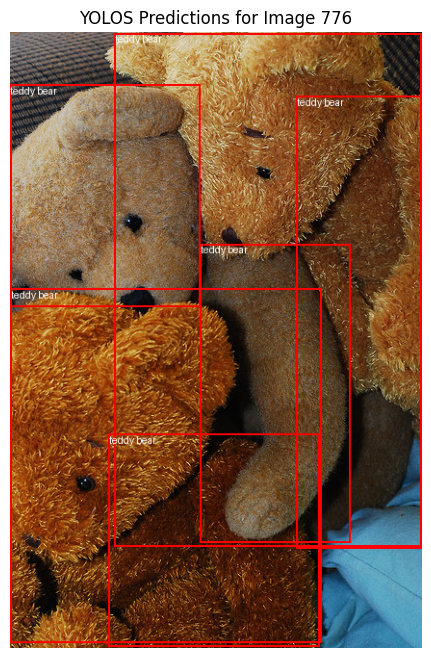

100%|██████████| 630/630 [02:28<00:00,  4.23it/s]


mAP@[0.5:0.95]: tensor(0.3860)
Detailed mAP results: {'map': tensor(0.3860), 'map_50': tensor(0.5610), 'map_75': tensor(0.4123), 'map_small': tensor(0.1240), 'map_medium': tensor(0.3405), 'map_large': tensor(0.5504), 'mar_1': tensor(0.3167), 'mar_10': tensor(0.4588), 'mar_100': tensor(0.4702), 'mar_small': tensor(0.1707), 'mar_medium': tensor(0.4310), 'mar_large': tensor(0.6280), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 5 - Validation mAP Score: 0.3860


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.38599,0.560967,0.412288,0.124005,0.340543,0.550434,0.316743,0.458784,0.470176,0.170719,0.431023,0.627998,-1.0,-1.0


Best model saved with mAP 0.3860 at epoch 5


  0%|          | 1/368 [00:04<26:44,  4.37s/it]

Epoch 6, Batch 0: Loss = 1.2253


  3%|▎         | 11/368 [00:41<25:32,  4.29s/it]

Epoch 6, Batch 10: Loss = 1.0908


  6%|▌         | 21/368 [01:20<20:45,  3.59s/it]

Epoch 6, Batch 20: Loss = 1.0273


  8%|▊         | 31/368 [01:56<18:10,  3.24s/it]

Epoch 6, Batch 30: Loss = 1.3802


 11%|█         | 41/368 [02:39<23:42,  4.35s/it]

Epoch 6, Batch 40: Loss = 1.0540


 14%|█▍        | 51/368 [03:24<26:04,  4.94s/it]

Epoch 6, Batch 50: Loss = 1.0121


 17%|█▋        | 61/368 [04:05<21:57,  4.29s/it]

Epoch 6, Batch 60: Loss = 1.0801


 19%|█▉        | 71/368 [04:48<18:42,  3.78s/it]

Epoch 6, Batch 70: Loss = 1.0664


 22%|██▏       | 81/368 [05:28<16:40,  3.49s/it]

Epoch 6, Batch 80: Loss = 1.3067


 25%|██▍       | 91/368 [06:03<15:07,  3.28s/it]

Epoch 6, Batch 90: Loss = 1.0050


 27%|██▋       | 101/368 [06:47<20:19,  4.57s/it]

Epoch 6, Batch 100: Loss = 1.0829


 30%|███       | 111/368 [07:26<16:16,  3.80s/it]

Epoch 6, Batch 110: Loss = 0.8939


 33%|███▎      | 121/368 [08:12<18:38,  4.53s/it]

Epoch 6, Batch 120: Loss = 1.0264


 36%|███▌      | 131/368 [08:49<16:21,  4.14s/it]

Epoch 6, Batch 130: Loss = 1.1179


 38%|███▊      | 141/368 [09:25<11:33,  3.05s/it]

Epoch 6, Batch 140: Loss = 1.2432


 41%|████      | 151/368 [10:01<12:39,  3.50s/it]

Epoch 6, Batch 150: Loss = 1.0028


 44%|████▍     | 161/368 [10:30<10:05,  2.92s/it]

Epoch 6, Batch 160: Loss = 1.3304


 46%|████▋     | 171/368 [11:10<13:28,  4.10s/it]

Epoch 6, Batch 170: Loss = 1.2139


 49%|████▉     | 181/368 [11:52<12:17,  3.95s/it]

Epoch 6, Batch 180: Loss = 0.8094


 52%|█████▏    | 191/368 [12:37<12:19,  4.18s/it]

Epoch 6, Batch 190: Loss = 0.8907


 55%|█████▍    | 201/368 [13:26<12:36,  4.53s/it]

Epoch 6, Batch 200: Loss = 1.3270


 57%|█████▋    | 211/368 [14:05<10:23,  3.97s/it]

Epoch 6, Batch 210: Loss = 0.8706


 60%|██████    | 221/368 [14:46<10:38,  4.34s/it]

Epoch 6, Batch 220: Loss = 0.9454


 63%|██████▎   | 231/368 [15:20<07:27,  3.26s/it]

Epoch 6, Batch 230: Loss = 1.4948


 65%|██████▌   | 241/368 [16:03<08:32,  4.04s/it]

Epoch 6, Batch 240: Loss = 0.9418


 68%|██████▊   | 251/368 [16:38<06:43,  3.44s/it]

Epoch 6, Batch 250: Loss = 1.1253


 71%|███████   | 261/368 [17:22<08:04,  4.52s/it]

Epoch 6, Batch 260: Loss = 1.0958


 74%|███████▎  | 271/368 [18:03<05:59,  3.71s/it]

Epoch 6, Batch 270: Loss = 1.2813


 76%|███████▋  | 281/368 [18:42<06:09,  4.25s/it]

Epoch 6, Batch 280: Loss = 1.0427


 79%|███████▉  | 291/368 [19:20<04:48,  3.74s/it]

Epoch 6, Batch 290: Loss = 0.9777


 82%|████████▏ | 301/368 [20:07<05:25,  4.86s/it]

Epoch 6, Batch 300: Loss = 0.8556


 85%|████████▍ | 311/368 [20:46<03:05,  3.26s/it]

Epoch 6, Batch 310: Loss = 0.9498


 87%|████████▋ | 321/368 [21:25<02:23,  3.06s/it]

Epoch 6, Batch 320: Loss = 0.9754


 90%|████████▉ | 331/368 [22:11<03:07,  5.07s/it]

Epoch 6, Batch 330: Loss = 0.9707


 93%|█████████▎| 341/368 [22:58<01:59,  4.42s/it]

Epoch 6, Batch 340: Loss = 1.0873


 95%|█████████▌| 351/368 [23:44<01:08,  4.01s/it]

Epoch 6, Batch 350: Loss = 1.1113


 98%|█████████▊| 361/368 [24:25<00:30,  4.30s/it]

Epoch 6, Batch 360: Loss = 0.9723


100%|██████████| 368/368 [24:49<00:00,  4.05s/it]


Epoch 6 Complete. Average train Loss: 4.2219, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 6 - Validation Loss: 4.1934


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.98, 266.7, 323.37, 634.99]
Detected teddy bear with confidence 0.874 at location [197.65, 220.3, 353.05, 530.82]
Detected teddy bear with confidence 0.635 at location [297.85, 66.71, 427.95, 536.84]
Detected teddy bear with confidence 0.967 at location [108.97, 1.43, 427.56, 534.17]
Detected teddy bear with confidence 0.984 at location [0.09, 54.77, 197.74, 285.95]
Detected teddy bear with confidence 0.545 at location [102.86, 417.57, 321.24, 638.75]


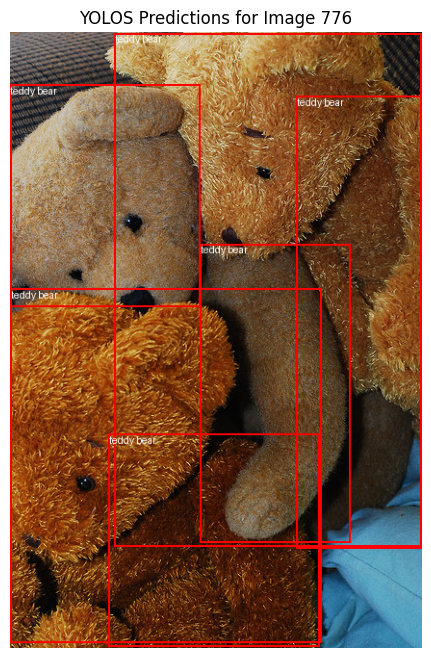

100%|██████████| 630/630 [02:28<00:00,  4.24it/s]


mAP@[0.5:0.95]: tensor(0.3864)
Detailed mAP results: {'map': tensor(0.3864), 'map_50': tensor(0.5613), 'map_75': tensor(0.4125), 'map_small': tensor(0.1289), 'map_medium': tensor(0.3406), 'map_large': tensor(0.5507), 'mar_1': tensor(0.3171), 'mar_10': tensor(0.4591), 'mar_100': tensor(0.4707), 'mar_small': tensor(0.1801), 'mar_medium': tensor(0.4311), 'mar_large': tensor(0.6286), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 6 - Validation mAP Score: 0.3864


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.3864,0.561346,0.412459,0.128855,0.340564,0.550713,0.317095,0.459107,0.470715,0.180076,0.43113,0.628567,-1.0,-1.0


Best model saved with mAP 0.3864 at epoch 6


  0%|          | 1/368 [00:04<27:26,  4.49s/it]

Epoch 7, Batch 0: Loss = 1.0260


  3%|▎         | 11/368 [00:48<28:04,  4.72s/it]

Epoch 7, Batch 10: Loss = 1.0048


  6%|▌         | 21/368 [01:31<24:35,  4.25s/it]

Epoch 7, Batch 20: Loss = 0.9677


  8%|▊         | 31/368 [02:12<19:59,  3.56s/it]

Epoch 7, Batch 30: Loss = 1.2564


 11%|█         | 41/368 [02:50<22:07,  4.06s/it]

Epoch 7, Batch 40: Loss = 0.9205


 14%|█▍        | 51/368 [03:27<17:53,  3.38s/it]

Epoch 7, Batch 50: Loss = 1.1285


 17%|█▋        | 61/368 [04:07<18:49,  3.68s/it]

Epoch 7, Batch 60: Loss = 1.0142


 19%|█▉        | 71/368 [04:42<16:31,  3.34s/it]

Epoch 7, Batch 70: Loss = 0.8897


 22%|██▏       | 81/368 [05:23<18:02,  3.77s/it]

Epoch 7, Batch 80: Loss = 1.1820


 25%|██▍       | 91/368 [05:57<14:36,  3.17s/it]

Epoch 7, Batch 90: Loss = 1.1037


 27%|██▋       | 101/368 [06:35<19:19,  4.34s/it]

Epoch 7, Batch 100: Loss = 1.0060


 30%|███       | 111/368 [07:23<21:20,  4.98s/it]

Epoch 7, Batch 110: Loss = 1.1846


 33%|███▎      | 121/368 [08:03<15:08,  3.68s/it]

Epoch 7, Batch 120: Loss = 1.1222


 36%|███▌      | 131/368 [08:42<14:20,  3.63s/it]

Epoch 7, Batch 130: Loss = 1.1493


 38%|███▊      | 141/368 [09:20<13:18,  3.52s/it]

Epoch 7, Batch 140: Loss = 0.9887


 41%|████      | 151/368 [10:00<16:07,  4.46s/it]

Epoch 7, Batch 150: Loss = 1.1324


 44%|████▍     | 161/368 [10:44<12:55,  3.75s/it]

Epoch 7, Batch 160: Loss = 0.9502


 46%|████▋     | 171/368 [11:21<11:18,  3.45s/it]

Epoch 7, Batch 170: Loss = 1.0034


 49%|████▉     | 181/368 [12:03<16:02,  5.15s/it]

Epoch 7, Batch 180: Loss = 1.0274


 52%|█████▏    | 191/368 [12:43<11:05,  3.76s/it]

Epoch 7, Batch 190: Loss = 1.0883


 55%|█████▍    | 201/368 [13:14<08:15,  2.97s/it]

Epoch 7, Batch 200: Loss = 0.9837


 57%|█████▋    | 211/368 [13:45<07:15,  2.77s/it]

Epoch 7, Batch 210: Loss = 1.0181


 60%|██████    | 221/368 [14:33<11:37,  4.75s/it]

Epoch 7, Batch 220: Loss = 1.1002


 63%|██████▎   | 231/368 [15:15<10:55,  4.79s/it]

Epoch 7, Batch 230: Loss = 0.9640


 65%|██████▌   | 241/368 [15:53<07:28,  3.53s/it]

Epoch 7, Batch 240: Loss = 1.0826


 68%|██████▊   | 251/368 [16:38<08:56,  4.58s/it]

Epoch 7, Batch 250: Loss = 1.1014


 71%|███████   | 261/368 [17:22<08:07,  4.55s/it]

Epoch 7, Batch 260: Loss = 0.9910


 74%|███████▎  | 271/368 [18:02<06:47,  4.20s/it]

Epoch 7, Batch 270: Loss = 1.0971


 76%|███████▋  | 281/368 [18:43<06:11,  4.27s/it]

Epoch 7, Batch 280: Loss = 0.8893


 79%|███████▉  | 291/368 [19:27<05:59,  4.67s/it]

Epoch 7, Batch 290: Loss = 0.8125


 82%|████████▏ | 301/368 [20:02<03:44,  3.35s/it]

Epoch 7, Batch 300: Loss = 1.1721


 85%|████████▍ | 311/368 [20:39<04:01,  4.24s/it]

Epoch 7, Batch 310: Loss = 1.0181


 87%|████████▋ | 321/368 [21:19<03:01,  3.86s/it]

Epoch 7, Batch 320: Loss = 1.0936


 90%|████████▉ | 331/368 [22:05<02:40,  4.35s/it]

Epoch 7, Batch 330: Loss = 1.0739


 93%|█████████▎| 341/368 [22:47<01:45,  3.91s/it]

Epoch 7, Batch 340: Loss = 1.0746


 95%|█████████▌| 351/368 [23:27<01:07,  3.97s/it]

Epoch 7, Batch 350: Loss = 1.5074


 98%|█████████▊| 361/368 [24:00<00:21,  3.03s/it]

Epoch 7, Batch 360: Loss = 1.0851


100%|██████████| 368/368 [24:28<00:00,  3.99s/it]


Epoch 7 Complete. Average train Loss: 4.2071, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 7 - Validation Loss: 4.1473


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.94 at location [0.98, 266.56, 323.34, 635.0]
Detected teddy bear with confidence 0.51 at location [303.64, 65.62, 427.7, 413.77]
Detected teddy bear with confidence 0.883 at location [197.71, 220.21, 352.98, 530.91]
Detected teddy bear with confidence 0.644 at location [297.86, 66.77, 427.96, 537.0]
Detected teddy bear with confidence 0.967 at location [108.98, 1.43, 427.55, 534.26]
Detected teddy bear with confidence 0.984 at location [0.08, 54.83, 197.69, 286.11]
Detected teddy bear with confidence 0.559 at location [102.84, 417.46, 321.24, 638.74]


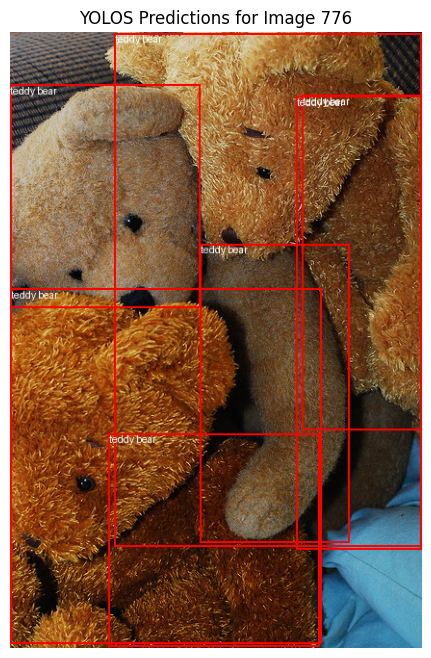

100%|██████████| 630/630 [02:29<00:00,  4.23it/s]


mAP@[0.5:0.95]: tensor(0.3866)
Detailed mAP results: {'map': tensor(0.3866), 'map_50': tensor(0.5615), 'map_75': tensor(0.4136), 'map_small': tensor(0.1294), 'map_medium': tensor(0.3401), 'map_large': tensor(0.5520), 'mar_1': tensor(0.3171), 'mar_10': tensor(0.4593), 'mar_100': tensor(0.4712), 'mar_small': tensor(0.1811), 'mar_medium': tensor(0.4307), 'mar_large': tensor(0.6313), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 7 - Validation mAP Score: 0.3866


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.386587,0.561496,0.413551,0.129407,0.340123,0.551959,0.317092,0.459259,0.47124,0.181104,0.430713,0.631341,-1.0,-1.0


Best model saved with mAP 0.3866 at epoch 7


  0%|          | 1/368 [00:02<16:47,  2.74s/it]

Epoch 8, Batch 0: Loss = 0.8329


  3%|▎         | 11/368 [00:38<22:24,  3.77s/it]

Epoch 8, Batch 10: Loss = 1.0399


  6%|▌         | 21/368 [01:15<20:06,  3.48s/it]

Epoch 8, Batch 20: Loss = 0.9820


  8%|▊         | 31/368 [01:47<16:49,  3.00s/it]

Epoch 8, Batch 30: Loss = 0.9817


 11%|█         | 41/368 [02:31<24:51,  4.56s/it]

Epoch 8, Batch 40: Loss = 0.9854


 14%|█▍        | 51/368 [03:12<24:56,  4.72s/it]

Epoch 8, Batch 50: Loss = 0.9418


 17%|█▋        | 61/368 [03:49<18:10,  3.55s/it]

Epoch 8, Batch 60: Loss = 1.0111


 19%|█▉        | 71/368 [04:26<21:35,  4.36s/it]

Epoch 8, Batch 70: Loss = 0.9994


 22%|██▏       | 81/368 [05:15<25:38,  5.36s/it]

Epoch 8, Batch 80: Loss = 0.7932


 25%|██▍       | 91/368 [06:03<21:19,  4.62s/it]

Epoch 8, Batch 90: Loss = 0.9966


 27%|██▋       | 101/368 [06:41<16:36,  3.73s/it]

Epoch 8, Batch 100: Loss = 0.9916


 30%|███       | 111/368 [07:26<16:08,  3.77s/it]

Epoch 8, Batch 110: Loss = 0.9143


 33%|███▎      | 121/368 [08:12<17:23,  4.23s/it]

Epoch 8, Batch 120: Loss = 1.3618


 36%|███▌      | 131/368 [08:52<17:06,  4.33s/it]

Epoch 8, Batch 130: Loss = 0.9815


 38%|███▊      | 141/368 [09:24<12:02,  3.18s/it]

Epoch 8, Batch 140: Loss = 1.0004


 41%|████      | 151/368 [10:04<13:29,  3.73s/it]

Epoch 8, Batch 150: Loss = 0.8910


 44%|████▍     | 161/368 [10:48<15:32,  4.51s/it]

Epoch 8, Batch 160: Loss = 0.9680


 46%|████▋     | 171/368 [11:35<16:53,  5.14s/it]

Epoch 8, Batch 170: Loss = 1.2252


 49%|████▉     | 181/368 [12:16<12:22,  3.97s/it]

Epoch 8, Batch 180: Loss = 0.8489


 52%|█████▏    | 191/368 [12:58<13:41,  4.64s/it]

Epoch 8, Batch 190: Loss = 0.9370


 55%|█████▍    | 201/368 [13:41<11:49,  4.25s/it]

Epoch 8, Batch 200: Loss = 0.8631


 57%|█████▋    | 211/368 [14:25<11:27,  4.38s/it]

Epoch 8, Batch 210: Loss = 0.9686


 60%|██████    | 221/368 [15:07<09:07,  3.73s/it]

Epoch 8, Batch 220: Loss = 1.0809


 63%|██████▎   | 231/368 [15:51<11:26,  5.01s/it]

Epoch 8, Batch 230: Loss = 0.9202


 65%|██████▌   | 241/368 [16:25<06:52,  3.25s/it]

Epoch 8, Batch 240: Loss = 0.8810


 68%|██████▊   | 251/368 [17:10<07:49,  4.02s/it]

Epoch 8, Batch 250: Loss = 1.1623


 71%|███████   | 261/368 [17:49<06:29,  3.64s/it]

Epoch 8, Batch 260: Loss = 1.0025


 74%|███████▎  | 271/368 [18:24<05:13,  3.23s/it]

Epoch 8, Batch 270: Loss = 1.3058


 76%|███████▋  | 281/368 [19:08<05:43,  3.95s/it]

Epoch 8, Batch 280: Loss = 0.9911


 79%|███████▉  | 291/368 [19:40<03:44,  2.92s/it]

Epoch 8, Batch 290: Loss = 0.8470


 82%|████████▏ | 301/368 [20:28<05:27,  4.89s/it]

Epoch 8, Batch 300: Loss = 1.1312


 85%|████████▍ | 311/368 [21:13<03:51,  4.06s/it]

Epoch 8, Batch 310: Loss = 1.0930


 87%|████████▋ | 321/368 [21:49<02:31,  3.23s/it]

Epoch 8, Batch 320: Loss = 0.8938


 90%|████████▉ | 331/368 [22:35<02:48,  4.54s/it]

Epoch 8, Batch 330: Loss = 1.0831


 93%|█████████▎| 341/368 [23:14<01:47,  4.00s/it]

Epoch 8, Batch 340: Loss = 1.0255


 95%|█████████▌| 351/368 [23:55<01:12,  4.27s/it]

Epoch 8, Batch 350: Loss = 1.1716


 98%|█████████▊| 361/368 [24:33<00:25,  3.68s/it]

Epoch 8, Batch 360: Loss = 1.1353


100%|██████████| 368/368 [24:58<00:00,  4.07s/it]


Epoch 8 Complete. Average train Loss: 4.1562, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 8 - Validation Loss: 4.0851


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.941 at location [0.97, 266.38, 323.3, 635.02]
Detected teddy bear with confidence 0.533 at location [303.65, 65.73, 427.7, 414.0]
Detected teddy bear with confidence 0.894 at location [197.8, 220.09, 352.89, 531.02]
Detected teddy bear with confidence 0.655 at location [297.88, 66.87, 427.97, 537.21]
Detected teddy bear with confidence 0.967 at location [108.99, 1.43, 427.55, 534.37]
Detected teddy bear with confidence 0.985 at location [0.07, 54.91, 197.63, 286.33]
Detected teddy bear with confidence 0.577 at location [102.82, 417.29, 321.25, 638.73]


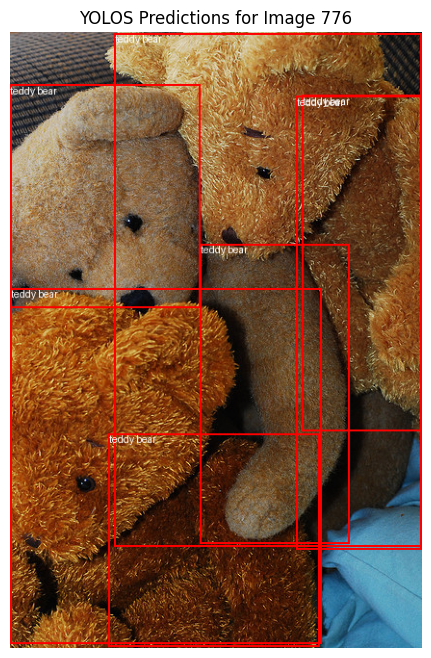

100%|██████████| 630/630 [02:29<00:00,  4.23it/s]


mAP@[0.5:0.95]: tensor(0.3881)
Detailed mAP results: {'map': tensor(0.3881), 'map_50': tensor(0.5644), 'map_75': tensor(0.4171), 'map_small': tensor(0.1308), 'map_medium': tensor(0.3436), 'map_large': tensor(0.5535), 'mar_1': tensor(0.3159), 'mar_10': tensor(0.4614), 'mar_100': tensor(0.4738), 'mar_small': tensor(0.1836), 'mar_medium': tensor(0.4396), 'mar_large': tensor(0.6337), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 8 - Validation mAP Score: 0.3881


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.388068,0.564425,0.417069,0.130782,0.343617,0.553453,0.315859,0.461387,0.473844,0.183619,0.43964,0.633681,-1.0,-1.0


Best model saved with mAP 0.3881 at epoch 8


  0%|          | 1/368 [00:04<30:22,  4.97s/it]

Epoch 9, Batch 0: Loss = 1.1058


  3%|▎         | 11/368 [00:43<20:59,  3.53s/it]

Epoch 9, Batch 10: Loss = 0.9192


  6%|▌         | 21/368 [01:26<26:24,  4.57s/it]

Epoch 9, Batch 20: Loss = 0.9720


  8%|▊         | 31/368 [02:10<24:13,  4.31s/it]

Epoch 9, Batch 30: Loss = 0.8008


 11%|█         | 41/368 [02:56<26:39,  4.89s/it]

Epoch 9, Batch 40: Loss = 0.9767


 14%|█▍        | 51/368 [03:38<23:35,  4.47s/it]

Epoch 9, Batch 50: Loss = 0.9468


 17%|█▋        | 61/368 [04:19<19:56,  3.90s/it]

Epoch 9, Batch 60: Loss = 1.2340


 19%|█▉        | 71/368 [04:59<20:14,  4.09s/it]

Epoch 9, Batch 70: Loss = 1.1837


 22%|██▏       | 81/368 [05:49<24:09,  5.05s/it]

Epoch 9, Batch 80: Loss = 0.9458


 25%|██▍       | 91/368 [06:33<21:57,  4.76s/it]

Epoch 9, Batch 90: Loss = 0.9521


 27%|██▋       | 101/368 [07:16<21:16,  4.78s/it]

Epoch 9, Batch 100: Loss = 0.9293


 30%|███       | 111/368 [07:56<18:06,  4.23s/it]

Epoch 9, Batch 110: Loss = 0.9709


 33%|███▎      | 121/368 [08:35<15:59,  3.88s/it]

Epoch 9, Batch 120: Loss = 0.9760


 36%|███▌      | 131/368 [09:14<13:37,  3.45s/it]

Epoch 9, Batch 130: Loss = 1.1910


 38%|███▊      | 141/368 [09:55<16:28,  4.36s/it]

Epoch 9, Batch 140: Loss = 1.0445


 41%|████      | 151/368 [10:34<15:18,  4.23s/it]

Epoch 9, Batch 150: Loss = 0.9207


 44%|████▍     | 161/368 [11:14<15:54,  4.61s/it]

Epoch 9, Batch 160: Loss = 0.8271


 46%|████▋     | 171/368 [11:50<12:44,  3.88s/it]

Epoch 9, Batch 170: Loss = 0.9054


 49%|████▉     | 181/368 [12:33<15:36,  5.01s/it]

Epoch 9, Batch 180: Loss = 0.9912


 52%|█████▏    | 191/368 [13:13<12:05,  4.10s/it]

Epoch 9, Batch 190: Loss = 0.9217


 55%|█████▍    | 201/368 [13:57<13:12,  4.74s/it]

Epoch 9, Batch 200: Loss = 1.2017


 57%|█████▋    | 211/368 [14:36<08:45,  3.35s/it]

Epoch 9, Batch 210: Loss = 0.9536


 60%|██████    | 221/368 [15:15<10:03,  4.11s/it]

Epoch 9, Batch 220: Loss = 1.0216


 63%|██████▎   | 231/368 [15:56<10:01,  4.39s/it]

Epoch 9, Batch 230: Loss = 0.8917


 65%|██████▌   | 241/368 [16:33<07:50,  3.70s/it]

Epoch 9, Batch 240: Loss = 0.7766


 68%|██████▊   | 251/368 [17:11<06:33,  3.36s/it]

Epoch 9, Batch 250: Loss = 0.8952


 71%|███████   | 261/368 [17:47<06:53,  3.87s/it]

Epoch 9, Batch 260: Loss = 1.0662


 74%|███████▎  | 271/368 [18:24<04:46,  2.95s/it]

Epoch 9, Batch 270: Loss = 0.9158


 76%|███████▋  | 281/368 [19:12<07:13,  4.98s/it]

Epoch 9, Batch 280: Loss = 0.7079


 79%|███████▉  | 291/368 [19:46<04:15,  3.31s/it]

Epoch 9, Batch 290: Loss = 1.0311


 82%|████████▏ | 301/368 [20:25<04:08,  3.71s/it]

Epoch 9, Batch 300: Loss = 1.0077


 85%|████████▍ | 311/368 [21:05<04:02,  4.26s/it]

Epoch 9, Batch 310: Loss = 0.8380


 87%|████████▋ | 321/368 [21:55<03:42,  4.74s/it]

Epoch 9, Batch 320: Loss = 1.0067


 90%|████████▉ | 331/368 [22:41<02:29,  4.03s/it]

Epoch 9, Batch 330: Loss = 1.0375


 93%|█████████▎| 341/368 [23:12<01:14,  2.77s/it]

Epoch 9, Batch 340: Loss = 0.9704


 95%|█████████▌| 351/368 [23:58<01:17,  4.56s/it]

Epoch 9, Batch 350: Loss = 0.9391


 98%|█████████▊| 361/368 [24:40<00:28,  4.13s/it]

Epoch 9, Batch 360: Loss = 1.0984


100%|██████████| 368/368 [25:05<00:00,  4.09s/it]


Epoch 9 Complete. Average train Loss: 4.0720, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [02:59<00:00,  1.14s/it]


Epoch 9 - Validation Loss: 4.0144


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.943 at location [0.97, 266.16, 323.25, 635.03]
Detected teddy bear with confidence 0.558 at location [303.66, 65.87, 427.7, 414.26]
Detected teddy bear with confidence 0.905 at location [197.9, 219.94, 352.79, 531.15]
Detected teddy bear with confidence 0.669 at location [297.9, 66.98, 427.98, 537.45]
Detected teddy bear with confidence 0.966 at location [109.02, 1.43, 427.55, 534.49]
Detected teddy bear with confidence 0.985 at location [0.05, 55.01, 197.56, 286.59]
Detected teddy bear with confidence 0.597 at location [102.8, 417.12, 321.26, 638.72]


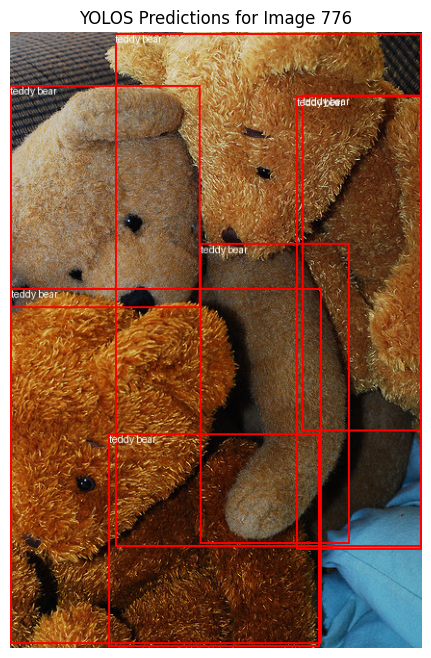

100%|██████████| 630/630 [02:29<00:00,  4.22it/s]


mAP@[0.5:0.95]: tensor(0.3880)
Detailed mAP results: {'map': tensor(0.3880), 'map_50': tensor(0.5635), 'map_75': tensor(0.4174), 'map_small': tensor(0.1303), 'map_medium': tensor(0.3436), 'map_large': tensor(0.5533), 'mar_1': tensor(0.3173), 'mar_10': tensor(0.4620), 'mar_100': tensor(0.4755), 'mar_small': tensor(0.1854), 'mar_medium': tensor(0.4410), 'mar_large': tensor(0.6353), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 9 - Validation mAP Score: 0.3880


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.387976,0.563462,0.417392,0.130295,0.343616,0.553327,0.317259,0.462028,0.47546,0.185366,0.441023,0.635321,-1.0,-1.0


  0%|          | 1/368 [00:04<27:15,  4.46s/it]

Epoch 10, Batch 0: Loss = 1.0498


  3%|▎         | 11/368 [00:44<26:29,  4.45s/it]

Epoch 10, Batch 10: Loss = 1.2063


  6%|▌         | 21/368 [01:23<21:15,  3.68s/it]

Epoch 10, Batch 20: Loss = 1.1490


  8%|▊         | 31/368 [02:05<24:17,  4.32s/it]

Epoch 10, Batch 30: Loss = 0.8131


 11%|█         | 41/368 [02:46<21:43,  3.99s/it]

Epoch 10, Batch 40: Loss = 1.0907


 14%|█▍        | 51/368 [03:33<23:46,  4.50s/it]

Epoch 10, Batch 50: Loss = 0.9598


 17%|█▋        | 61/368 [04:12<17:52,  3.49s/it]

Epoch 10, Batch 60: Loss = 1.0105


 19%|█▉        | 71/368 [04:50<19:50,  4.01s/it]

Epoch 10, Batch 70: Loss = 0.9391


 22%|██▏       | 81/368 [05:22<15:54,  3.32s/it]

Epoch 10, Batch 80: Loss = 0.9940


 25%|██▍       | 91/368 [05:57<17:10,  3.72s/it]

Epoch 10, Batch 90: Loss = 0.8332


 27%|██▋       | 101/368 [06:35<15:47,  3.55s/it]

Epoch 10, Batch 100: Loss = 0.9472


 30%|███       | 111/368 [07:16<19:37,  4.58s/it]

Epoch 10, Batch 110: Loss = 0.9314


 33%|███▎      | 121/368 [07:56<15:44,  3.83s/it]

Epoch 10, Batch 120: Loss = 1.0644


 36%|███▌      | 131/368 [08:31<15:00,  3.80s/it]

Epoch 10, Batch 130: Loss = 0.8880


 38%|███▊      | 141/368 [09:09<15:14,  4.03s/it]

Epoch 10, Batch 140: Loss = 0.9725


 41%|████      | 151/368 [09:48<13:23,  3.70s/it]

Epoch 10, Batch 150: Loss = 1.1920


 44%|████▍     | 161/368 [10:35<16:57,  4.91s/it]

Epoch 10, Batch 160: Loss = 0.9891


 46%|████▋     | 171/368 [11:14<12:05,  3.68s/it]

Epoch 10, Batch 170: Loss = 0.8786


 49%|████▉     | 181/368 [11:51<12:54,  4.14s/it]

Epoch 10, Batch 180: Loss = 1.0335


 52%|█████▏    | 191/368 [12:34<13:14,  4.49s/it]

Epoch 10, Batch 190: Loss = 0.9126


 55%|█████▍    | 201/368 [13:22<14:10,  5.09s/it]

Epoch 10, Batch 200: Loss = 1.0723


 57%|█████▋    | 211/368 [13:59<10:57,  4.19s/it]

Epoch 10, Batch 210: Loss = 0.9215


 60%|██████    | 221/368 [14:40<10:01,  4.09s/it]

Epoch 10, Batch 220: Loss = 0.9229


 63%|██████▎   | 231/368 [15:16<07:46,  3.40s/it]

Epoch 10, Batch 230: Loss = 1.1319


 65%|██████▌   | 241/368 [16:00<10:16,  4.86s/it]

Epoch 10, Batch 240: Loss = 0.8339


 68%|██████▊   | 251/368 [16:45<08:58,  4.60s/it]

Epoch 10, Batch 250: Loss = 1.1023


 71%|███████   | 261/368 [17:26<07:25,  4.16s/it]

Epoch 10, Batch 260: Loss = 1.0710


 74%|███████▎  | 271/368 [18:12<07:10,  4.44s/it]

Epoch 10, Batch 270: Loss = 1.0234


 76%|███████▋  | 281/368 [18:51<04:56,  3.40s/it]

Epoch 10, Batch 280: Loss = 1.1101


 79%|███████▉  | 291/368 [19:35<06:13,  4.85s/it]

Epoch 10, Batch 290: Loss = 0.8977


 82%|████████▏ | 301/368 [20:22<06:03,  5.42s/it]

Epoch 10, Batch 300: Loss = 0.8231


 85%|████████▍ | 311/368 [21:01<04:22,  4.60s/it]

Epoch 10, Batch 310: Loss = 0.9744


 87%|████████▋ | 321/368 [21:43<03:27,  4.42s/it]

Epoch 10, Batch 320: Loss = 1.0984


 90%|████████▉ | 331/368 [22:21<02:14,  3.63s/it]

Epoch 10, Batch 330: Loss = 1.0645


 93%|█████████▎| 341/368 [23:01<02:06,  4.70s/it]

Epoch 10, Batch 340: Loss = 1.1590


 95%|█████████▌| 351/368 [23:36<00:53,  3.12s/it]

Epoch 10, Batch 350: Loss = 1.0353


 98%|█████████▊| 361/368 [24:17<00:30,  4.32s/it]

Epoch 10, Batch 360: Loss = 1.0933


100%|██████████| 368/368 [24:45<00:00,  4.04s/it]


Epoch 10 Complete. Average train Loss: 4.0268, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:00<00:00,  1.14s/it]


Epoch 10 - Validation Loss: 3.9476


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.944 at location [0.96, 265.96, 323.2, 635.05]
Detected teddy bear with confidence 0.583 at location [303.66, 66.0, 427.69, 414.52]
Detected teddy bear with confidence 0.914 at location [198.0, 219.79, 352.7, 531.27]
Detected teddy bear with confidence 0.68 at location [297.91, 67.09, 428.0, 537.67]
Detected teddy bear with confidence 0.966 at location [109.04, 1.43, 427.56, 534.61]
Detected teddy bear with confidence 0.985 at location [0.03, 55.11, 197.53, 286.85]
Detected teddy bear with confidence 0.616 at location [102.78, 416.94, 321.27, 638.71]


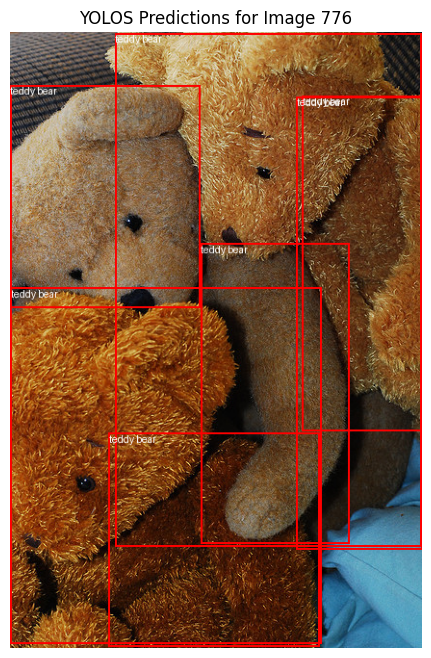

100%|██████████| 630/630 [02:29<00:00,  4.22it/s]


mAP@[0.5:0.95]: tensor(0.3890)
Detailed mAP results: {'map': tensor(0.3890), 'map_50': tensor(0.5650), 'map_75': tensor(0.4175), 'map_small': tensor(0.1305), 'map_medium': tensor(0.3430), 'map_large': tensor(0.5550), 'mar_1': tensor(0.3173), 'mar_10': tensor(0.4640), 'mar_100': tensor(0.4796), 'mar_small': tensor(0.1875), 'mar_medium': tensor(0.4442), 'mar_large': tensor(0.6400), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 10 - Validation mAP Score: 0.3890


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.388951,0.564995,0.417486,0.130512,0.34297,0.555029,0.317347,0.464041,0.479571,0.187518,0.444157,0.640038,-1.0,-1.0


Best model saved with mAP 0.3890 at epoch 10


In [ ]:
# Train Setting
epochs = 10
optimizer = torch.optim.AdamW(loha_parameters, lr=3e-5, weight_decay=0.01)
scheduler = CosineAnnealingWarmRestarts(optimizer, T_0=2, T_mult=2, eta_min=1e-6)
early_stopping = EarlyStopping(patience=3)

# Train the LoHa model
best_mAP_score_LoHa, epochs_list_LoHa, train_total_losses_LoHa, val_total_losses_LoHa, train_focal_losses_LoHa, train_bbox_losses_LoHa, train_giou_losses_LoHa, mAP_scores_LoHa = train_model(
    model_with_LoHa, processor, train_dataloader, val_dataloader, optimizer, scheduler, early_stopping, device, "loha_model.pth", epochs
)


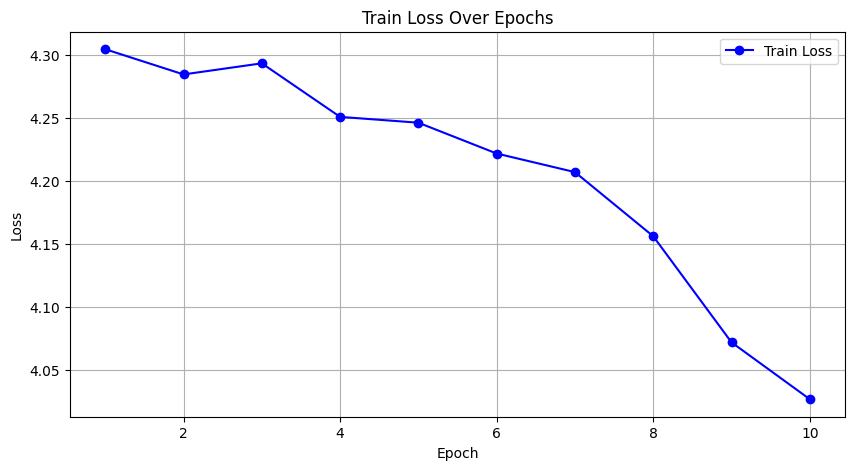

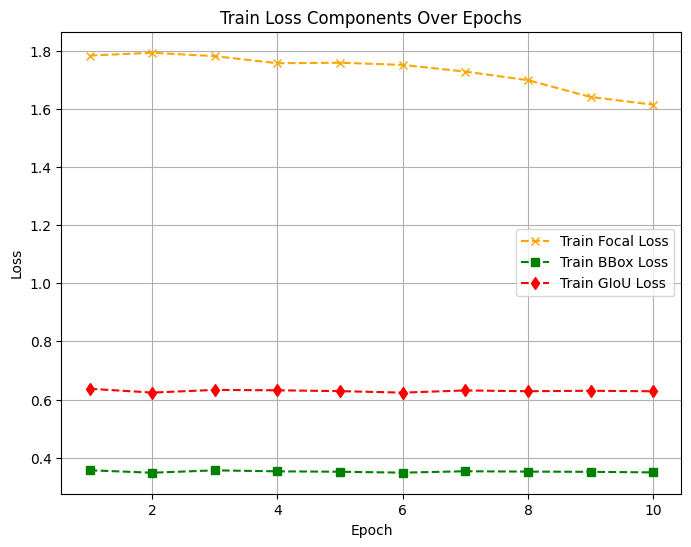

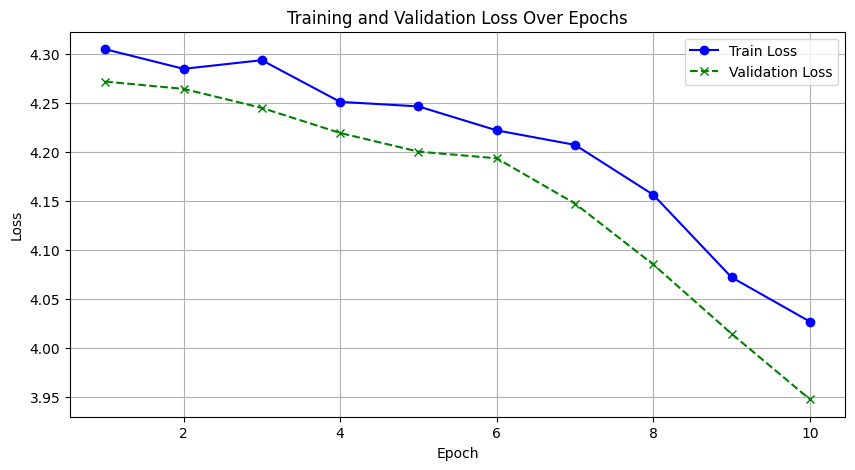

In [ ]:
plot_loss_graphs(epochs_list_LoHa, train_total_losses_LoHa, train_focal_losses_LoHa, train_bbox_losses_LoHa, train_giou_losses_LoHa, val_total_losses_LoHa)


In [ ]:
# Load the saved model
model_with_LoHa = torch.load("loha_model.pth", map_location=torch.device("cuda" if torch.cuda.is_available() else "cpu"))
print(model_with_LoHa.peft_config)

# Check which weights have been updated
for name, param in model_with_LoHa.named_parameters():
    if param.requires_grad:
        print(f"{name} Trainable (Updated)")
    else:
        print(f"{name} Frozen (Original)")

print(model_with_LoHa)

{'default': LoHaConfig(task_type=None, peft_type=<PeftType.LOHA: 'LOHA'>, auto_mapping=None, base_model_name_or_path='hustvl/yolos-small', revision=None, inference_mode=False, rank_pattern={}, alpha_pattern={}, r=8, alpha=12, rank_dropout=0.1, module_dropout=0.1, use_effective_conv2d=False, target_modules={'query', 'value'}, exclude_modules=None, init_weights=True, layers_to_transform=None, layers_pattern=None, modules_to_save=None)}
base_model.model.vit.embeddings.cls_token Frozen (Original)
base_model.model.vit.embeddings.detection_tokens Frozen (Original)
base_model.model.vit.embeddings.position_embeddings Frozen (Original)
base_model.model.vit.embeddings.patch_embeddings.projection.weight Frozen (Original)
base_model.model.vit.embeddings.patch_embeddings.projection.bias Frozen (Original)
base_model.model.vit.encoder.mid_position_embeddings Frozen (Original)
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.weight Frozen (Original)
base_model.model.vit.encode

<ipython-input-63-d6d1e4258480>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_with_LoHa = torch.load("loha_model.pth", map_location=torch.device("cuda" if torch.cud

In [ ]:
# Mean value of LoHa layers after training
for name, param in model_with_LoHa.named_parameters():
    if "hada" in name:
        print(f"{name} mean after training: {param.data.mean().item():.6f}")

base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_a.default mean after training: -0.002665
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w1_b.default mean after training: -0.000875
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w2_a.default mean after training: -0.002052
base_model.model.vit.encoder.layer.0.attention.attention.query.hada_w2_b.default mean after training: -0.000034
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w1_a.default mean after training: 0.005026
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w1_b.default mean after training: 0.000017
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w2_a.default mean after training: 0.005247
base_model.model.vit.encoder.layer.0.attention.attention.value.hada_w2_b.default mean after training: -0.000004
base_model.model.vit.encoder.layer.1.attention.attention.query.hada_w1_a.default mean after training: -0.00

#### **Evaluate Model with LoHa**

0it [00:00, ?it/s]

Detected sports ball with confidence 1.0 at location [49.69, 193.45, 188.75, 328.96]
Detected person with confidence 0.912 at location [140.43, 22.35, 461.92, 475.77]
Detected person with confidence 0.998 at location [425.45, 29.59, 618.64, 477.13]
Detected person with confidence 0.527 at location [101.84, 21.78, 459.51, 475.66]
Detected person with confidence 0.996 at location [16.53, 21.65, 460.98, 475.08]


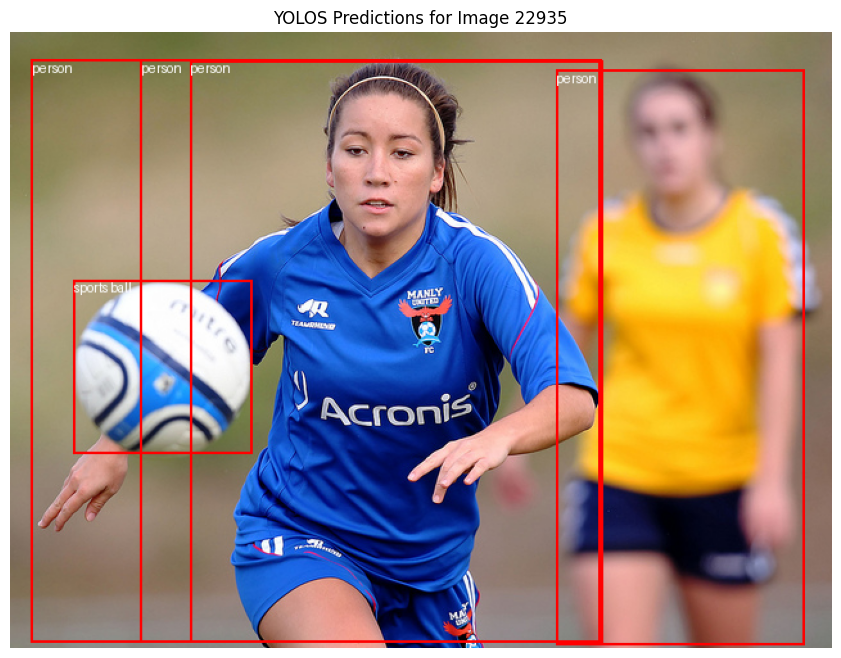

900it [03:42,  4.05it/s]


mAP@[0.5:0.95]: tensor(0.3327)
Detailed mAP results: {'map': tensor(0.3327), 'map_50': tensor(0.5165), 'map_75': tensor(0.3425), 'map_small': tensor(0.0922), 'map_medium': tensor(0.3183), 'map_large': tensor(0.5120), 'mar_1': tensor(0.2855), 'mar_10': tensor(0.4185), 'mar_100': tensor(0.4317), 'mar_small': tensor(0.1509), 'mar_medium': tensor(0.4106), 'mar_large': tensor(0.6046), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Model with LoHa Performance (mAP): {'map': tensor(0.3327), 'map_50': tensor(0.5165), 'map_75': tensor(0.3425), 'map_small': tensor(0.0922), 'map_medium': tensor(

,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.332727,0.516466,0.342496,0.092201,0.318329,0.512017,0.285521,0.418458,0.431665,0.150939,0.410583,0.60458,-1.0,-1.0


In [ ]:
model_with_LoHa_results = evaluate_model(model_with_LoHa, processor, test_dataset, yolos_categories)
print("Model with LoHa Performance (mAP):", model_with_LoHa_results)

model_with_LoHA_results_dict = {
    key: value.item() if isinstance(value, torch.Tensor) else value
    for key, value in model_with_LoHa_results.items()
    if key != "classes"
}
model_with_LoHa_results_df = pd.DataFrame([model_with_LoHA_results_dict])
print("Model with LoHa Performance (mAP):")
print(model_with_LoHa_results_df)
display(model_with_LoHa_results_df)

### **(d) LoKr- Low Rank Kronecker Product**

#### **LoKrConfig**


In [27]:
# Define model for LoKr
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_for_LoKr = YolosForObjectDetection.from_pretrained(model_name).to(device)

lokr_config = LoKrConfig(
    r=8,
    alpha=16,
    rank_dropout=0.3,
    module_dropout=0.1,
    use_effective_conv2d=True,
    decompose_both=True,
    decompose_factor=8,
    target_modules=target_modules
)

# Apply LoKr to the model
model_with_LoKr = get_peft_model(model_for_LoKr, lokr_config)
model_with_LoKr.print_trainable_parameters()

trainable params: 19,968 || all params: 30,704,736 || trainable%: 0.0650


In [28]:
# Inspect LoKr Layers
for name, param in model_with_LoKr.named_parameters():
    print(f"{name} - requires_grad: {param.requires_grad}")

for name, param in model_with_LoKr.named_parameters():
    if "lokr" in name:
        print(name, param.shape)


base_model.model.vit.embeddings.cls_token - requires_grad: False
base_model.model.vit.embeddings.detection_tokens - requires_grad: False
base_model.model.vit.embeddings.position_embeddings - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.weight - requires_grad: False
base_model.model.vit.embeddings.patch_embeddings.projection.bias - requires_grad: False
base_model.model.vit.encoder.mid_position_embeddings - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.weight - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.base_layer.bias - requires_grad: False
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w1.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_a.default - requires_grad: True
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_b.default - requires_grad: True
base_model.model.vit.

In [29]:
# Mean value of LoKr layers before training
for name, param in model_with_LoKr.named_parameters():
    if "lokr" in name:
        print(f"{name} mean after training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w1.default mean after training: 0.000000
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_a.default mean after training: -0.020643
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_b.default mean after training: -0.002195
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w1.default mean after training: 0.000000
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w2_a.default mean after training: -0.002571
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w2_b.default mean after training: 0.004130
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w1.default mean after training: 0.000000
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w2_a.default mean after training: 0.004395
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w2_b.default mean after training: -0.004493
bas

In [59]:
lokr_total_parameters = [p for p in model_with_LoKr.parameters()]
print(f"Number of LoKr parameter tensors: {len(lokr_total_parameters)}")

lokr_parameters = [p for p in model_with_LoKr.parameters() if p.requires_grad]
print(f"Number of LoKr trainable parameter tensors (requires_grad=True): {len(lokr_parameters)}")


Number of LoKr parameter tensors: 284
Number of LoKr trainable parameter tensors (requires_grad=True): 72


#### **Train Model with LoKr**

  0%|          | 1/368 [00:07<44:39,  7.30s/it]

Epoch 1, Batch 0: Loss = 1.2390


  3%|▎         | 11/368 [00:45<20:32,  3.45s/it]

Epoch 1, Batch 10: Loss = 0.6350


  6%|▌         | 21/368 [01:32<26:34,  4.60s/it]

Epoch 1, Batch 20: Loss = 1.1502


  8%|▊         | 31/368 [02:14<23:09,  4.12s/it]

Epoch 1, Batch 30: Loss = 1.0592


 11%|█         | 41/368 [02:52<18:51,  3.46s/it]

Epoch 1, Batch 40: Loss = 0.9540


 14%|█▍        | 51/368 [03:36<23:45,  4.50s/it]

Epoch 1, Batch 50: Loss = 1.0465


 17%|█▋        | 61/368 [04:19<22:12,  4.34s/it]

Epoch 1, Batch 60: Loss = 1.1187


 19%|█▉        | 71/368 [05:02<20:54,  4.22s/it]

Epoch 1, Batch 70: Loss = 1.1760


 22%|██▏       | 81/368 [05:41<17:34,  3.67s/it]

Epoch 1, Batch 80: Loss = 0.9538


 25%|██▍       | 91/368 [06:22<19:43,  4.27s/it]

Epoch 1, Batch 90: Loss = 1.4404


 27%|██▋       | 101/368 [07:05<16:48,  3.78s/it]

Epoch 1, Batch 100: Loss = 1.1544


 30%|███       | 111/368 [07:46<18:15,  4.26s/it]

Epoch 1, Batch 110: Loss = 0.9549


 33%|███▎      | 121/368 [08:31<17:02,  4.14s/it]

Epoch 1, Batch 120: Loss = 1.3376


 36%|███▌      | 131/368 [09:20<18:37,  4.72s/it]

Epoch 1, Batch 130: Loss = 1.0689


 38%|███▊      | 141/368 [10:00<15:27,  4.09s/it]

Epoch 1, Batch 140: Loss = 1.1767


 41%|████      | 151/368 [10:37<15:22,  4.25s/it]

Epoch 1, Batch 150: Loss = 0.8167


 44%|████▍     | 161/368 [11:19<15:02,  4.36s/it]

Epoch 1, Batch 160: Loss = 1.1012


 46%|████▋     | 171/368 [12:02<15:11,  4.62s/it]

Epoch 1, Batch 170: Loss = 1.0531


 49%|████▉     | 181/368 [12:47<14:18,  4.59s/it]

Epoch 1, Batch 180: Loss = 0.8947


 52%|█████▏    | 191/368 [13:30<12:17,  4.17s/it]

Epoch 1, Batch 190: Loss = 1.0818


 55%|█████▍    | 201/368 [14:12<12:35,  4.53s/it]

Epoch 1, Batch 200: Loss = 1.0389


 57%|█████▋    | 211/368 [14:54<10:07,  3.87s/it]

Epoch 1, Batch 210: Loss = 1.1325


 60%|██████    | 221/368 [15:37<10:11,  4.16s/it]

Epoch 1, Batch 220: Loss = 0.9343


 63%|██████▎   | 231/368 [16:26<10:45,  4.71s/it]

Epoch 1, Batch 230: Loss = 1.2623


 65%|██████▌   | 241/368 [17:08<09:52,  4.66s/it]

Epoch 1, Batch 240: Loss = 1.0227


 68%|██████▊   | 251/368 [17:52<08:31,  4.37s/it]

Epoch 1, Batch 250: Loss = 1.1137


 71%|███████   | 261/368 [18:32<07:11,  4.03s/it]

Epoch 1, Batch 260: Loss = 1.0096


 74%|███████▎  | 271/368 [19:16<06:27,  3.99s/it]

Epoch 1, Batch 270: Loss = 1.0571


 76%|███████▋  | 281/368 [19:56<05:15,  3.63s/it]

Epoch 1, Batch 280: Loss = 1.6198


 79%|███████▉  | 291/368 [20:39<05:34,  4.34s/it]

Epoch 1, Batch 290: Loss = 1.0208


 82%|████████▏ | 301/368 [21:26<06:00,  5.37s/it]

Epoch 1, Batch 300: Loss = 1.0317


 85%|████████▍ | 311/368 [22:10<04:20,  4.57s/it]

Epoch 1, Batch 310: Loss = 1.0331


 87%|████████▋ | 321/368 [22:53<03:07,  3.99s/it]

Epoch 1, Batch 320: Loss = 1.0793


 90%|████████▉ | 331/368 [23:35<02:26,  3.96s/it]

Epoch 1, Batch 330: Loss = 1.2110


 93%|█████████▎| 341/368 [24:14<01:44,  3.86s/it]

Epoch 1, Batch 340: Loss = 0.9755


 95%|█████████▌| 351/368 [25:02<01:15,  4.46s/it]

Epoch 1, Batch 350: Loss = 1.0575


 98%|█████████▊| 361/368 [25:48<00:32,  4.64s/it]

Epoch 1, Batch 360: Loss = 1.3182


100%|██████████| 368/368 [26:20<00:00,  4.30s/it]


Epoch 1 Complete. Average train Loss: 4.3174, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:13<00:00,  1.22s/it]


Epoch 1 - Validation Loss: 4.2712


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.938 at location [0.99, 266.87, 323.4, 634.97]
Detected teddy bear with confidence 0.859 at location [197.62, 220.4, 353.19, 530.63]
Detected teddy bear with confidence 0.622 at location [297.84, 66.51, 427.94, 536.49]
Detected teddy bear with confidence 0.967 at location [108.97, 1.43, 427.56, 533.95]
Detected teddy bear with confidence 0.984 at location [0.1, 54.63, 197.79, 285.68]
Detected teddy bear with confidence 0.521 at location [102.9, 417.73, 321.21, 638.77]


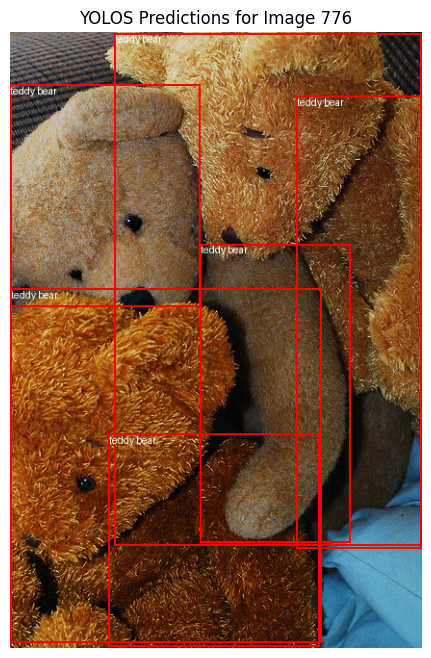

100%|██████████| 630/630 [02:33<00:00,  4.10it/s]


mAP@[0.5:0.95]: tensor(0.3833)
Detailed mAP results: {'map': tensor(0.3833), 'map_50': tensor(0.5586), 'map_75': tensor(0.4092), 'map_small': tensor(0.1196), 'map_medium': tensor(0.3410), 'map_large': tensor(0.5481), 'mar_1': tensor(0.3156), 'mar_10': tensor(0.4545), 'mar_100': tensor(0.4654), 'mar_small': tensor(0.1611), 'mar_medium': tensor(0.4271), 'mar_large': tensor(0.6242), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 1 - Validation mAP Score: 0.3833


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.383323,0.55859,0.40922,0.119617,0.341026,0.548114,0.315649,0.454541,0.465405,0.161087,0.427145,0.624188,-1.0,-1.0


Best model saved with mAP 0.3833 at epoch 1


  0%|          | 1/368 [00:02<14:04,  2.30s/it]

Epoch 2, Batch 0: Loss = 0.9943


  3%|▎         | 11/368 [00:48<27:32,  4.63s/it]

Epoch 2, Batch 10: Loss = 1.1032


  6%|▌         | 21/368 [01:28<26:36,  4.60s/it]

Epoch 2, Batch 20: Loss = 0.7512


  8%|▊         | 31/368 [02:10<23:00,  4.10s/it]

Epoch 2, Batch 30: Loss = 0.9475


 11%|█         | 41/368 [02:51<22:49,  4.19s/it]

Epoch 2, Batch 40: Loss = 0.9943


 14%|█▍        | 51/368 [03:30<20:07,  3.81s/it]

Epoch 2, Batch 50: Loss = 1.3883


 17%|█▋        | 61/368 [04:14<19:49,  3.88s/it]

Epoch 2, Batch 60: Loss = 1.2101


 19%|█▉        | 71/368 [04:59<21:58,  4.44s/it]

Epoch 2, Batch 70: Loss = 0.9413


 22%|██▏       | 81/368 [05:38<19:53,  4.16s/it]

Epoch 2, Batch 80: Loss = 1.0440


 25%|██▍       | 91/368 [06:17<19:40,  4.26s/it]

Epoch 2, Batch 90: Loss = 1.3715


 27%|██▋       | 101/368 [07:01<20:38,  4.64s/it]

Epoch 2, Batch 100: Loss = 1.0371


 30%|███       | 111/368 [07:43<17:50,  4.16s/it]

Epoch 2, Batch 110: Loss = 1.1467


 33%|███▎      | 121/368 [08:26<19:39,  4.78s/it]

Epoch 2, Batch 120: Loss = 1.1298


 36%|███▌      | 131/368 [09:11<18:49,  4.77s/it]

Epoch 2, Batch 130: Loss = 1.0581


 38%|███▊      | 141/368 [09:46<11:39,  3.08s/it]

Epoch 2, Batch 140: Loss = 1.2494


 41%|████      | 151/368 [10:29<15:01,  4.15s/it]

Epoch 2, Batch 150: Loss = 1.1096


 44%|████▍     | 161/368 [11:10<15:25,  4.47s/it]

Epoch 2, Batch 160: Loss = 1.3549


 46%|████▋     | 171/368 [11:52<15:19,  4.67s/it]

Epoch 2, Batch 170: Loss = 0.8671


 49%|████▉     | 181/368 [12:37<15:12,  4.88s/it]

Epoch 2, Batch 180: Loss = 0.9335


 52%|█████▏    | 191/368 [13:23<13:06,  4.44s/it]

Epoch 2, Batch 190: Loss = 1.1412


 55%|█████▍    | 201/368 [14:04<10:02,  3.61s/it]

Epoch 2, Batch 200: Loss = 1.0206


 57%|█████▋    | 211/368 [14:47<09:49,  3.75s/it]

Epoch 2, Batch 210: Loss = 0.8584


 60%|██████    | 221/368 [15:29<10:44,  4.38s/it]

Epoch 2, Batch 220: Loss = 0.9305


 63%|██████▎   | 231/368 [16:09<10:15,  4.49s/it]

Epoch 2, Batch 230: Loss = 0.9914


 65%|██████▌   | 241/368 [16:55<10:42,  5.06s/it]

Epoch 2, Batch 240: Loss = 1.1007


 68%|██████▊   | 251/368 [17:36<08:08,  4.18s/it]

Epoch 2, Batch 250: Loss = 0.9630


 71%|███████   | 261/368 [18:26<08:56,  5.01s/it]

Epoch 2, Batch 260: Loss = 0.7131


 74%|███████▎  | 271/368 [19:08<07:01,  4.35s/it]

Epoch 2, Batch 270: Loss = 0.9727


 76%|███████▋  | 281/368 [19:51<05:25,  3.74s/it]

Epoch 2, Batch 280: Loss = 1.1791


 79%|███████▉  | 291/368 [20:37<05:23,  4.20s/it]

Epoch 2, Batch 290: Loss = 1.1659


 82%|████████▏ | 301/368 [21:13<04:14,  3.80s/it]

Epoch 2, Batch 300: Loss = 1.0345


 85%|████████▍ | 311/368 [21:55<04:26,  4.67s/it]

Epoch 2, Batch 310: Loss = 1.1846


 87%|████████▋ | 321/368 [22:45<04:03,  5.18s/it]

Epoch 2, Batch 320: Loss = 0.7988


 90%|████████▉ | 331/368 [23:29<02:19,  3.78s/it]

Epoch 2, Batch 330: Loss = 1.0436


 93%|█████████▎| 341/368 [24:07<01:51,  4.13s/it]

Epoch 2, Batch 340: Loss = 0.8673


 95%|█████████▌| 351/368 [24:52<01:20,  4.72s/it]

Epoch 2, Batch 350: Loss = 1.4875


 98%|█████████▊| 361/368 [25:32<00:32,  4.66s/it]

Epoch 2, Batch 360: Loss = 1.1104


100%|██████████| 368/368 [26:00<00:00,  4.24s/it]


Epoch 2 Complete. Average train Loss: 4.3008, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:11<00:00,  1.21s/it]


Epoch 2 - Validation Loss: 4.2592


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.939 at location [0.98, 266.8, 323.4, 634.98]
Detected teddy bear with confidence 0.862 at location [197.63, 220.35, 353.19, 530.62]
Detected teddy bear with confidence 0.627 at location [297.87, 66.46, 427.95, 536.52]
Detected teddy bear with confidence 0.967 at location [108.98, 1.42, 427.57, 533.93]
Detected teddy bear with confidence 0.985 at location [0.1, 54.62, 197.77, 285.72]
Detected teddy bear with confidence 0.523 at location [102.9, 417.63, 321.21, 638.77]


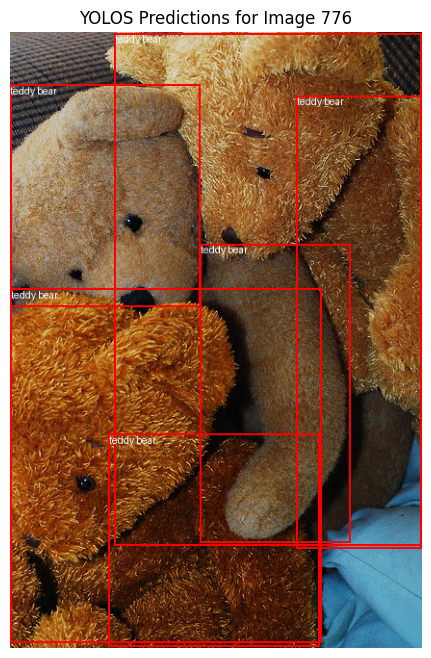

100%|██████████| 630/630 [02:32<00:00,  4.13it/s]


mAP@[0.5:0.95]: tensor(0.3841)
Detailed mAP results: {'map': tensor(0.3841), 'map_50': tensor(0.5598), 'map_75': tensor(0.4110), 'map_small': tensor(0.1214), 'map_medium': tensor(0.3399), 'map_large': tensor(0.5485), 'mar_1': tensor(0.3154), 'mar_10': tensor(0.4558), 'mar_100': tensor(0.4669), 'mar_small': tensor(0.1667), 'mar_medium': tensor(0.4272), 'mar_large': tensor(0.6244), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 2 - Validation mAP Score: 0.3841


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.384081,0.559843,0.411043,0.121378,0.339896,0.54847,0.315441,0.455768,0.466918,0.166749,0.427167,0.62439,-1.0,-1.0


Best model saved with mAP 0.3841 at epoch 2


  0%|          | 1/368 [00:02<16:58,  2.77s/it]

Epoch 3, Batch 0: Loss = 0.8829


  3%|▎         | 11/368 [00:37<21:17,  3.58s/it]

Epoch 3, Batch 10: Loss = 1.1490


  6%|▌         | 21/368 [01:14<22:44,  3.93s/it]

Epoch 3, Batch 20: Loss = 0.9365


  8%|▊         | 31/368 [02:00<25:59,  4.63s/it]

Epoch 3, Batch 30: Loss = 1.0073


 11%|█         | 41/368 [02:37<21:26,  3.94s/it]

Epoch 3, Batch 40: Loss = 0.7848


 14%|█▍        | 51/368 [03:17<17:01,  3.22s/it]

Epoch 3, Batch 50: Loss = 1.3138


 17%|█▋        | 61/368 [04:03<22:27,  4.39s/it]

Epoch 3, Batch 60: Loss = 1.0231


 19%|█▉        | 71/368 [04:52<22:41,  4.59s/it]

Epoch 3, Batch 70: Loss = 1.0844


 22%|██▏       | 81/368 [05:37<21:32,  4.50s/it]

Epoch 3, Batch 80: Loss = 0.9112


 25%|██▍       | 91/368 [06:12<15:32,  3.37s/it]

Epoch 3, Batch 90: Loss = 0.9867


 27%|██▋       | 101/368 [07:01<22:31,  5.06s/it]

Epoch 3, Batch 100: Loss = 1.1951


 30%|███       | 111/368 [07:43<20:34,  4.80s/it]

Epoch 3, Batch 110: Loss = 1.5082


 33%|███▎      | 121/368 [08:26<16:42,  4.06s/it]

Epoch 3, Batch 120: Loss = 0.9127


 36%|███▌      | 131/368 [08:59<14:20,  3.63s/it]

Epoch 3, Batch 130: Loss = 1.0406


 38%|███▊      | 141/368 [09:42<16:40,  4.41s/it]

Epoch 3, Batch 140: Loss = 1.1311


 41%|████      | 151/368 [10:31<16:17,  4.51s/it]

Epoch 3, Batch 150: Loss = 1.0483


 44%|████▍     | 161/368 [11:13<15:04,  4.37s/it]

Epoch 3, Batch 160: Loss = 0.8707


 46%|████▋     | 171/368 [11:59<13:10,  4.01s/it]

Epoch 3, Batch 170: Loss = 0.7875


 49%|████▉     | 181/368 [12:38<12:04,  3.87s/it]

Epoch 3, Batch 180: Loss = 1.3970


 52%|█████▏    | 191/368 [13:16<11:27,  3.88s/it]

Epoch 3, Batch 190: Loss = 1.0413


 55%|█████▍    | 201/368 [14:00<12:16,  4.41s/it]

Epoch 3, Batch 200: Loss = 1.0552


 57%|█████▋    | 211/368 [14:38<09:26,  3.61s/it]

Epoch 3, Batch 210: Loss = 0.9671


 60%|██████    | 221/368 [15:17<09:18,  3.80s/it]

Epoch 3, Batch 220: Loss = 1.0516


 63%|██████▎   | 231/368 [16:09<11:20,  4.97s/it]

Epoch 3, Batch 230: Loss = 1.3223


 65%|██████▌   | 241/368 [16:52<10:17,  4.86s/it]

Epoch 3, Batch 240: Loss = 1.2358


 68%|██████▊   | 251/368 [17:36<09:14,  4.74s/it]

Epoch 3, Batch 250: Loss = 0.8970


 71%|███████   | 261/368 [18:15<07:13,  4.05s/it]

Epoch 3, Batch 260: Loss = 1.0817


 74%|███████▎  | 271/368 [18:54<06:16,  3.88s/it]

Epoch 3, Batch 270: Loss = 1.2841


 76%|███████▋  | 281/368 [19:38<06:57,  4.80s/it]

Epoch 3, Batch 280: Loss = 1.2236


 79%|███████▉  | 291/368 [20:17<04:20,  3.39s/it]

Epoch 3, Batch 290: Loss = 1.2022


 82%|████████▏ | 301/368 [21:00<04:38,  4.16s/it]

Epoch 3, Batch 300: Loss = 0.9632


 85%|████████▍ | 311/368 [21:49<04:39,  4.91s/it]

Epoch 3, Batch 310: Loss = 1.0615


 87%|████████▋ | 321/368 [22:35<03:52,  4.94s/it]

Epoch 3, Batch 320: Loss = 0.9578


 90%|████████▉ | 331/368 [23:19<02:35,  4.20s/it]

Epoch 3, Batch 330: Loss = 1.1425


 93%|█████████▎| 341/368 [24:00<02:21,  5.23s/it]

Epoch 3, Batch 340: Loss = 1.0136


 95%|█████████▌| 351/368 [24:42<01:03,  3.73s/it]

Epoch 3, Batch 350: Loss = 1.1596


 98%|█████████▊| 361/368 [25:27<00:31,  4.49s/it]

Epoch 3, Batch 360: Loss = 1.1828


100%|██████████| 368/368 [25:48<00:00,  4.21s/it]


Epoch 3 Complete. Average train Loss: 4.3080, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:10<00:00,  1.21s/it]


Epoch 3 - Validation Loss: 4.2451


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.94 at location [0.98, 266.73, 323.4, 634.99]
Detected teddy bear with confidence 0.867 at location [197.67, 220.31, 353.19, 530.6]
Detected teddy bear with confidence 0.633 at location [297.9, 66.42, 427.95, 536.53]
Detected teddy bear with confidence 0.967 at location [109.0, 1.42, 427.57, 533.91]
Detected teddy bear with confidence 0.985 at location [0.09, 54.62, 197.75, 285.74]
Detected teddy bear with confidence 0.527 at location [102.9, 417.52, 321.2, 638.78]


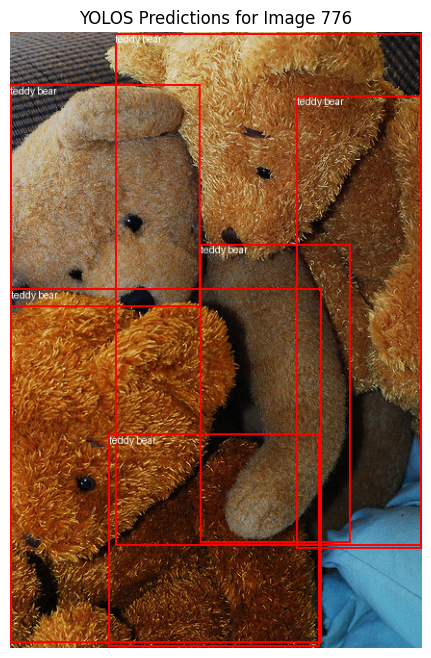

100%|██████████| 630/630 [02:33<00:00,  4.11it/s]


mAP@[0.5:0.95]: tensor(0.3849)
Detailed mAP results: {'map': tensor(0.3849), 'map_50': tensor(0.5604), 'map_75': tensor(0.4121), 'map_small': tensor(0.1222), 'map_medium': tensor(0.3404), 'map_large': tensor(0.5500), 'mar_1': tensor(0.3158), 'mar_10': tensor(0.4568), 'mar_100': tensor(0.4682), 'mar_small': tensor(0.1670), 'mar_medium': tensor(0.4294), 'mar_large': tensor(0.6264), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 3 - Validation mAP Score: 0.3849


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.384927,0.560398,0.41213,0.122221,0.340414,0.549968,0.31578,0.456798,0.468248,0.167049,0.429417,0.626404,-1.0,-1.0


Best model saved with mAP 0.3849 at epoch 3


  0%|          | 1/368 [00:05<34:42,  5.68s/it]

Epoch 4, Batch 0: Loss = 1.1640


  3%|▎         | 11/368 [00:47<28:23,  4.77s/it]

Epoch 4, Batch 10: Loss = 1.1980


  6%|▌         | 21/368 [01:33<26:49,  4.64s/it]

Epoch 4, Batch 20: Loss = 0.9154


  8%|▊         | 31/368 [02:13<25:26,  4.53s/it]

Epoch 4, Batch 30: Loss = 0.9290


 11%|█         | 41/368 [02:54<24:34,  4.51s/it]

Epoch 4, Batch 40: Loss = 1.0418


 14%|█▍        | 51/368 [03:39<28:27,  5.38s/it]

Epoch 4, Batch 50: Loss = 1.1061


 17%|█▋        | 61/368 [04:18<19:35,  3.83s/it]

Epoch 4, Batch 60: Loss = 1.1357


 19%|█▉        | 71/368 [04:57<20:28,  4.14s/it]

Epoch 4, Batch 70: Loss = 0.8485


 22%|██▏       | 81/368 [05:38<21:38,  4.52s/it]

Epoch 4, Batch 80: Loss = 0.9885


 25%|██▍       | 91/368 [06:21<18:04,  3.91s/it]

Epoch 4, Batch 90: Loss = 0.9875


 27%|██▋       | 101/368 [07:07<19:32,  4.39s/it]

Epoch 4, Batch 100: Loss = 1.0140


 30%|███       | 111/368 [07:52<18:45,  4.38s/it]

Epoch 4, Batch 110: Loss = 0.9013


 33%|███▎      | 121/368 [08:37<17:02,  4.14s/it]

Epoch 4, Batch 120: Loss = 0.7914


 36%|███▌      | 131/368 [09:19<14:24,  3.65s/it]

Epoch 4, Batch 130: Loss = 1.0447


 38%|███▊      | 141/368 [09:58<15:44,  4.16s/it]

Epoch 4, Batch 140: Loss = 1.0412


 41%|████      | 151/368 [10:43<17:24,  4.82s/it]

Epoch 4, Batch 150: Loss = 1.0836


 44%|████▍     | 161/368 [11:19<11:33,  3.35s/it]

Epoch 4, Batch 160: Loss = 0.9904


 46%|████▋     | 171/368 [12:02<12:19,  3.75s/it]

Epoch 4, Batch 170: Loss = 1.1947


 49%|████▉     | 181/368 [12:46<12:17,  3.94s/it]

Epoch 4, Batch 180: Loss = 0.9155


 52%|█████▏    | 191/368 [13:27<13:37,  4.62s/it]

Epoch 4, Batch 190: Loss = 0.8580


 55%|█████▍    | 201/368 [14:15<13:21,  4.80s/it]

Epoch 4, Batch 200: Loss = 0.9133


 57%|█████▋    | 211/368 [15:04<14:06,  5.39s/it]

Epoch 4, Batch 210: Loss = 1.1498


 60%|██████    | 221/368 [15:42<08:51,  3.61s/it]

Epoch 4, Batch 220: Loss = 1.3007


 63%|██████▎   | 231/368 [16:26<09:36,  4.21s/it]

Epoch 4, Batch 230: Loss = 0.9602


 65%|██████▌   | 241/368 [17:05<09:36,  4.54s/it]

Epoch 4, Batch 240: Loss = 1.0460


 68%|██████▊   | 251/368 [17:49<07:54,  4.05s/it]

Epoch 4, Batch 250: Loss = 1.0286


 71%|███████   | 261/368 [18:30<07:08,  4.00s/it]

Epoch 4, Batch 260: Loss = 0.9999


 74%|███████▎  | 271/368 [19:10<06:15,  3.87s/it]

Epoch 4, Batch 270: Loss = 1.2323


 76%|███████▋  | 281/368 [20:00<08:03,  5.56s/it]

Epoch 4, Batch 280: Loss = 1.0175


 79%|███████▉  | 291/368 [20:48<06:16,  4.89s/it]

Epoch 4, Batch 290: Loss = 1.1196


 82%|████████▏ | 301/368 [21:31<04:43,  4.23s/it]

Epoch 4, Batch 300: Loss = 1.1257


 85%|████████▍ | 311/368 [22:20<04:50,  5.10s/it]

Epoch 4, Batch 310: Loss = 1.0722


 87%|████████▋ | 321/368 [22:53<02:22,  3.03s/it]

Epoch 4, Batch 320: Loss = 0.9356


 90%|████████▉ | 331/368 [23:35<02:43,  4.42s/it]

Epoch 4, Batch 330: Loss = 1.0547


 93%|█████████▎| 341/368 [24:20<01:56,  4.33s/it]

Epoch 4, Batch 340: Loss = 1.4693


 95%|█████████▌| 351/368 [25:00<01:14,  4.40s/it]

Epoch 4, Batch 350: Loss = 1.3400


 98%|█████████▊| 361/368 [25:46<00:30,  4.39s/it]

Epoch 4, Batch 360: Loss = 1.1477


100%|██████████| 368/368 [26:12<00:00,  4.27s/it]


Epoch 4 Complete. Average train Loss: 4.2648, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:10<00:00,  1.21s/it]


Epoch 4 - Validation Loss: 4.2292


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.941 at location [0.98, 266.65, 323.39, 635.0]
Detected teddy bear with confidence 0.871 at location [197.68, 220.25, 353.19, 530.58]
Detected teddy bear with confidence 0.639 at location [297.92, 66.37, 427.95, 536.52]
Detected teddy bear with confidence 0.968 at location [109.01, 1.41, 427.57, 533.87]
Detected teddy bear with confidence 0.985 at location [0.09, 54.62, 197.74, 285.77]
Detected teddy bear with confidence 0.531 at location [102.91, 417.42, 321.19, 638.79]


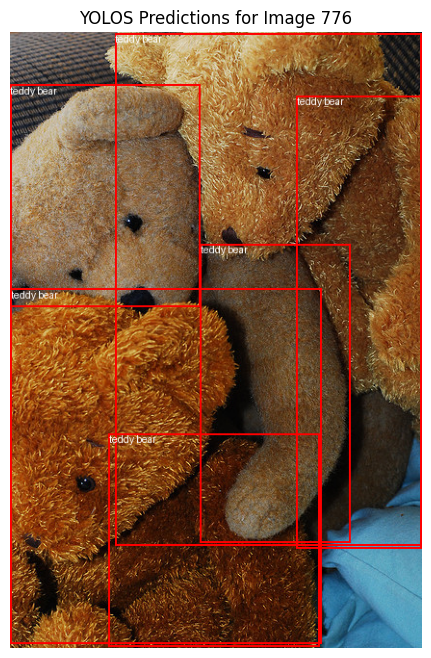

100%|██████████| 630/630 [02:34<00:00,  4.07it/s]


mAP@[0.5:0.95]: tensor(0.3854)
Detailed mAP results: {'map': tensor(0.3854), 'map_50': tensor(0.5616), 'map_75': tensor(0.4124), 'map_small': tensor(0.1227), 'map_medium': tensor(0.3413), 'map_large': tensor(0.5503), 'mar_1': tensor(0.3165), 'mar_10': tensor(0.4573), 'mar_100': tensor(0.4690), 'mar_small': tensor(0.1680), 'mar_medium': tensor(0.4303), 'mar_large': tensor(0.6268), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 4 - Validation mAP Score: 0.3854


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.38539,0.56164,0.412406,0.122711,0.341263,0.550331,0.316473,0.457277,0.469017,0.167952,0.430335,0.626813,-1.0,-1.0


Best model saved with mAP 0.3854 at epoch 4


  0%|          | 1/368 [00:06<41:30,  6.79s/it]

Epoch 5, Batch 0: Loss = 0.9896


  3%|▎         | 11/368 [01:00<34:55,  5.87s/it]

Epoch 5, Batch 10: Loss = 0.8723


  6%|▌         | 21/368 [01:34<19:24,  3.36s/it]

Epoch 5, Batch 20: Loss = 1.2384


  8%|▊         | 31/368 [02:21<29:02,  5.17s/it]

Epoch 5, Batch 30: Loss = 0.7398


 11%|█         | 41/368 [03:02<23:10,  4.25s/it]

Epoch 5, Batch 40: Loss = 0.9995


 14%|█▍        | 51/368 [03:46<24:00,  4.54s/it]

Epoch 5, Batch 50: Loss = 0.9929


 17%|█▋        | 61/368 [04:24<22:11,  4.34s/it]

Epoch 5, Batch 60: Loss = 0.9194


 19%|█▉        | 71/368 [05:07<19:18,  3.90s/it]

Epoch 5, Batch 70: Loss = 1.0314


 22%|██▏       | 81/368 [05:49<19:51,  4.15s/it]

Epoch 5, Batch 80: Loss = 0.8470


 25%|██▍       | 91/368 [06:39<22:38,  4.90s/it]

Epoch 5, Batch 90: Loss = 1.2548


 27%|██▋       | 101/368 [07:24<18:32,  4.17s/it]

Epoch 5, Batch 100: Loss = 1.3494


 30%|███       | 111/368 [08:07<18:41,  4.36s/it]

Epoch 5, Batch 110: Loss = 0.8704


 33%|███▎      | 121/368 [08:53<18:13,  4.43s/it]

Epoch 5, Batch 120: Loss = 0.9347


 36%|███▌      | 131/368 [09:38<18:10,  4.60s/it]

Epoch 5, Batch 130: Loss = 1.0020


 38%|███▊      | 141/368 [10:16<16:01,  4.23s/it]

Epoch 5, Batch 140: Loss = 1.0763


 41%|████      | 151/368 [10:55<16:17,  4.50s/it]

Epoch 5, Batch 150: Loss = 1.2973


 44%|████▍     | 161/368 [11:33<13:50,  4.01s/it]

Epoch 5, Batch 160: Loss = 0.9468


 46%|████▋     | 171/368 [12:14<12:27,  3.80s/it]

Epoch 5, Batch 170: Loss = 1.0560


 49%|████▉     | 181/368 [12:56<14:12,  4.56s/it]

Epoch 5, Batch 180: Loss = 1.0709


 52%|█████▏    | 191/368 [13:35<10:54,  3.70s/it]

Epoch 5, Batch 190: Loss = 1.2635


 55%|█████▍    | 201/368 [14:17<12:26,  4.47s/it]

Epoch 5, Batch 200: Loss = 1.2297


 57%|█████▋    | 211/368 [14:52<08:20,  3.19s/it]

Epoch 5, Batch 210: Loss = 1.1821


 60%|██████    | 221/368 [15:38<11:39,  4.76s/it]

Epoch 5, Batch 220: Loss = 1.1078


 63%|██████▎   | 231/368 [16:17<08:02,  3.52s/it]

Epoch 5, Batch 230: Loss = 1.0148


 65%|██████▌   | 241/368 [16:57<09:01,  4.26s/it]

Epoch 5, Batch 240: Loss = 1.1186


 68%|██████▊   | 251/368 [17:42<07:19,  3.75s/it]

Epoch 5, Batch 250: Loss = 1.0800


 71%|███████   | 261/368 [18:24<07:25,  4.16s/it]

Epoch 5, Batch 260: Loss = 1.1557


 74%|███████▎  | 271/368 [19:06<05:44,  3.55s/it]

Epoch 5, Batch 270: Loss = 1.2264


 76%|███████▋  | 281/368 [19:51<06:12,  4.28s/it]

Epoch 5, Batch 280: Loss = 0.7670


 79%|███████▉  | 291/368 [20:30<05:33,  4.33s/it]

Epoch 5, Batch 290: Loss = 0.7688


 82%|████████▏ | 301/368 [21:16<04:58,  4.45s/it]

Epoch 5, Batch 300: Loss = 0.7415


 85%|████████▍ | 311/368 [21:57<04:03,  4.27s/it]

Epoch 5, Batch 310: Loss = 1.0211


 87%|████████▋ | 321/368 [22:38<03:26,  4.40s/it]

Epoch 5, Batch 320: Loss = 1.3795


 90%|████████▉ | 331/368 [23:19<02:40,  4.34s/it]

Epoch 5, Batch 330: Loss = 0.9056


 93%|█████████▎| 341/368 [23:59<01:36,  3.58s/it]

Epoch 5, Batch 340: Loss = 1.1070


 95%|█████████▌| 351/368 [24:41<01:17,  4.56s/it]

Epoch 5, Batch 350: Loss = 1.1361


 98%|█████████▊| 361/368 [25:19<00:23,  3.39s/it]

Epoch 5, Batch 360: Loss = 1.0771


100%|██████████| 368/368 [25:42<00:00,  4.19s/it]


Epoch 5 Complete. Average train Loss: 4.2606, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:11<00:00,  1.22s/it]


Epoch 5 - Validation Loss: 4.2200


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.941 at location [0.97, 266.61, 323.38, 635.0]
Detected teddy bear with confidence 0.501 at location [303.62, 65.24, 427.72, 413.41]
Detected teddy bear with confidence 0.873 at location [197.71, 220.23, 353.18, 530.58]
Detected teddy bear with confidence 0.642 at location [297.94, 66.34, 427.96, 536.53]
Detected teddy bear with confidence 0.968 at location [109.02, 1.41, 427.57, 533.86]
Detected teddy bear with confidence 0.985 at location [0.09, 54.61, 197.72, 285.78]
Detected teddy bear with confidence 0.533 at location [102.91, 417.37, 321.19, 638.79]


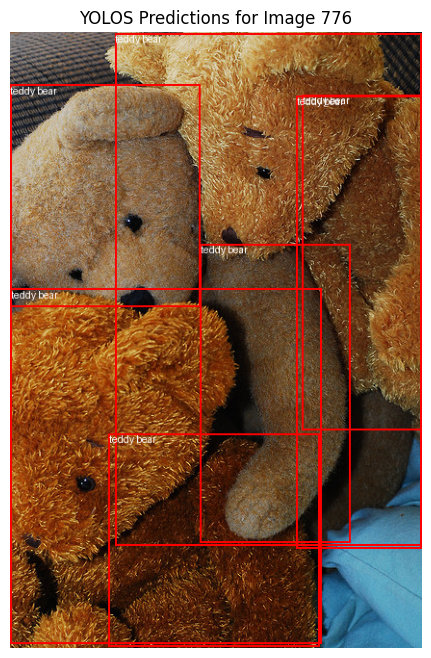

100%|██████████| 630/630 [02:33<00:00,  4.11it/s]


mAP@[0.5:0.95]: tensor(0.3857)
Detailed mAP results: {'map': tensor(0.3857), 'map_50': tensor(0.5619), 'map_75': tensor(0.4130), 'map_small': tensor(0.1230), 'map_medium': tensor(0.3416), 'map_large': tensor(0.5503), 'mar_1': tensor(0.3169), 'mar_10': tensor(0.4583), 'mar_100': tensor(0.4697), 'mar_small': tensor(0.1682), 'mar_medium': tensor(0.4305), 'mar_large': tensor(0.6277), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 5 - Validation mAP Score: 0.3857


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.385684,0.561939,0.413003,0.123037,0.341585,0.550337,0.316892,0.458329,0.469687,0.168205,0.43047,0.627691,-1.0,-1.0


Best model saved with mAP 0.3857 at epoch 5


  0%|          | 1/368 [00:05<34:21,  5.62s/it]

Epoch 6, Batch 0: Loss = 1.0330


  3%|▎         | 11/368 [00:51<26:42,  4.49s/it]

Epoch 6, Batch 10: Loss = 1.1976


  6%|▌         | 21/368 [01:32<24:11,  4.18s/it]

Epoch 6, Batch 20: Loss = 1.1471


  8%|▊         | 31/368 [02:19<25:04,  4.46s/it]

Epoch 6, Batch 30: Loss = 1.0934


 11%|█         | 41/368 [03:10<29:09,  5.35s/it]

Epoch 6, Batch 40: Loss = 0.9768


 14%|█▍        | 51/368 [04:00<26:06,  4.94s/it]

Epoch 6, Batch 50: Loss = 0.9292


 17%|█▋        | 61/368 [04:35<19:24,  3.79s/it]

Epoch 6, Batch 60: Loss = 1.0933


 19%|█▉        | 71/368 [05:15<17:06,  3.46s/it]

Epoch 6, Batch 70: Loss = 1.2971


 22%|██▏       | 81/368 [05:54<18:01,  3.77s/it]

Epoch 6, Batch 80: Loss = 1.0291


 25%|██▍       | 91/368 [06:36<20:07,  4.36s/it]

Epoch 6, Batch 90: Loss = 1.3289


 27%|██▋       | 101/368 [07:20<17:42,  3.98s/it]

Epoch 6, Batch 100: Loss = 1.2045


 30%|███       | 111/368 [08:02<17:11,  4.01s/it]

Epoch 6, Batch 110: Loss = 1.3036


 33%|███▎      | 121/368 [08:50<19:58,  4.85s/it]

Epoch 6, Batch 120: Loss = 1.0741


 36%|███▌      | 131/368 [09:37<18:18,  4.63s/it]

Epoch 6, Batch 130: Loss = 1.1487


 38%|███▊      | 141/368 [10:17<16:02,  4.24s/it]

Epoch 6, Batch 140: Loss = 1.0278


 41%|████      | 151/368 [10:55<14:33,  4.03s/it]

Epoch 6, Batch 150: Loss = 1.0670


 44%|████▍     | 161/368 [11:37<16:10,  4.69s/it]

Epoch 6, Batch 160: Loss = 1.6783


 46%|████▋     | 171/368 [12:17<14:16,  4.35s/it]

Epoch 6, Batch 170: Loss = 1.0092


 49%|████▉     | 181/368 [13:02<14:20,  4.60s/it]

Epoch 6, Batch 180: Loss = 0.9793


 52%|█████▏    | 191/368 [13:46<14:30,  4.92s/it]

Epoch 6, Batch 190: Loss = 1.1093


 55%|█████▍    | 201/368 [14:26<12:24,  4.46s/it]

Epoch 6, Batch 200: Loss = 0.9941


 57%|█████▋    | 211/368 [15:03<10:00,  3.83s/it]

Epoch 6, Batch 210: Loss = 0.9764


 60%|██████    | 221/368 [15:51<10:52,  4.44s/it]

Epoch 6, Batch 220: Loss = 0.9694


 63%|██████▎   | 231/368 [16:40<11:17,  4.94s/it]

Epoch 6, Batch 230: Loss = 1.0950


 65%|██████▌   | 241/368 [17:14<07:15,  3.43s/it]

Epoch 6, Batch 240: Loss = 0.7825


 68%|██████▊   | 251/368 [17:56<07:41,  3.94s/it]

Epoch 6, Batch 250: Loss = 0.8631


 71%|███████   | 261/368 [18:46<08:32,  4.79s/it]

Epoch 6, Batch 260: Loss = 1.1179


 74%|███████▎  | 271/368 [19:23<06:12,  3.84s/it]

Epoch 6, Batch 270: Loss = 0.9889


 76%|███████▋  | 281/368 [20:09<06:24,  4.42s/it]

Epoch 6, Batch 280: Loss = 0.9555


 79%|███████▉  | 291/368 [20:51<04:44,  3.69s/it]

Epoch 6, Batch 290: Loss = 1.0044


 82%|████████▏ | 301/368 [21:30<04:07,  3.70s/it]

Epoch 6, Batch 300: Loss = 1.1374


 85%|████████▍ | 311/368 [22:15<04:15,  4.48s/it]

Epoch 6, Batch 310: Loss = 0.9040


 87%|████████▋ | 321/368 [22:55<03:03,  3.91s/it]

Epoch 6, Batch 320: Loss = 0.8637


 90%|████████▉ | 331/368 [23:37<02:41,  4.37s/it]

Epoch 6, Batch 330: Loss = 0.9394


 93%|█████████▎| 341/368 [24:14<01:33,  3.45s/it]

Epoch 6, Batch 340: Loss = 1.1048


 95%|█████████▌| 351/368 [24:59<01:17,  4.57s/it]

Epoch 6, Batch 350: Loss = 1.0552


 98%|█████████▊| 361/368 [25:43<00:29,  4.28s/it]

Epoch 6, Batch 360: Loss = 1.2575


100%|██████████| 368/368 [26:09<00:00,  4.26s/it]


Epoch 6 Complete. Average train Loss: 4.2375, Skipped Batches: 0


Validating: 100%|██████████| 158/158 [03:10<00:00,  1.21s/it]


Epoch 6 - Validation Loss: 4.2104


  0%|          | 0/630 [00:00<?, ?it/s]

Detected teddy bear with confidence 0.942 at location [0.97, 266.58, 323.38, 635.01]
Detected teddy bear with confidence 0.507 at location [303.63, 65.23, 427.72, 413.44]
Detected teddy bear with confidence 0.876 at location [197.72, 220.2, 353.18, 530.57]
Detected teddy bear with confidence 0.645 at location [297.96, 66.32, 427.96, 536.55]
Detected teddy bear with confidence 0.968 at location [109.03, 1.41, 427.58, 533.85]
Detected teddy bear with confidence 0.985 at location [0.08, 54.61, 197.71, 285.8]
Detected teddy bear with confidence 0.535 at location [102.92, 417.31, 321.18, 638.79]


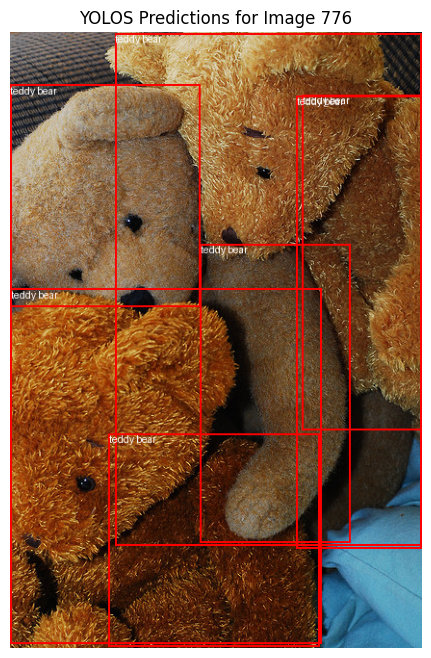

100%|██████████| 630/630 [02:32<00:00,  4.12it/s]


mAP@[0.5:0.95]: tensor(0.3857)
Detailed mAP results: {'map': tensor(0.3857), 'map_50': tensor(0.5619), 'map_75': tensor(0.4133), 'map_small': tensor(0.1232), 'map_medium': tensor(0.3413), 'map_large': tensor(0.5506), 'mar_1': tensor(0.3166), 'mar_10': tensor(0.4585), 'mar_100': tensor(0.4701), 'mar_small': tensor(0.1689), 'mar_medium': tensor(0.4317), 'mar_large': tensor(0.6277), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Epoch 6 - Validation mAP Score: 0.3857


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.385686,0.561913,0.413326,0.12317,0.341326,0.550626,0.316641,0.45851,0.470056,0.168909,0.431673,0.627653,-1.0,-1.0


Best model saved with mAP 0.3857 at epoch 6
Early stopping triggered - Training Stopped!


In [31]:
# Train Setting
epochs = 10
optimizer = torch.optim.AdamW(lokr_parameters, lr=3e-5, betas=(0.9, 0.98), eps=1e-8, weight_decay=5e-3)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=2, threshold=0.001, verbose=True)
early_stopping = EarlyStopping(patience=3)

# Train the LoKr model
best_mAP_score_LoKr, epochs_list_LoKr, train_total_losses_LoKr, val_total_losses_LoKr, train_focal_losses_LoKr, train_bbox_losses_LoKr, train_giou_losses_LoKr, mAP_scores_LoKr = train_model(
    model_with_LoKr, processor, train_dataloader, val_dataloader, optimizer, scheduler, early_stopping, device, "lokr_model.pth", epochs=epochs, is_plateau_scheduler=True
)

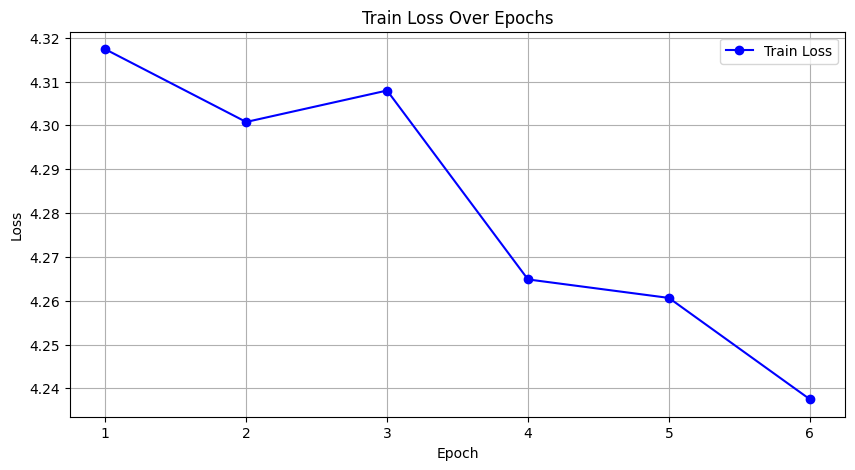

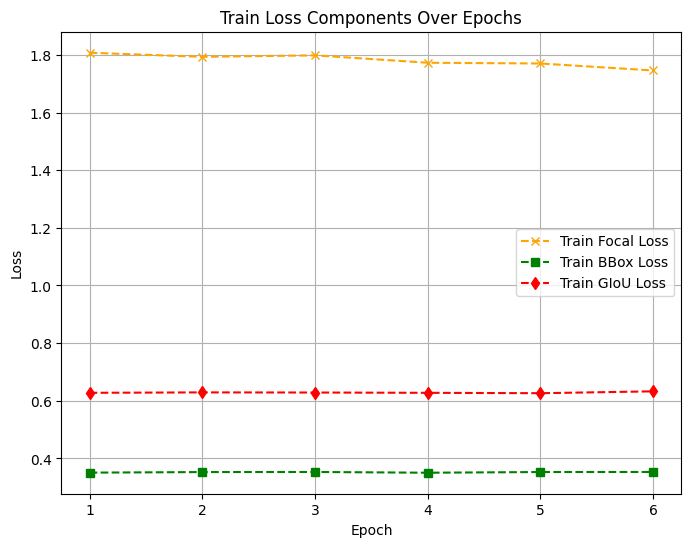

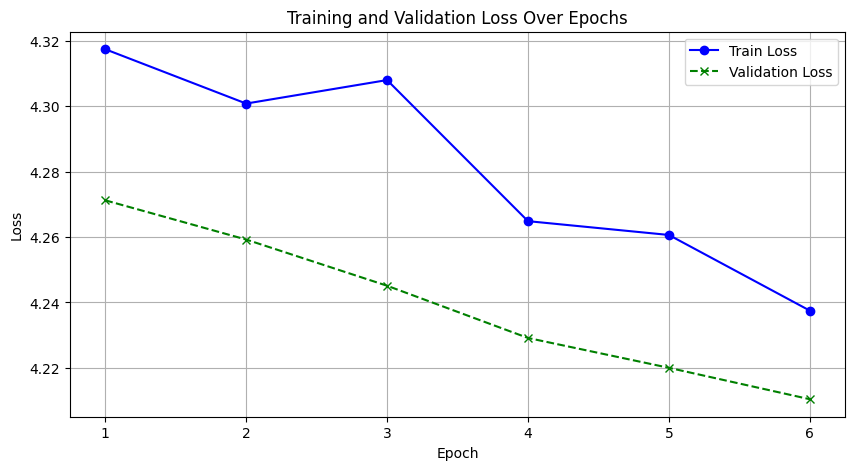

In [32]:
plot_loss_graphs(epochs_list_LoKr, train_total_losses_LoKr, train_focal_losses_LoKr, train_bbox_losses_LoKr, train_giou_losses_LoKr, val_total_losses_LoKr)


In [33]:
# Load the saved model
model_with_LoKr = torch.load("lokr_model.pth", map_location=torch.device("cuda" if torch.cuda.is_available() else "cpu"))
print(model_with_LoKr.peft_config)

# Check which weights have been updated
for name, param in model_with_LoKr.named_parameters():
    if param.requires_grad:
        print(f"{name} Trainable (Updated)")
    else:
        print(f"{name} Frozen (Original)")

print(model_with_LoKr)

{'default': LoKrConfig(task_type=None, peft_type=<PeftType.LOKR: 'LOKR'>, auto_mapping=None, base_model_name_or_path='hustvl/yolos-small', revision=None, inference_mode=False, rank_pattern={}, alpha_pattern={}, r=8, alpha=16, rank_dropout=0.3, module_dropout=0.1, use_effective_conv2d=True, decompose_both=True, decompose_factor=8, rank_dropout_scale=False, target_modules={'query', 'value'}, exclude_modules=None, init_weights=True, layers_to_transform=None, layers_pattern=None, modules_to_save=None)}
base_model.model.vit.embeddings.cls_token Frozen (Original)
base_model.model.vit.embeddings.detection_tokens Frozen (Original)
base_model.model.vit.embeddings.position_embeddings Frozen (Original)
base_model.model.vit.embeddings.patch_embeddings.projection.weight Frozen (Original)
base_model.model.vit.embeddings.patch_embeddings.projection.bias Frozen (Original)
base_model.model.vit.encoder.mid_position_embeddings Frozen (Original)
base_model.model.vit.encoder.layer.0.attention.attention.que

<ipython-input-33-eda502634a67>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_with_LoKr = torch.load("lokr_model.pth", map_location=torch.device("cuda" if torch.cud

In [34]:
# Mean value of LoKr layers after training
for name, param in model_with_LoKr.named_parameters():
    if "lokr" in name:
        print(f"{name} mean after training: {param.data.mean().item():.6f}")


base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w1.default mean after training: -0.000054
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_a.default mean after training: -0.020677
base_model.model.vit.encoder.layer.0.attention.attention.query.lokr_w2_b.default mean after training: -0.002292
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w1.default mean after training: 0.000109
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w2_a.default mean after training: -0.002589
base_model.model.vit.encoder.layer.0.attention.attention.value.lokr_w2_b.default mean after training: 0.004135
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w1.default mean after training: 0.000024
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w2_a.default mean after training: 0.004398
base_model.model.vit.encoder.layer.1.attention.attention.query.lokr_w2_b.default mean after training: -0.004626
ba

#### **Evaluate Model with LoKr**

0it [00:00, ?it/s]

Detected sports ball with confidence 1.0 at location [49.75, 193.47, 188.66, 328.18]
Detected person with confidence 0.879 at location [138.62, 22.34, 462.26, 475.69]
Detected person with confidence 0.998 at location [425.26, 29.36, 618.9, 477.06]
Detected person with confidence 0.998 at location [16.62, 21.51, 461.08, 474.91]


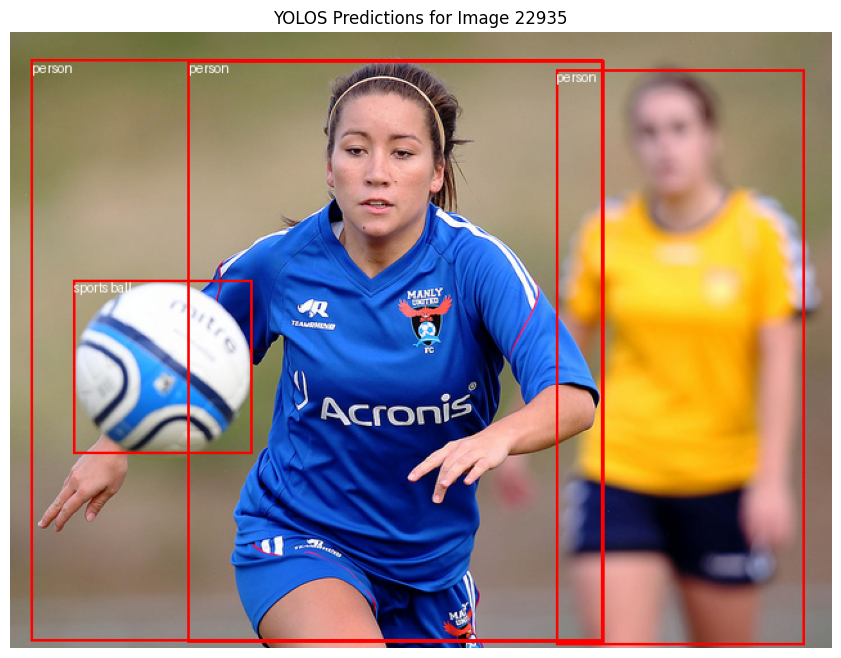

900it [03:51,  3.89it/s]


mAP@[0.5:0.95]: tensor(0.3333)
Detailed mAP results: {'map': tensor(0.3333), 'map_50': tensor(0.5143), 'map_75': tensor(0.3455), 'map_small': tensor(0.0985), 'map_medium': tensor(0.3184), 'map_large': tensor(0.5112), 'mar_1': tensor(0.2830), 'mar_10': tensor(0.4145), 'mar_100': tensor(0.4259), 'mar_small': tensor(0.1512), 'mar_medium': tensor(0.4034), 'mar_large': tensor(0.5970), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71,
        72, 73, 74, 75, 76, 77, 78, 79], dtype=torch.int32)}
Model with LoKr Performance (mAP): {'map': tensor(0.3333), 'map_50': tensor(0.5143), 'map_75': tensor(0.3455), 'map_small': tensor(0.0985), 'map_medium': tensor(

,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class
0,0.333272,0.514323,0.345513,0.098507,0.318417,0.511198,0.28298,0.414508,0.425934,0.151241,0.403429,0.597001,-1.0,-1.0


In [35]:
model_with_LoKr_results = evaluate_model(model_with_LoKr, processor, test_dataset, yolos_categories)
print("Model with LoKr Performance (mAP):", model_with_LoKr_results)

model_with_LoKr_results_dict = {
    key: value.item() if isinstance(value, torch.Tensor) else value
    for key, value in model_with_LoKr_results.items()
    if key != "classes"
}
model_with_LoKr_results_df = pd.DataFrame([model_with_LoKr_results_dict])
print("Model with LoKr Performance (mAP):")
print(model_with_LoKr_results_df)
display(model_with_LoKr_results_df)


## **6. Models Comparison**

### Compare Models Results on Test dataset  

In [58]:
# Creating a list of results with full precision values
results_data = [
    ["Baseline", 0.332379, 0.512714, 0.342762, 0.097738, 0.318657, 0.509172, 0.283184, 0.411286, 0.4224, 0.150513, 0.399143, 0.592925],
    ["LoRA", 0.333389, 0.516249, 0.343871, 0.092381, 0.319208, 0.51027, 0.285329, 0.416556, 0.429368, 0.150678, 0.409134, 0.599635],
    ["AdaLoRA", 0.333447, 0.515363, 0.344044, 0.096612, 0.319472, 0.511807, 0.284558, 0.415218, 0.427248, 0.150288, 0.405356, 0.599669],
    ["LoHa", 0.332727, 0.516466, 0.342496, 0.092201, 0.318329, 0.512017, 0.285521, 0.418458, 0.431665, 0.150939, 0.410583, 0.60458],
    ["LoKr", 0.333272, 0.514323, 0.345513, 0.098507, 0.318417, 0.511198, 0.28298, 0.414508, 0.425934, 0.151241, 0.403429, 0.597001],
]

# Creating DataFrame
columns = ["Model", "mAP", "mAP@50", "mAP@75", "mAP_small", "mAP_medium", "mAP_large",
           "mAR_1", "mAR_10", "mAR_100", "mAR_small", "mAR_medium", "mAR_large"]

df_results = pd.DataFrame(results_data, columns=columns)
print("Model Comparison Results:")
display(df_results)


Model Comparison Results:


,Model,mAP,mAP@50,mAP@75,mAP_small,mAP_medium,mAP_large,mAR_1,mAR_10,mAR_100,mAR_small,mAR_medium,mAR_large
0,Baseline,0.332379,0.512714,0.342762,0.097738,0.318657,0.509172,0.283184,0.411286,0.422400,0.150513,0.399143,0.592925
1,LoRA,0.333389,0.516249,0.343871,0.092381,0.319208,0.510270,0.285329,0.416556,0.429368,0.150678,0.409134,0.599635
2,AdaLoRA,0.333447,0.515363,0.344044,0.096612,0.319472,0.511807,0.284558,0.415218,0.427248,0.150288,0.405356,0.599669
3,LoHa,0.332727,0.516466,0.342496,0.092201,0.318329,0.512017,0.285521,0.418458,0.431665,0.150939,0.410583,0.604580
4,LoKr,0.333272,0.514323,0.345513,0.098507,0.318417,0.511198,0.282980,0.414508,0.425934,0.151241,0.403429,0.597001


### Plots for Models Comparison

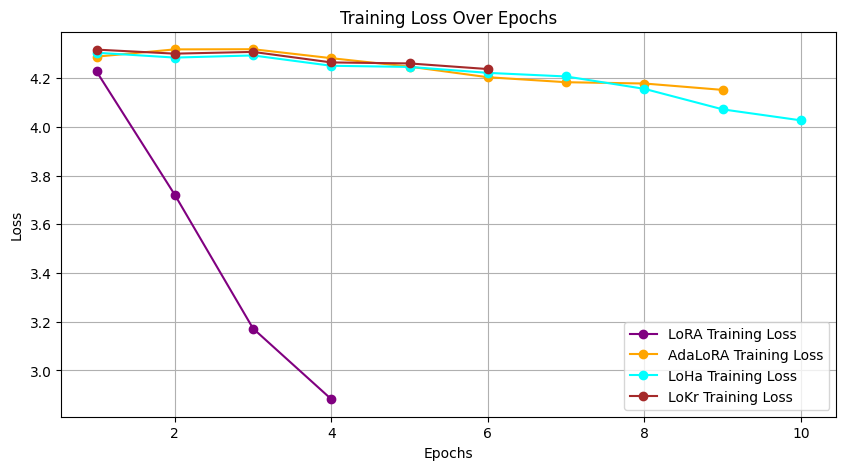

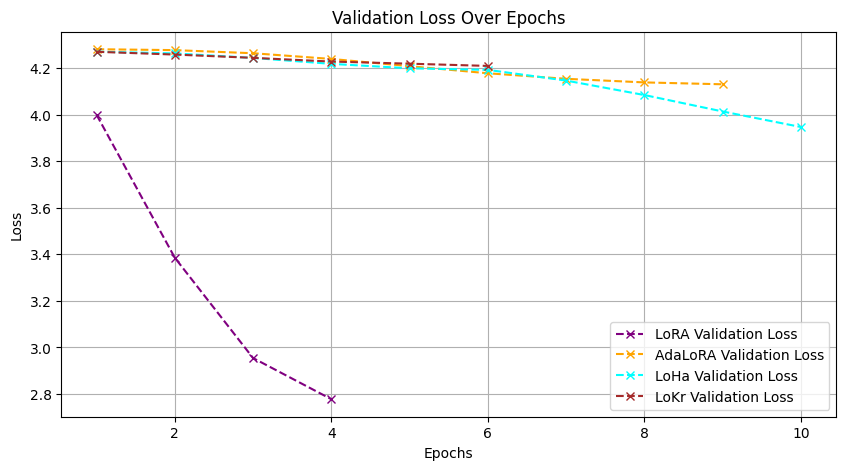

In [60]:
# Training and Validation Losses over Epochs
colors = {
    'LoRA': 'purple',
    'AdaLoRA': 'orange',
    'LoHa': 'cyan',
    'LoKr': 'brown'
}
epochs_lists = {
    'LoRA': epochs_list_LoRA,
    'AdaLoRA': epochs_list_AdaLoRA,
    'LoHa': epochs_list_LoHa,
    'LoKr': epochs_list_LoKr
}
train_losses_dict = {
    'LoRA': train_total_losses_LoRA,
    'AdaLoRA': train_total_losses_AdaLoRA,
    'LoHa': train_total_losses_LoHa,
    'LoKr': train_total_losses_LoKr
}
val_losses_dict = {
    'LoRA': val_total_losses_LoRA,
    'AdaLoRA': val_total_losses_AdaLoRA,
    'LoHa': val_total_losses_LoHa,
    'LoKr': val_total_losses_LoKr
}


# Train Losses
plt.figure(figsize=(10, 5))
for model, epochs_list in epochs_lists.items():
    train_losses = train_losses_dict.get(model, [])
    plt.plot(epochs_list, train_losses, label=f'{model} Training Loss', linestyle='-', marker='o', color=colors.get(model, 'black'))
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Validation Losses
plt.figure(figsize=(10, 5))
for model, epochs_list in epochs_lists.items():
    val_losses = val_losses_dict.get(model, [])
    plt.plot(epochs_list, val_losses, label=f'{model} Validation Loss', linestyle='--', marker='x', color=colors.get(model, 'black'))
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()


### Best Model - AdaLoRA

<ipython-input-36-cc0eebcbf7aa>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_with_AdaLoRA = torch.load("adalora_model.pth", map_location=torch.device("cuda" if tor

Detected sports ball with confidence 1.0 at location [49.86, 193.68, 188.72, 328.5]
Detected person with confidence 0.896 at location [140.0, 22.34, 462.06, 475.72]
Detected person with confidence 0.998 at location [425.44, 29.51, 618.74, 477.08]
Detected person with confidence 0.997 at location [16.7, 21.51, 461.03, 474.98]


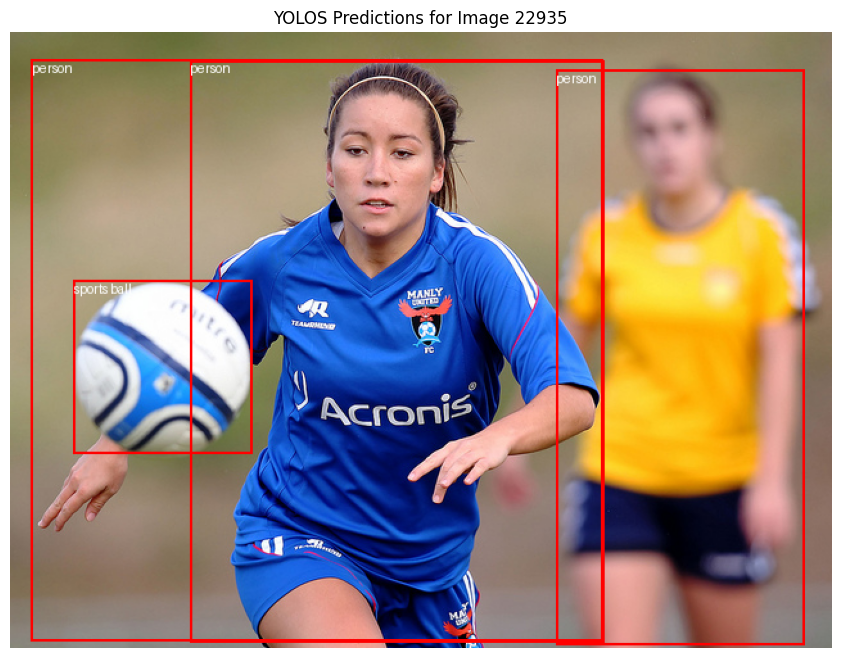

900it [03:48,  3.93it/s]


mAP@[0.5:0.95]: tensor(0.3334)
Detailed mAP results: {'map': tensor(0.3334), 'map_50': tensor(0.5154), 'map_75': tensor(0.3440), 'map_small': tensor(0.0966), 'map_medium': tensor(0.3195), 'map_large': tensor(0.5118), 'mar_1': tensor(0.2846), 'mar_10': tensor(0.4152), 'mar_100': tensor(0.4272), 'mar_small': tensor(0.1503), 'mar_medium': tensor(0.4054), 'mar_large': tensor(0.5997), 'map_per_class': tensor([0.4654, 0.2036, 0.2597, 0.3399, 0.6579, 0.6084, 0.5063, 0.2001, 0.1532,
        0.1220, 0.6348, 0.3589, 0.2783, 0.2291, 0.1774, 0.6745, 0.7479, 0.5787,
        0.4598, 0.5005, 0.6151, 0.6985, 0.5220, 0.5595, 0.0764, 0.3613, 0.1264,
        0.2628, 0.2267, 0.5705, 0.1442, 0.2185, 0.2534, 0.1647, 0.3303, 0.2667,
        0.5609, 0.3011, 0.5552, 0.2183, 0.2336, 0.1859, 0.3265, 0.0701, 0.1376,
        0.2844, 0.2586, 0.2842, 0.4100, 0.2020, 0.3912, 0.1244, 0.2162, 0.5127,
        0.2635, 0.2566, 0.1864, 0.3722, 0.2108, 0.3070, 0.2767, 0.4643, 0.4853,
        0.4865, 0.4186, 0.2104, 0.3803, 

<ipython-input-36-cc0eebcbf7aa>:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  color_map = plt.cm.get_cmap("tab20", 15)


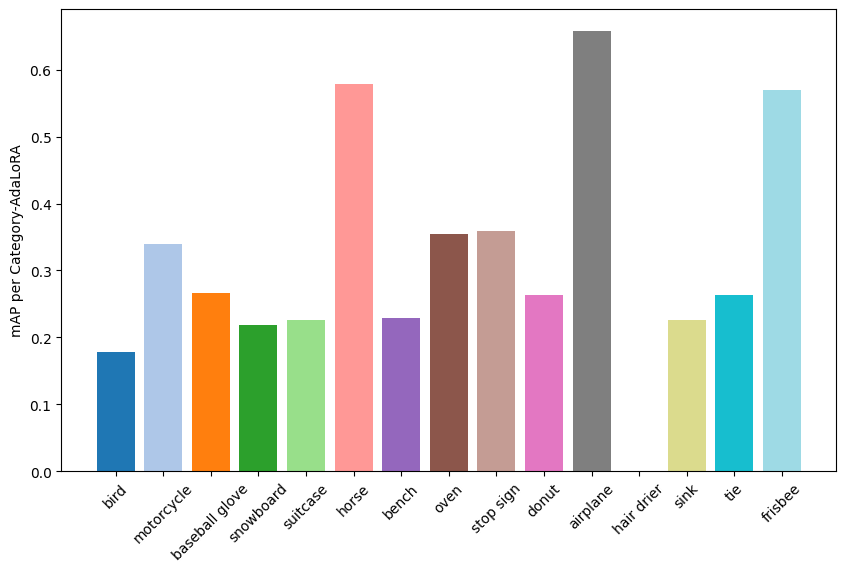

In [36]:
model_with_AdaLoRA = torch.load("adalora_model.pth", map_location=torch.device("cuda" if torch.cuda.is_available() else "cpu"))
best_model_results = evaluate_model(model_with_AdaLoRA, processor, test_dataset, yolos_categories, add_class_metrices=True)
print("Best Model is AdaLoRA with Performance (mAP) of", best_model_results["map"])

# validate map_per_class values and then plot
if best_model_results["map_per_class"].numel() == 1 and best_model_results["map_per_class"].item() == -1:
    print("Warning: No valid data for per-class mAP.")
else:
    category_map = {coco_categories[i]: best_model_results["map_per_class"][i].item() for i in range(len(coco_categories))}
    selected_categories = random.sample(list(category_map), min(15, len(category_map)))
    color_map = plt.cm.get_cmap("tab20", 15)
    colors = [color_map(i) for i in range(15)]
    plt.figure(figsize=(10, 6))
    plt.bar(selected_categories, [category_map[cat] for cat in selected_categories], color=colors)
    plt.xticks(rotation=45)
    plt.ylabel('mAP per Category')
    plt.grid(False)
    plt.show()
